In [21]:
import os
#os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
#os.environ["CUDA_VISIBLE_DEVICES"] = "1"

import pickle
from glob import glob
import math
import numpy as np
import torch
import torch.nn as nn
import pandas as pd
import time
from torch.nn.utils.rnn import pad_sequence
from torch import nn, Tensor
from tqdm import tqdm
import matplotlib.pyplot as plt

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# device = torch.device("mps")

In [13]:
print(device)

cuda


# Transformer

In [22]:
class TransformerModel(nn.Module):
    def __init__(self, input_dim, output_dim, hidden_dim, num_layers, num_heads, dropout):
        super(TransformerModel, self).__init__()
        
        self.embedding = nn.Linear(input_dim, hidden_dim)
        self.positional_encoding = PositionalEncoding(hidden_dim)
        
        self.transformer = nn.Transformer(
            d_model=hidden_dim,
            nhead=num_heads,
            num_encoder_layers=num_layers,
            num_decoder_layers=num_layers,
            dim_feedforward=hidden_dim * 4,  # Assuming 4 times expansion
            dropout=dropout
        )
        
        self.fc = nn.Linear(hidden_dim, output_dim)
    
    def forward(self, x):
        x = self.embedding(x)
        x = self.positional_encoding(x)
        
        # Reshape input to match transformer input shape
        x = x.permute(1, 0, 2)  # Shape: (seq_len, batch_size, hidden_dim)
        
        # Pass through transformer
        x = self.transformer(x, x)
        
        # Reshape output to match FC layer input shape
        x = x.permute(1, 0, 2)  # Shape: (batch_size, seq_len, hidden_dim)
        
        # Apply fully-connected layer
        x = self.fc(x)
        
        # Apply activation function
        x = torch.sigmoid(x)
        
        return x


class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=5000):
        super(PositionalEncoding, self).__init__()
        
        position = torch.arange(0, max_len).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2) * (-torch.log(torch.tensor(10000.0)) / d_model))
        pe = torch.zeros(max_len, d_model)
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0)
        
        self.register_buffer('pe', pe)
        
    def forward(self, x):
        x = x + self.pe[:, :x.size(1)]
        return x

# Dataset

In [23]:
class ArgoverseDataset(torch.utils.data.Dataset):
    """Dataset class for Argoverse"""
    
    def __init__(self, 
                 data_path,
                 sample_indices):
        super(ArgoverseDataset, self).__init__()
        
        self.data_path = data_path
        self.sample_indices = sample_indices
        self.pkl_list = glob(os.path.join(self.data_path, '*'))
        self.pkl_list.sort()
        
    def __len__(self):
        return len(self.sample_indices)

    def __getitem__(self, idx):
        # Load one scene
        pkl_path = self.pkl_list[self.sample_indices[idx]]
        with open(pkl_path, 'rb') as f:
            scene = pickle.load(f)
            
        # the index of agent to be predicted 
        pred_id = np.where(scene["track_id"] == scene['agent_id'])[0][0]
        
        # input: p_in & v_in; output: p_out
        inp_scene = np.dstack([scene['p_in'], scene['v_in']])
        out_scene = np.dstack([scene['p_out'], scene['v_out']])
        
        # Normalization 
        min_vecs = np.min(inp_scene, axis = (0,1))
        max_vecs = np.max(inp_scene, axis = (0,1))
        
        # Normalize by vectors
        inp = (inp_scene[pred_id] - min_vecs)/(max_vecs - min_vecs)
        out = (out_scene[pred_id] - min_vecs)/(max_vecs - min_vecs)
        
        inp = np.pad(inp, ((11, 0), (0, 0)))
        return torch.from_numpy(inp).float(), torch.from_numpy(out[:,:2]).float()

# Hyperparameter

In [24]:
input_dim = 4
output_dim = 2
hidden_dim = 128
num_layers = 4
num_heads = 8
dropout = 0.1

batch_size = 64
seq_len = 19

learning_rate = 0.01
decay_rate = 0.95
num_epoch = 100

# Data Loader

In [25]:
train_path = "../train/train"

# total number of scenes
indices = np.arange(0, 205942)

# train-valid split
np.random.shuffle(indices)
train_indices = indices[:180000]
valid_indices = indices[180000:]

# define datasets
train_set = ArgoverseDataset(train_path, train_indices)
valid_set = ArgoverseDataset(train_path, valid_indices)

# create dataloaders
train_loader = torch.utils.data.DataLoader(train_set, batch_size=batch_size, shuffle=True, num_workers=0)
valid_loader = torch.utils.data.DataLoader(valid_set, batch_size=batch_size, shuffle=False, num_workers=0)

# Model, Loss Function and Optimizer

In [26]:
# RNN, LSTM, 1dCNN, Transformer
model = TransformerModel(input_dim, output_dim, hidden_dim, num_layers, num_heads, dropout).to(device) # move model to gpu 

# Adaptive Moment Estimation computes adaptive learning rates for each parameter. 
# Compute the decaying averages of past and past squared gradients. 

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=1, gamma=decay_rate)  # stepwise learning rate decay
loss_fun = nn.MSELoss()

# Training

In [27]:
def train_epoch(train_loader, model, optimizer, loss_function):
    train_mse = []
    for inp, tgt in tqdm(train_loader):
        inp = inp.to(device)
        tgt = tgt.to(device)
        
        pred = model(inp)
        loss = loss_function(pred, tgt)
        train_mse.append(loss.item()) 
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    train_mse = round(np.sqrt(np.mean(train_mse)),5)
    return train_mse

def eval_epoch(valid_loader, model, loss_function):
    valid_mse = []
    preds = []
    trues = []
    with torch.no_grad():
        for inp, tgt in valid_loader:
            inp = inp.to(device)
            tgt = tgt.to(device)
            
            loss = 0
            pred = model(inp)
            loss = loss_function(pred, tgt)
            preds.append(pred.cpu().data.numpy())
            trues.append(tgt.cpu().data.numpy())
            valid_mse.append(loss.item())
            
        preds = np.concatenate(preds, axis = 0)  
        trues = np.concatenate(trues, axis = 0)  
        valid_mse = round(np.sqrt(np.mean(valid_mse)), 5)
    return valid_mse, preds, trues


In [158]:
# Learning Rate Decay
# Dropout
# L1/L2 Regulization

  5%|▌         | 152/2813 [00:20<05:52,  7.54it/s]


 11%|█         | 303/2813 [00:39<05:01,  8.32it/s]


 16%|█▌        | 454/2813 [00:59<05:14,  7.49it/s]


 22%|██▏       | 605/2813 [01:19<04:58,  7.39it/s]


 27%|██▋       | 756/2813 [01:39<04:24,  7.79it/s]


 32%|███▏      | 907/2813 [01:59<04:10,  7.62it/s]


 38%|███▊      | 1057/2813 [02:19<04:07,  7.09it/s]


 43%|████▎     | 1205/2813 [02:40<04:04,  6.57it/s]


 48%|████▊     | 1353/2813 [03:02<03:31,  6.92it/s]


 53%|█████▎    | 1501/2813 [03:25<03:06,  7.02it/s]


 59%|█████▊    | 1649/2813 [03:47<03:03,  6.34it/s]


 64%|██████▍   | 1797/2813 [04:08<02:15,  7.48it/s]


 69%|██████▉   | 1945/2813 [04:29<01:54,  7.58it/s]


 74%|███████▍  | 2093/2813 [04:50<02:02,  5.89it/s]


 80%|███████▉  | 2241/2813 [05:12<01:19,  7.17it/s]


 85%|████████▍ | 2389/2813 [05:33<00:55,  7.61it/s]


 90%|█████████ | 2537/2813 [05:55<00:38,  7.24it/s]


 95%|█████████▌| 2685/2813 [06:15<00:16,  7.56it/s]


100%|██████████| 2813/2813 [06:34<00:00,  7.13it/s]


Epoch 1 | T: 7.26 | Train RMSE: 0.04669 | Valid RMSE: 0.04580


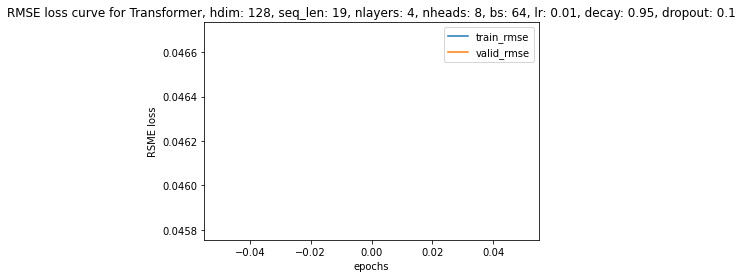

  5%|▌         | 151/2813 [00:22<06:48,  6.52it/s]


 11%|█         | 302/2813 [00:43<05:26,  7.70it/s]


 16%|█▌        | 453/2813 [01:04<05:28,  7.19it/s]


 21%|██▏       | 604/2813 [01:25<05:38,  6.53it/s]


 27%|██▋       | 755/2813 [01:47<04:33,  7.54it/s]


 32%|███▏      | 906/2813 [02:08<04:25,  7.20it/s]


 38%|███▊      | 1056/2813 [02:29<03:37,  8.09it/s]


 43%|████▎     | 1204/2813 [02:51<04:00,  6.70it/s]


 48%|████▊     | 1352/2813 [03:11<03:20,  7.28it/s]


 53%|█████▎    | 1500/2813 [03:33<03:18,  6.63it/s]


 59%|█████▊    | 1648/2813 [03:55<02:52,  6.74it/s]


 64%|██████▍   | 1796/2813 [04:17<02:23,  7.10it/s]


 69%|██████▉   | 1944/2813 [04:41<02:12,  6.58it/s]


 74%|███████▍  | 2092/2813 [05:02<01:47,  6.68it/s]


 80%|███████▉  | 2240/2813 [05:23<01:23,  6.85it/s]


 85%|████████▍ | 2388/2813 [05:44<00:56,  7.51it/s]


 90%|█████████ | 2536/2813 [06:05<00:40,  6.79it/s]


 95%|█████████▌| 2684/2813 [06:26<00:18,  7.12it/s]


100%|██████████| 2813/2813 [06:44<00:00,  6.95it/s]


Epoch 2 | T: 7.35 | Train RMSE: 0.04584 | Valid RMSE: 0.04596


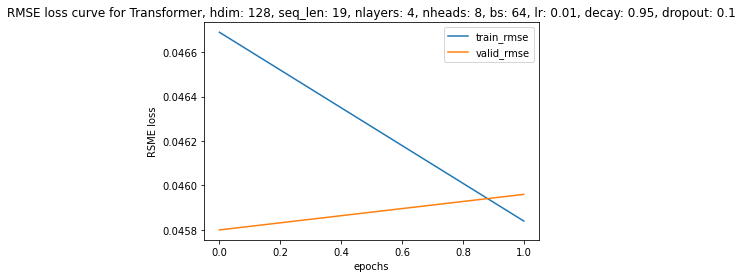

  5%|▌         | 151/2813 [00:20<05:40,  7.82it/s]


 11%|█         | 302/2813 [00:40<05:31,  7.57it/s]


 16%|█▌        | 453/2813 [01:00<05:08,  7.64it/s]


 21%|██▏       | 604/2813 [01:20<04:58,  7.40it/s]


 27%|██▋       | 755/2813 [01:41<04:56,  6.93it/s]


 32%|███▏      | 906/2813 [02:02<04:40,  6.81it/s]


 38%|███▊      | 1056/2813 [02:22<04:04,  7.18it/s]


 43%|████▎     | 1204/2813 [02:43<03:58,  6.74it/s]


 48%|████▊     | 1352/2813 [03:04<03:23,  7.20it/s]


 53%|█████▎    | 1500/2813 [03:25<03:23,  6.46it/s]


 59%|█████▊    | 1648/2813 [03:46<03:00,  6.47it/s]


 64%|██████▍   | 1796/2813 [04:07<02:28,  6.87it/s]


 69%|██████▉   | 1944/2813 [04:29<02:09,  6.69it/s]


 74%|███████▍  | 2092/2813 [04:50<01:41,  7.08it/s]


 80%|███████▉  | 2240/2813 [05:12<01:30,  6.32it/s]


 85%|████████▍ | 2388/2813 [05:34<01:01,  6.86it/s]


 90%|█████████ | 2536/2813 [05:57<00:43,  6.33it/s]


 95%|█████████▌| 2684/2813 [06:19<00:19,  6.59it/s]


100%|██████████| 2813/2813 [06:38<00:00,  7.06it/s]


Epoch 3 | T: 7.39 | Train RMSE: 0.04578 | Valid RMSE: 0.04611


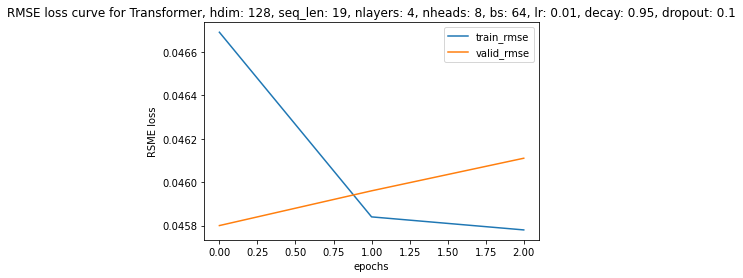

  5%|▌         | 151/2813 [00:22<06:46,  6.54it/s]


 11%|█         | 302/2813 [00:43<06:02,  6.93it/s]


 16%|█▌        | 453/2813 [01:05<05:28,  7.19it/s]


 21%|██▏       | 604/2813 [01:27<04:57,  7.42it/s]


 27%|██▋       | 755/2813 [01:49<05:08,  6.67it/s]


 32%|███▏      | 906/2813 [02:12<04:51,  6.55it/s]


 38%|███▊      | 1056/2813 [02:33<04:09,  7.04it/s]


 43%|████▎     | 1204/2813 [02:54<03:42,  7.23it/s]


 48%|████▊     | 1352/2813 [03:14<03:18,  7.36it/s]


 53%|█████▎    | 1500/2813 [03:35<02:55,  7.48it/s]


 59%|█████▊    | 1648/2813 [03:56<02:36,  7.46it/s]


 64%|██████▍   | 1796/2813 [04:17<02:30,  6.76it/s]


 69%|██████▉   | 1944/2813 [04:38<02:09,  6.73it/s]


 74%|███████▍  | 2092/2813 [05:00<01:47,  6.69it/s]


 80%|███████▉  | 2240/2813 [05:26<01:44,  5.47it/s]


 85%|████████▍ | 2388/2813 [05:51<01:12,  5.86it/s]


 90%|█████████ | 2536/2813 [06:14<00:43,  6.33it/s]


 95%|█████████▌| 2684/2813 [06:38<00:20,  6.31it/s]


100%|██████████| 2813/2813 [06:58<00:00,  6.71it/s]


Epoch 4 | T: 7.58 | Train RMSE: 0.04577 | Valid RMSE: 0.04580


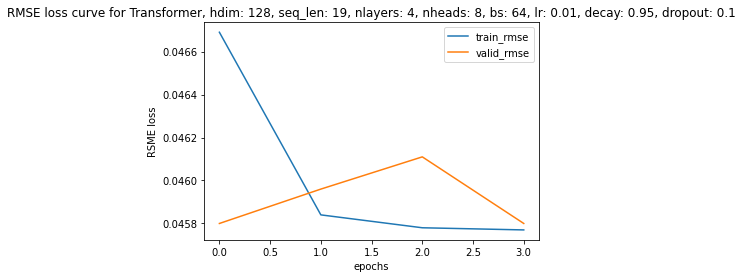

  5%|▌         | 151/2813 [00:22<06:15,  7.08it/s]


 11%|█         | 302/2813 [00:44<06:33,  6.38it/s]


 16%|█▌        | 453/2813 [01:06<06:04,  6.48it/s]


 21%|██▏       | 604/2813 [01:30<05:35,  6.58it/s]


 27%|██▋       | 755/2813 [01:52<05:01,  6.82it/s]


 32%|███▏      | 906/2813 [02:16<03:55,  8.08it/s]


 38%|███▊      | 1056/2813 [02:40<04:32,  6.45it/s]


 43%|████▎     | 1204/2813 [03:02<04:26,  6.04it/s]


 48%|████▊     | 1352/2813 [03:25<03:47,  6.41it/s]


 53%|█████▎    | 1500/2813 [03:48<03:37,  6.04it/s]


 59%|█████▊    | 1648/2813 [04:11<02:43,  7.12it/s]


 64%|██████▍   | 1796/2813 [04:34<02:41,  6.29it/s]


 69%|██████▉   | 1944/2813 [04:57<02:20,  6.18it/s]


 74%|███████▍  | 2092/2813 [05:20<01:47,  6.68it/s]


 80%|███████▉  | 2240/2813 [05:43<01:26,  6.62it/s]


 85%|████████▍ | 2388/2813 [06:07<01:11,  5.98it/s]


 90%|█████████ | 2536/2813 [06:31<00:46,  6.00it/s]


 95%|█████████▌| 2684/2813 [06:55<00:18,  7.02it/s]


100%|██████████| 2813/2813 [07:14<00:00,  6.47it/s]


Epoch 5 | T: 7.98 | Train RMSE: 0.04575 | Valid RMSE: 0.04582


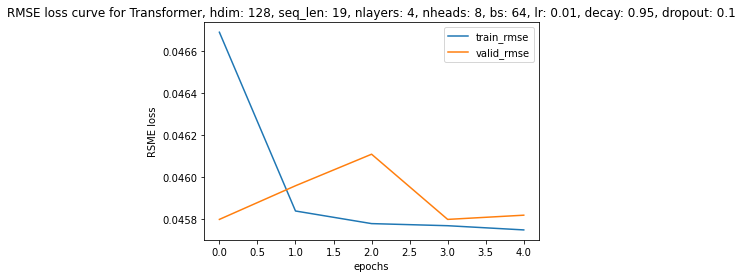

  5%|▌         | 151/2813 [00:20<05:40,  7.82it/s]


 11%|█         | 302/2813 [00:42<05:54,  7.09it/s]


 16%|█▌        | 453/2813 [01:02<05:29,  7.17it/s]


 21%|██▏       | 604/2813 [01:24<04:45,  7.73it/s]


 27%|██▋       | 755/2813 [01:44<04:29,  7.63it/s]


 32%|███▏      | 906/2813 [02:06<04:25,  7.17it/s]


 38%|███▊      | 1056/2813 [02:30<04:22,  6.70it/s]


 43%|████▎     | 1204/2813 [02:50<03:22,  7.95it/s]


 48%|████▊     | 1352/2813 [03:09<02:56,  8.28it/s]


 53%|█████▎    | 1500/2813 [03:40<02:31,  8.66it/s]


 59%|█████▊    | 1650/2813 [03:57<02:28,  7.86it/s]


 64%|██████▍   | 1801/2813 [04:15<01:57,  8.60it/s]


 69%|██████▉   | 1953/2813 [04:42<01:48,  7.91it/s]


 75%|███████▍  | 2102/2813 [05:00<01:20,  8.88it/s]


 80%|███████▉  | 2250/2813 [05:18<01:04,  8.67it/s]


 85%|████████▌ | 2399/2813 [05:44<00:57,  7.25it/s]


 91%|█████████ | 2547/2813 [06:05<00:36,  7.26it/s]


 96%|█████████▌| 2695/2813 [06:33<00:28,  4.17it/s]


100%|██████████| 2813/2813 [06:49<00:00,  6.86it/s]


Epoch 6 | T: 7.74 | Train RMSE: 0.04575 | Valid RMSE: 0.04582


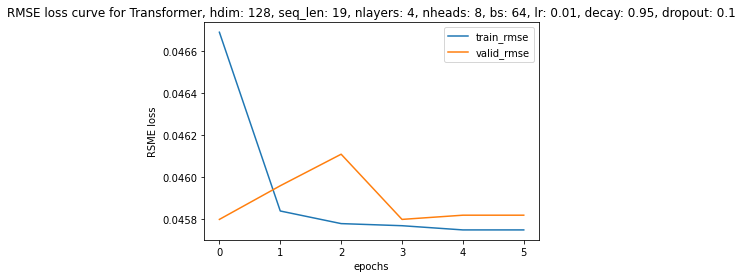

  5%|▌         | 153/2813 [00:20<05:29,  8.07it/s]


 11%|█         | 305/2813 [00:53<18:43,  2.23it/s]


 16%|█▌        | 456/2813 [01:13<05:28,  7.17it/s]


 22%|██▏       | 607/2813 [01:32<04:13,  8.72it/s]


 27%|██▋       | 758/2813 [01:58<04:47,  7.14it/s]


 32%|███▏      | 909/2813 [02:17<04:06,  7.73it/s]


 38%|███▊      | 1059/2813 [02:37<04:09,  7.02it/s]


 43%|████▎     | 1212/2813 [03:04<03:37,  7.36it/s]


 48%|████▊     | 1364/2813 [03:22<02:39,  9.08it/s]


 54%|█████▍    | 1514/2813 [03:50<18:12,  1.19it/s]


 59%|█████▉    | 1662/2813 [04:09<02:27,  7.83it/s]


 64%|██████▍   | 1811/2813 [04:27<01:55,  8.68it/s]


 70%|██████▉   | 1959/2813 [05:01<02:00,  7.08it/s]


 75%|███████▌  | 2110/2813 [05:22<01:27,  8.06it/s]


 80%|████████  | 2258/2813 [05:53<01:16,  7.25it/s]


 86%|████████▌ | 2406/2813 [06:14<00:52,  7.72it/s]


 91%|█████████ | 2554/2813 [06:33<00:33,  7.81it/s]


 96%|█████████▌| 2702/2813 [06:58<00:14,  7.76it/s]


100%|██████████| 2813/2813 [07:12<00:00,  6.50it/s]


Epoch 7 | T: 7.97 | Train RMSE: 0.04575 | Valid RMSE: 0.04580


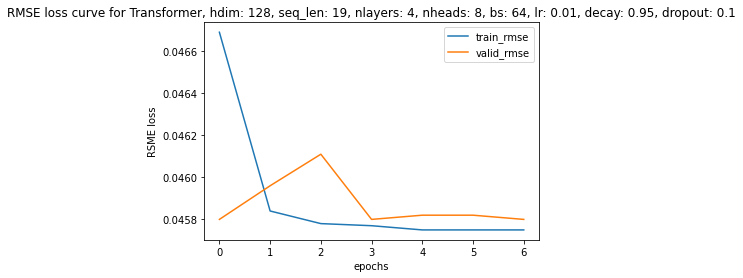

  5%|▌         | 151/2813 [00:19<06:04,  7.30it/s]


 11%|█         | 305/2813 [00:39<05:17,  7.89it/s]


 16%|█▋        | 458/2813 [01:13<05:28,  7.17it/s]


 22%|██▏       | 610/2813 [01:32<04:22,  8.40it/s]


 27%|██▋       | 763/2813 [02:05<04:46,  7.16it/s]


 33%|███▎      | 915/2813 [02:26<04:39,  6.79it/s]


 38%|███▊      | 1065/2813 [02:54<03:37,  8.05it/s]


 43%|████▎     | 1214/2813 [03:13<03:27,  7.72it/s]


 48%|████▊     | 1362/2813 [03:31<02:59,  8.09it/s]


 54%|█████▎    | 1510/2813 [03:57<02:58,  7.29it/s]


 59%|█████▉    | 1658/2813 [04:17<02:32,  7.55it/s]


 64%|██████▍   | 1806/2813 [04:36<02:12,  7.58it/s]


 69%|██████▉   | 1954/2813 [05:05<01:46,  8.08it/s]


 75%|███████▍  | 2102/2813 [05:23<01:24,  8.41it/s]


 80%|████████  | 2253/2813 [05:42<01:03,  8.77it/s]


 85%|████████▌ | 2402/2813 [06:11<00:53,  7.64it/s]


 91%|█████████ | 2551/2813 [06:29<00:31,  8.29it/s]


 96%|█████████▌| 2702/2813 [07:02<00:13,  7.99it/s]


100%|██████████| 2813/2813 [07:16<00:00,  6.45it/s]


Epoch 8 | T: 8.03 | Train RMSE: 0.04575 | Valid RMSE: 0.04584


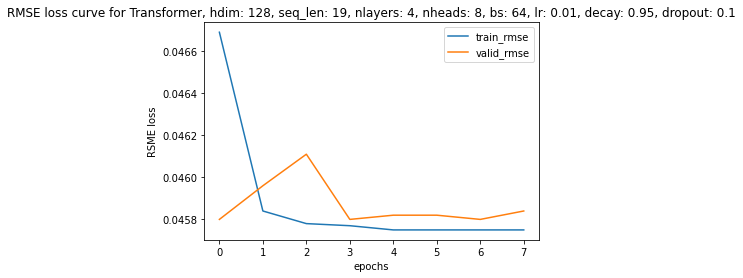

  5%|▌         | 151/2813 [00:18<05:15,  8.43it/s]


 11%|█         | 302/2813 [00:37<04:50,  8.63it/s]


 16%|█▌        | 453/2813 [01:07<05:36,  7.01it/s]


 21%|██▏       | 604/2813 [01:27<05:00,  7.35it/s]


 27%|██▋       | 757/2813 [01:55<04:39,  7.36it/s]


 32%|███▏      | 909/2813 [02:14<03:51,  8.22it/s]


 38%|███▊      | 1060/2813 [02:32<03:25,  8.52it/s]


 43%|████▎     | 1210/2813 [03:00<03:18,  8.07it/s]


 48%|████▊     | 1358/2813 [03:19<03:15,  7.43it/s]


 54%|█████▎    | 1508/2813 [03:37<02:46,  7.83it/s]


 59%|█████▉    | 1656/2813 [04:12<02:25,  7.93it/s]


 64%|██████▍   | 1804/2813 [04:32<02:31,  6.65it/s]


 69%|██████▉   | 1952/2813 [05:00<02:03,  6.99it/s]


 75%|███████▍  | 2100/2813 [05:22<01:46,  6.69it/s]


 80%|████████  | 2253/2813 [05:48<03:54,  2.38it/s]


 85%|████████▌ | 2401/2813 [06:10<01:02,  6.60it/s]


 91%|█████████ | 2549/2813 [06:31<00:33,  7.88it/s]


 96%|█████████▌| 2697/2813 [06:59<00:17,  6.76it/s]


100%|██████████| 2813/2813 [07:14<00:00,  6.47it/s]


Epoch 9 | T: 8.02 | Train RMSE: 0.04574 | Valid RMSE: 0.04583


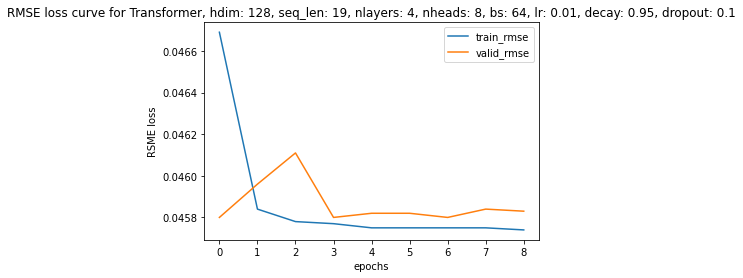

  5%|▌         | 151/2813 [00:20<05:55,  7.48it/s]


 11%|█         | 304/2813 [00:40<06:20,  6.60it/s]


 16%|█▌        | 455/2813 [01:17<04:49,  8.14it/s]


 22%|██▏       | 610/2813 [01:37<05:10,  7.09it/s]


 27%|██▋       | 761/2813 [02:04<03:43,  9.19it/s]


 32%|███▏      | 914/2813 [02:24<04:00,  7.91it/s]


 38%|███▊      | 1065/2813 [02:50<03:34,  8.16it/s]


 43%|████▎     | 1213/2813 [03:08<03:34,  7.45it/s]


 48%|████▊     | 1361/2813 [03:27<02:39,  9.09it/s]


 54%|█████▍    | 1513/2813 [03:55<02:46,  7.82it/s]


 59%|█████▉    | 1661/2813 [04:13<02:12,  8.70it/s]


 64%|██████▍   | 1811/2813 [04:32<01:59,  8.40it/s]


 70%|██████▉   | 1960/2813 [05:04<01:52,  7.56it/s]


 75%|███████▌  | 2112/2813 [05:22<01:31,  7.64it/s]


 80%|████████  | 2260/2813 [05:41<01:04,  8.53it/s]


 86%|████████▌ | 2409/2813 [06:12<00:46,  8.77it/s]


 91%|█████████ | 2557/2813 [06:30<00:30,  8.47it/s]


 96%|█████████▌| 2705/2813 [06:56<00:12,  8.70it/s]


100%|██████████| 2813/2813 [07:09<00:00,  6.54it/s]


Epoch 10 | T: 7.88 | Train RMSE: 0.04574 | Valid RMSE: 0.04602


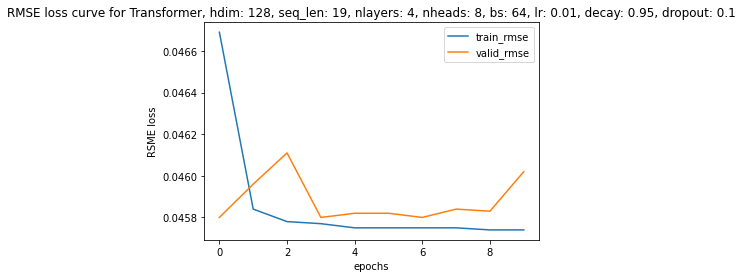

  5%|▌         | 151/2813 [00:18<05:07,  8.65it/s]


 11%|█         | 307/2813 [00:36<04:47,  8.72it/s]


 16%|█▋        | 462/2813 [01:10<04:46,  8.22it/s]


 22%|██▏       | 613/2813 [01:29<04:36,  7.95it/s]


 27%|██▋       | 766/2813 [01:47<04:00,  8.52it/s]


 33%|███▎      | 918/2813 [02:25<03:58,  7.94it/s]


 38%|███▊      | 1070/2813 [02:44<03:12,  9.06it/s]


 43%|████▎     | 1219/2813 [03:11<03:18,  8.04it/s]


 49%|████▉     | 1372/2813 [03:30<03:03,  7.85it/s]


 54%|█████▍    | 1522/2813 [03:48<02:42,  7.95it/s]


 60%|█████▉    | 1683/2813 [04:14<02:05,  9.03it/s]


 65%|██████▌   | 1831/2813 [04:33<02:07,  7.71it/s]


 70%|███████   | 1982/2813 [05:02<12:49,  1.08it/s]


 76%|███████▌  | 2131/2813 [05:21<01:24,  8.09it/s]


 81%|████████  | 2284/2813 [05:39<00:56,  9.42it/s]


 87%|████████▋ | 2435/2813 [06:08<00:51,  7.34it/s]


 92%|█████████▏| 2583/2813 [06:28<00:31,  7.27it/s]


 97%|█████████▋| 2731/2813 [06:46<00:10,  7.95it/s]


100%|██████████| 2813/2813 [07:13<00:00,  6.50it/s]


Epoch 11 | T: 7.77 | Train RMSE: 0.04574 | Valid RMSE: 0.04580


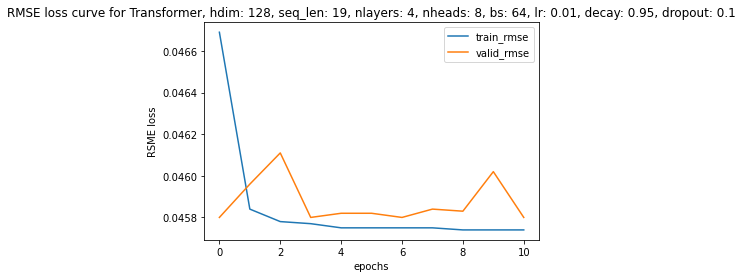

  5%|▌         | 152/2813 [00:30<05:33,  7.98it/s]


 11%|█         | 303/2813 [00:48<05:12,  8.02it/s]


 16%|█▌        | 456/2813 [01:19<05:22,  7.30it/s]


 22%|██▏       | 607/2813 [01:38<04:57,  7.41it/s]


 27%|██▋       | 759/2813 [01:57<04:14,  8.06it/s]


 32%|███▏      | 911/2813 [02:25<03:56,  8.04it/s]


 38%|███▊      | 1061/2813 [02:43<03:40,  7.95it/s]


 43%|████▎     | 1209/2813 [03:00<02:52,  9.32it/s]


 48%|████▊     | 1358/2813 [03:32<03:24,  7.11it/s]


 54%|█████▎    | 1507/2813 [03:51<02:40,  8.12it/s]


 59%|█████▉    | 1655/2813 [04:23<02:33,  7.55it/s]


 64%|██████▍   | 1803/2813 [04:42<02:13,  7.55it/s]


 69%|██████▉   | 1952/2813 [05:01<01:50,  7.81it/s]


 75%|███████▍  | 2100/2813 [05:27<01:31,  7.83it/s]


 80%|███████▉  | 2248/2813 [05:46<01:09,  8.12it/s]


 85%|████████▌ | 2396/2813 [06:14<02:48,  2.48it/s]


 91%|█████████ | 2547/2813 [06:33<00:32,  8.30it/s]


 96%|█████████▌| 2695/2813 [06:52<00:15,  7.70it/s]


100%|██████████| 2813/2813 [07:17<00:00,  6.43it/s]


Epoch 12 | T: 7.88 | Train RMSE: 0.04573 | Valid RMSE: 0.04582


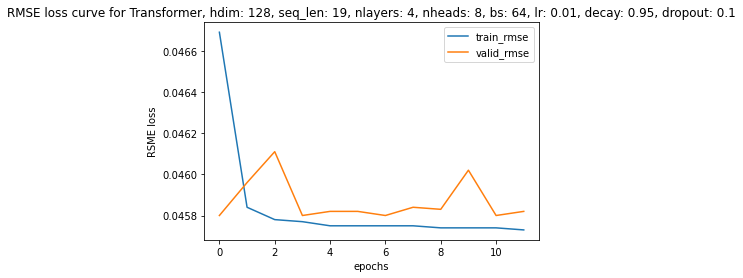

  5%|▌         | 151/2813 [00:36<06:13,  7.14it/s]


 11%|█         | 303/2813 [00:55<05:07,  8.15it/s]


 16%|█▌        | 454/2813 [01:30<06:35,  5.96it/s]


 22%|██▏       | 605/2813 [01:51<05:04,  7.24it/s]


 27%|██▋       | 757/2813 [02:10<04:06,  8.34it/s]


 32%|███▏      | 908/2813 [02:36<04:21,  7.27it/s]


 38%|███▊      | 1058/2813 [02:55<03:50,  7.61it/s]


 43%|████▎     | 1206/2813 [03:21<05:40,  4.72it/s]


 48%|████▊     | 1355/2813 [03:41<02:54,  8.37it/s]


 54%|█████▍    | 1518/2813 [04:00<02:38,  8.19it/s]


 59%|█████▉    | 1666/2813 [04:31<02:30,  7.60it/s]


 65%|██████▍   | 1816/2813 [04:49<02:10,  7.64it/s]


 70%|███████   | 1974/2813 [05:08<01:48,  7.75it/s]


 75%|███████▌  | 2122/2813 [05:46<01:32,  7.43it/s]


 81%|████████  | 2270/2813 [06:05<01:07,  7.99it/s]


 86%|████████▌ | 2418/2813 [06:32<00:46,  8.56it/s]


 91%|█████████ | 2566/2813 [06:51<00:29,  8.27it/s]


 96%|█████████▋| 2714/2813 [07:10<00:13,  7.61it/s]


100%|██████████| 2813/2813 [07:29<00:00,  6.26it/s]


Epoch 13 | T: 8.05 | Train RMSE: 0.04573 | Valid RMSE: 0.04594


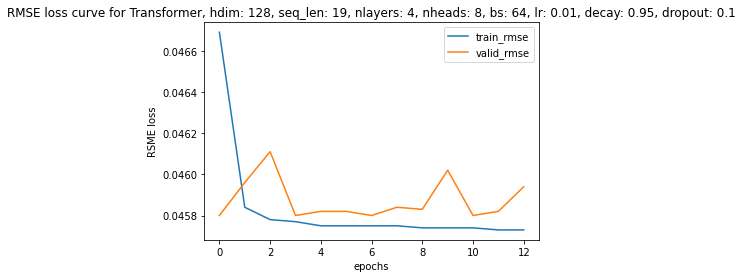

  5%|▌         | 151/2813 [00:30<06:06,  7.26it/s]


 11%|█         | 308/2813 [00:48<05:05,  8.20it/s]


 16%|█▋        | 460/2813 [01:07<04:47,  8.19it/s]


 22%|██▏       | 611/2813 [01:47<04:18,  8.53it/s]


 27%|██▋       | 763/2813 [02:05<04:01,  8.49it/s]


 32%|███▏      | 914/2813 [02:36<04:16,  7.42it/s]


 38%|███▊      | 1064/2813 [02:54<03:23,  8.60it/s]


 43%|████▎     | 1214/2813 [03:18<03:27,  7.69it/s]


 48%|████▊     | 1363/2813 [03:37<02:56,  8.20it/s]


 54%|█████▍    | 1516/2813 [03:56<02:38,  8.20it/s]


 59%|█████▉    | 1664/2813 [04:24<02:33,  7.49it/s]


 64%|██████▍   | 1812/2813 [04:42<01:55,  8.66it/s]


 70%|██████▉   | 1963/2813 [05:00<01:46,  7.98it/s]


 75%|███████▌  | 2112/2813 [05:29<01:24,  8.33it/s]


 80%|████████  | 2261/2813 [05:48<01:01,  8.98it/s]


 86%|████████▌ | 2414/2813 [06:05<00:44,  8.96it/s]


 91%|█████████ | 2563/2813 [06:41<00:31,  7.84it/s]


 96%|█████████▋| 2713/2813 [07:00<00:13,  7.58it/s]


100%|██████████| 2813/2813 [07:22<00:00,  6.36it/s]


Epoch 14 | T: 7.94 | Train RMSE: 0.04573 | Valid RMSE: 0.04580


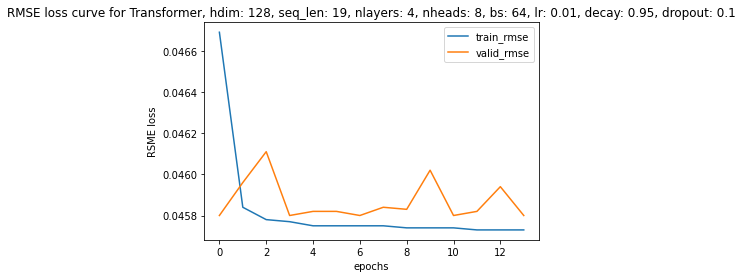

  6%|▌         | 156/2813 [00:26<05:35,  7.91it/s]


 11%|█         | 307/2813 [00:44<05:22,  7.78it/s]


 16%|█▋        | 464/2813 [01:03<05:02,  7.77it/s]


 22%|██▏       | 621/2813 [01:37<04:44,  7.70it/s]


 28%|██▊       | 776/2813 [01:56<04:11,  8.08it/s]


 33%|███▎      | 927/2813 [02:15<04:18,  7.29it/s]


 38%|███▊      | 1077/2813 [02:44<03:37,  8.00it/s]


 44%|████▎     | 1226/2813 [03:02<03:09,  8.39it/s]


 49%|████▉     | 1376/2813 [03:34<02:57,  8.09it/s]


 54%|█████▍    | 1526/2813 [03:54<02:51,  7.49it/s]


 60%|█████▉    | 1674/2813 [04:12<02:05,  9.07it/s]


 65%|██████▍   | 1823/2813 [04:43<02:06,  7.82it/s]


 70%|███████   | 1971/2813 [05:03<01:52,  7.48it/s]


 76%|███████▌  | 2125/2813 [05:30<01:36,  7.12it/s]


 81%|████████  | 2275/2813 [05:49<00:58,  9.20it/s]


 86%|████████▌ | 2423/2813 [06:07<00:45,  8.49it/s]


 92%|█████████▏| 2574/2813 [06:35<00:30,  7.95it/s]


 97%|█████████▋| 2725/2813 [06:53<00:09,  9.58it/s]


100%|██████████| 2813/2813 [07:04<00:00,  6.62it/s]


Epoch 15 | T: 7.94 | Train RMSE: 0.04572 | Valid RMSE: 0.04580


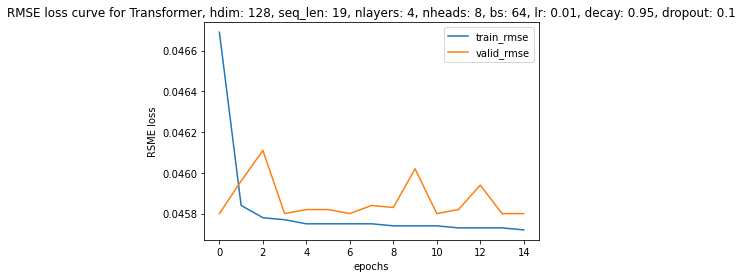

  5%|▌         | 152/2813 [00:19<05:38,  7.87it/s]


 11%|█         | 303/2813 [00:53<05:05,  8.23it/s]


 16%|█▌        | 457/2813 [01:11<04:30,  8.71it/s]


 22%|██▏       | 608/2813 [01:40<04:35,  7.99it/s]


 27%|██▋       | 759/2813 [01:58<04:16,  8.02it/s]


 32%|███▏      | 910/2813 [02:16<03:31,  8.99it/s]


 38%|███▊      | 1061/2813 [02:44<03:30,  8.33it/s]


 43%|████▎     | 1213/2813 [03:04<03:30,  7.59it/s]


 49%|████▊     | 1367/2813 [03:34<02:54,  8.27it/s]


 54%|█████▍    | 1522/2813 [03:53<02:41,  8.01it/s]


 60%|█████▉    | 1676/2813 [04:13<02:31,  7.51it/s]


 65%|██████▌   | 1831/2813 [04:48<01:58,  8.31it/s]


 70%|███████   | 1983/2813 [05:07<01:32,  8.99it/s]


 76%|███████▌  | 2132/2813 [05:35<01:26,  7.90it/s]


 82%|████████▏ | 2295/2813 [05:55<01:00,  8.58it/s]


 87%|████████▋ | 2444/2813 [06:13<00:43,  8.57it/s]


 92%|█████████▏| 2593/2813 [06:40<00:30,  7.20it/s]


 97%|█████████▋| 2741/2813 [06:59<00:09,  7.44it/s]


100%|██████████| 2813/2813 [07:08<00:00,  6.57it/s]


Epoch 16 | T: 7.88 | Train RMSE: 0.04572 | Valid RMSE: 0.04581


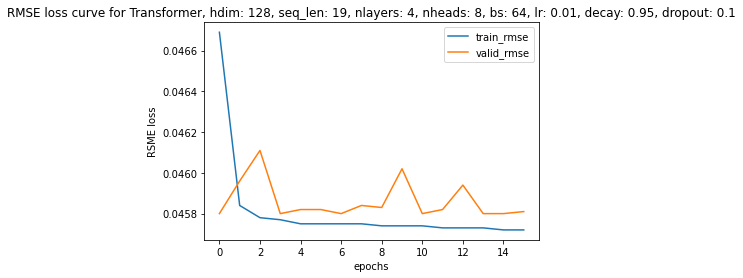

  5%|▌         | 154/2813 [00:19<05:07,  8.64it/s]


 11%|█         | 306/2813 [00:55<05:08,  8.14it/s]


 16%|█▋        | 460/2813 [01:14<04:38,  8.45it/s]


 22%|██▏       | 611/2813 [01:48<04:29,  8.18it/s]


 27%|██▋       | 762/2813 [02:07<04:07,  8.30it/s]


 32%|███▏      | 913/2813 [02:26<04:02,  7.85it/s]


 38%|███▊      | 1065/2813 [02:51<03:25,  8.50it/s]


 43%|████▎     | 1213/2813 [03:10<03:37,  7.35it/s]


 48%|████▊     | 1364/2813 [03:35<21:11,  1.14it/s]


 54%|█████▍    | 1514/2813 [03:53<02:41,  8.03it/s]


 59%|█████▉    | 1663/2813 [04:11<02:18,  8.31it/s]


 64%|██████▍   | 1813/2813 [04:40<06:40,  2.50it/s]


 70%|██████▉   | 1961/2813 [04:59<01:50,  7.70it/s]


 75%|███████▍  | 2109/2813 [05:17<01:25,  8.24it/s]


 80%|████████  | 2258/2813 [05:53<01:20,  6.91it/s]


 86%|████████▌ | 2407/2813 [06:13<00:58,  6.93it/s]


 91%|█████████ | 2556/2813 [06:41<00:35,  7.29it/s]


 96%|█████████▌| 2705/2813 [07:00<00:14,  7.39it/s]


100%|██████████| 2813/2813 [07:14<00:00,  6.48it/s]


Epoch 17 | T: 7.92 | Train RMSE: 0.04572 | Valid RMSE: 0.04578


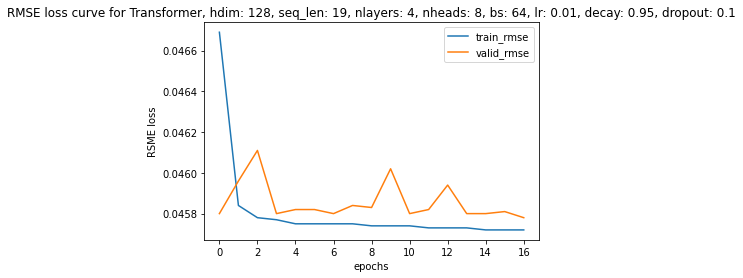

  6%|▌         | 162/2813 [00:18<04:14, 10.42it/s]


 12%|█▏        | 346/2813 [00:55<05:23,  7.63it/s]


 18%|█▊        | 497/2813 [01:14<04:47,  8.06it/s]


 23%|██▎       | 650/2813 [01:33<04:41,  7.69it/s]


 29%|██▊       | 802/2813 [02:07<04:11,  8.01it/s]


 34%|███▍      | 953/2813 [02:26<03:32,  8.77it/s]


 39%|███▉      | 1102/2813 [02:57<03:29,  8.15it/s]


 44%|████▍     | 1250/2813 [03:16<03:09,  8.24it/s]


 50%|████▉     | 1400/2813 [03:43<34:13,  1.45s/it]


 55%|█████▌    | 1548/2813 [04:01<02:23,  8.80it/s]


 60%|██████    | 1698/2813 [04:19<02:00,  9.29it/s]


 66%|██████▌   | 1848/2813 [04:46<01:56,  8.27it/s]


 71%|███████   | 1996/2813 [05:03<01:29,  9.14it/s]


 76%|███████▋  | 2146/2813 [05:20<01:08,  9.74it/s]


 82%|████████▏ | 2299/2813 [05:50<01:04,  7.94it/s]


 87%|████████▋ | 2448/2813 [06:08<00:45,  7.95it/s]


 92%|█████████▏| 2597/2813 [06:26<00:26,  8.13it/s]


 98%|█████████▊| 2747/2813 [07:03<00:07,  9.13it/s]


100%|██████████| 2813/2813 [07:11<00:00,  6.52it/s]


Epoch 18 | T: 7.93 | Train RMSE: 0.04572 | Valid RMSE: 0.04581


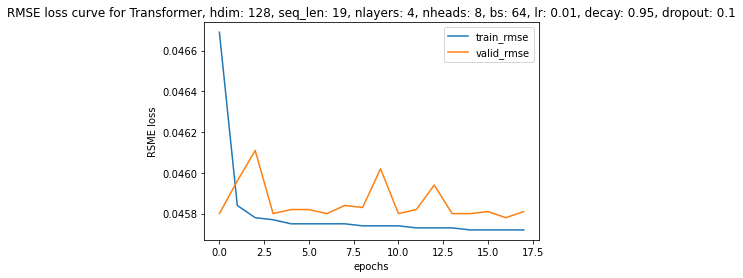

  5%|▌         | 153/2813 [00:18<05:01,  8.82it/s]


 11%|█         | 311/2813 [00:36<05:15,  7.92it/s]


 16%|█▋        | 462/2813 [01:06<05:44,  6.82it/s]


 22%|██▏       | 613/2813 [01:26<05:15,  6.98it/s]


 27%|██▋       | 767/2813 [01:57<05:12,  6.54it/s]


 33%|███▎      | 919/2813 [02:17<03:42,  8.52it/s]


 38%|███▊      | 1069/2813 [02:36<03:23,  8.58it/s]


 43%|████▎     | 1218/2813 [03:03<02:56,  9.05it/s]


 49%|████▊     | 1367/2813 [03:21<02:53,  8.33it/s]


 54%|█████▍    | 1524/2813 [03:57<1:59:52,  5.58s/it]


 60%|█████▉    | 1677/2813 [04:15<02:13,  8.53it/s]


 65%|██████▍   | 1827/2813 [04:33<02:05,  7.85it/s]


 70%|███████   | 1975/2813 [05:02<01:33,  8.92it/s]


 76%|███████▌  | 2127/2813 [05:21<01:22,  8.32it/s]


 81%|████████  | 2276/2813 [05:46<20:27,  2.29s/it]


 86%|████████▋ | 2427/2813 [06:04<00:48,  7.90it/s]


 92%|█████████▏| 2575/2813 [06:22<00:27,  8.53it/s]


 97%|█████████▋| 2723/2813 [06:50<00:44,  2.03it/s]


100%|██████████| 2813/2813 [07:01<00:00,  6.67it/s]


Epoch 19 | T: 7.58 | Train RMSE: 0.04571 | Valid RMSE: 0.04580


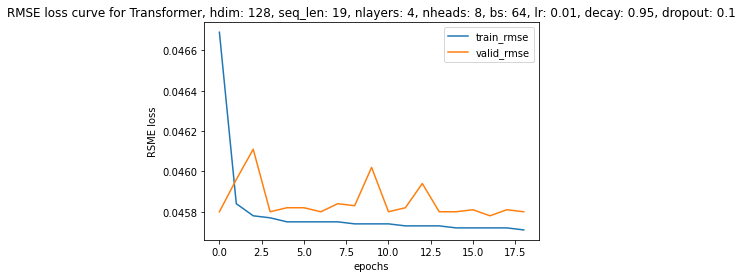

  6%|▌         | 156/2813 [00:35<05:25,  8.15it/s]


 11%|█         | 309/2813 [00:53<05:04,  8.22it/s]


 16%|█▋        | 464/2813 [01:31<04:57,  7.88it/s]


 22%|██▏       | 616/2813 [01:50<04:23,  8.33it/s]


 27%|██▋       | 767/2813 [02:15<04:20,  7.86it/s]


 33%|███▎      | 918/2813 [02:35<04:30,  7.02it/s]


 38%|███▊      | 1068/2813 [02:56<04:31,  6.44it/s]


 43%|████▎     | 1222/2813 [03:23<03:37,  7.31it/s]


 49%|████▉     | 1374/2813 [03:43<02:59,  8.03it/s]


 54%|█████▍    | 1525/2813 [04:01<02:27,  8.74it/s]


 60%|██████    | 1690/2813 [04:30<02:09,  8.65it/s]


 65%|██████▌   | 1840/2813 [04:47<01:58,  8.24it/s]


 71%|███████   | 1995/2813 [05:24<37:33,  2.76s/it]


 76%|███████▌  | 2144/2813 [05:44<01:32,  7.25it/s]


 81%|████████▏ | 2292/2813 [06:03<01:05,  7.97it/s]


 87%|████████▋ | 2440/2813 [06:33<00:50,  7.43it/s]


 92%|█████████▏| 2588/2813 [06:52<00:25,  8.85it/s]


 97%|█████████▋| 2737/2813 [07:17<00:10,  7.56it/s]


100%|██████████| 2813/2813 [07:27<00:00,  6.29it/s]


Epoch 20 | T: 8.04 | Train RMSE: 0.04571 | Valid RMSE: 0.04579


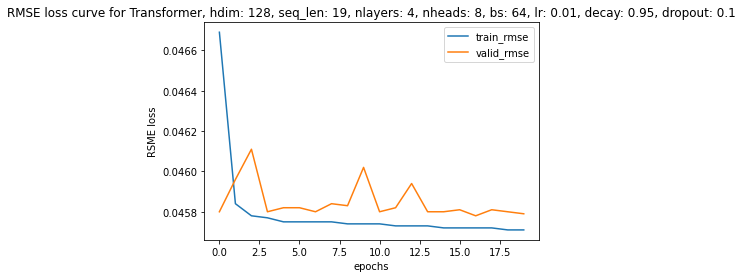

  5%|▌         | 151/2813 [00:27<05:41,  7.79it/s]


 11%|█         | 302/2813 [00:47<05:45,  7.28it/s]


 16%|█▌        | 453/2813 [01:26<04:50,  8.11it/s]


 22%|██▏       | 605/2813 [01:44<03:54,  9.42it/s]


 27%|██▋       | 756/2813 [02:03<04:07,  8.31it/s]


 33%|███▎      | 917/2813 [02:35<03:36,  8.78it/s]


 38%|███▊      | 1067/2813 [02:53<03:19,  8.77it/s]


 43%|████▎     | 1215/2813 [03:19<03:20,  7.98it/s]


 48%|████▊     | 1364/2813 [03:38<03:23,  7.13it/s]


 54%|█████▍    | 1515/2813 [03:57<02:12,  9.78it/s]


 59%|█████▉    | 1667/2813 [04:25<02:23,  7.99it/s]


 65%|██████▍   | 1815/2813 [04:44<02:02,  8.13it/s]


 70%|███████   | 1979/2813 [05:15<24:09,  1.74s/it]


 76%|███████▌  | 2127/2813 [05:33<01:28,  7.79it/s]


 81%|████████  | 2281/2813 [05:51<00:57,  9.20it/s]


 87%|████████▋ | 2434/2813 [06:28<00:49,  7.62it/s]


 92%|█████████▏| 2588/2813 [06:46<00:26,  8.56it/s]


 98%|█████████▊| 2743/2813 [07:15<00:10,  6.80it/s]


100%|██████████| 2813/2813 [07:23<00:00,  6.34it/s]


Epoch 21 | T: 7.94 | Train RMSE: 0.04571 | Valid RMSE: 0.04583


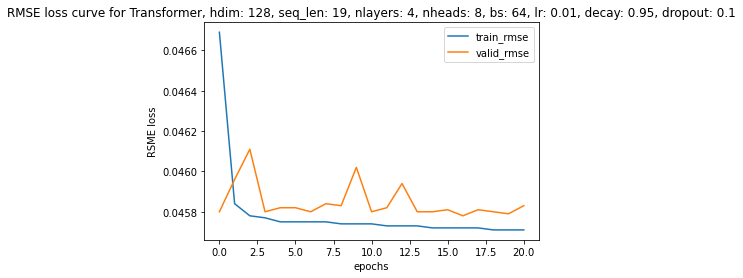

  5%|▌         | 151/2813 [00:27<05:15,  8.44it/s]


 11%|█         | 302/2813 [00:46<05:09,  8.11it/s]


 16%|█▌        | 453/2813 [01:05<05:05,  7.73it/s]


 21%|██▏       | 604/2813 [01:38<04:34,  8.05it/s]


 27%|██▋       | 757/2813 [01:58<04:15,  8.06it/s]


 32%|███▏      | 911/2813 [02:31<03:43,  8.49it/s]


 38%|███▊      | 1067/2813 [02:50<03:10,  9.17it/s]


 44%|████▎     | 1224/2813 [03:20<22:49,  1.16it/s]


 49%|████▉     | 1372/2813 [03:38<02:57,  8.10it/s]


 54%|█████▍    | 1520/2813 [03:56<02:26,  8.81it/s]


 59%|█████▉    | 1672/2813 [04:24<02:21,  8.05it/s]


 65%|██████▍   | 1820/2813 [04:42<01:56,  8.49it/s]


 70%|███████   | 1970/2813 [05:01<01:45,  8.00it/s]


 75%|███████▌  | 2119/2813 [05:29<01:35,  7.29it/s]


 81%|████████  | 2269/2813 [05:48<01:20,  6.80it/s]


 86%|████████▌ | 2420/2813 [06:06<00:46,  8.43it/s]


 92%|█████████▏| 2583/2813 [06:35<00:22, 10.16it/s]


 97%|█████████▋| 2737/2813 [06:53<00:08,  8.48it/s]


100%|██████████| 2813/2813 [07:02<00:00,  6.66it/s]


Epoch 22 | T: 7.91 | Train RMSE: 0.04571 | Valid RMSE: 0.04579


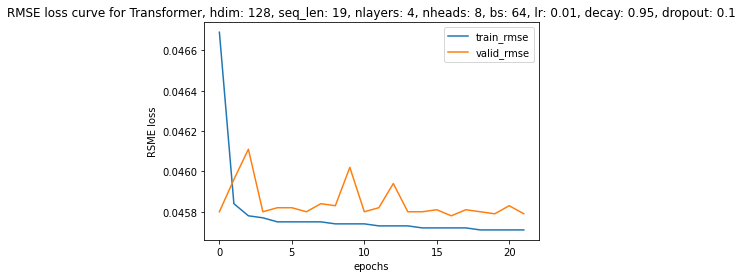

  6%|▌         | 163/2813 [00:34<05:56,  7.44it/s]


 11%|█         | 314/2813 [00:53<05:07,  8.13it/s]


 17%|█▋        | 467/2813 [01:13<04:52,  8.01it/s]


 22%|██▏       | 618/2813 [01:41<04:28,  8.19it/s]


 27%|██▋       | 771/2813 [02:00<04:05,  8.32it/s]


 33%|███▎      | 922/2813 [02:29<03:49,  8.26it/s]


 38%|███▊      | 1072/2813 [02:49<03:51,  7.52it/s]


 43%|████▎     | 1221/2813 [03:07<03:21,  7.90it/s]


 49%|████▊     | 1369/2813 [03:40<02:50,  8.46it/s]


 54%|█████▍    | 1518/2813 [03:58<02:35,  8.35it/s]


 59%|█████▉    | 1669/2813 [04:33<02:32,  7.49it/s]


 65%|██████▍   | 1817/2813 [04:52<01:58,  8.40it/s]


 70%|██████▉   | 1965/2813 [05:11<01:47,  7.90it/s]


 75%|███████▌  | 2113/2813 [05:39<01:33,  7.47it/s]


 80%|████████  | 2261/2813 [05:57<01:11,  7.72it/s]


 86%|████████▌ | 2409/2813 [06:23<01:32,  4.37it/s]


 91%|█████████ | 2562/2813 [06:42<00:29,  8.65it/s]


 97%|█████████▋| 2715/2813 [07:01<00:12,  8.03it/s]


100%|██████████| 2813/2813 [07:13<00:00,  6.49it/s]


Epoch 23 | T: 7.96 | Train RMSE: 0.04571 | Valid RMSE: 0.04583


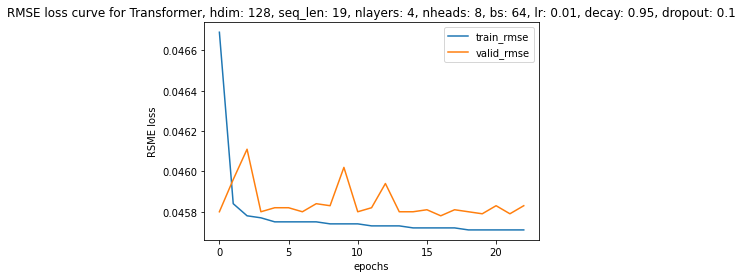

  6%|▌         | 160/2813 [00:41<17:24,  2.54it/s]


 11%|█         | 316/2813 [01:01<05:04,  8.20it/s]


 17%|█▋        | 473/2813 [01:38<05:09,  7.57it/s]


 22%|██▏       | 627/2813 [01:57<04:23,  8.30it/s]


 28%|██▊       | 783/2813 [02:15<04:19,  7.82it/s]


 33%|███▎      | 938/2813 [02:40<04:38,  6.74it/s]


 39%|███▉      | 1092/2813 [02:59<03:19,  8.64it/s]


 44%|████▍     | 1240/2813 [03:26<47:26,  1.81s/it]  


 49%|████▉     | 1388/2813 [03:45<03:00,  7.90it/s]


 55%|█████▍    | 1538/2813 [04:03<02:18,  9.23it/s]


 60%|█████▉    | 1686/2813 [04:41<02:41,  6.99it/s]


 65%|██████▌   | 1835/2813 [04:59<01:56,  8.37it/s]


 71%|███████   | 1987/2813 [05:17<01:38,  8.42it/s]


 76%|███████▌  | 2136/2813 [05:50<01:22,  8.24it/s]


 81%|████████▏ | 2287/2813 [06:07<01:05,  8.07it/s]


 87%|████████▋ | 2436/2813 [06:32<00:45,  8.27it/s]


 92%|█████████▏| 2590/2813 [06:51<00:28,  7.72it/s]


 97%|█████████▋| 2738/2813 [07:10<00:09,  8.12it/s]


100%|██████████| 2813/2813 [07:28<00:00,  6.27it/s]


Epoch 24 | T: 8.07 | Train RMSE: 0.04570 | Valid RMSE: 0.04581


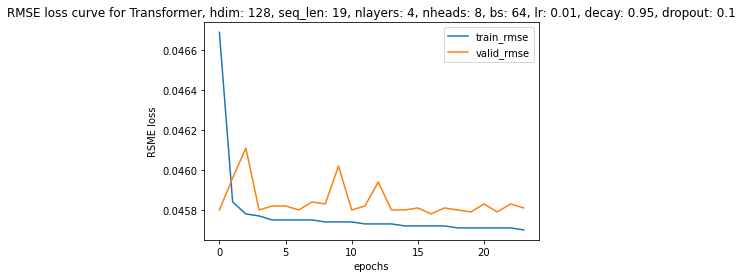

  6%|▌         | 155/2813 [00:31<06:28,  6.83it/s]


 11%|█         | 307/2813 [00:52<04:58,  8.41it/s]


 17%|█▋        | 472/2813 [01:11<03:54,  9.97it/s]


 22%|██▏       | 625/2813 [01:52<04:13,  8.62it/s]


 28%|██▊       | 776/2813 [02:11<03:57,  8.58it/s]


 33%|███▎      | 931/2813 [02:38<03:45,  8.33it/s]


 38%|███▊      | 1081/2813 [02:56<03:37,  7.95it/s]


 44%|████▍     | 1231/2813 [03:15<03:01,  8.74it/s]


 49%|████▉     | 1380/2813 [03:38<02:52,  8.31it/s]


 54%|█████▍    | 1533/2813 [03:57<02:47,  7.66it/s]


 60%|█████▉    | 1682/2813 [04:28<13:42,  1.37it/s]


 65%|██████▌   | 1830/2813 [04:46<02:03,  7.96it/s]


 71%|███████   | 1986/2813 [05:04<01:31,  9.06it/s]


 76%|███████▌  | 2138/2813 [05:39<01:25,  7.86it/s]


 81%|████████▏ | 2289/2813 [05:56<01:02,  8.41it/s]


 87%|████████▋ | 2443/2813 [06:15<00:41,  8.97it/s]


 92%|█████████▏| 2592/2813 [06:46<00:25,  8.55it/s]


 98%|█████████▊| 2743/2813 [07:04<00:08,  8.54it/s]


100%|██████████| 2813/2813 [07:13<00:00,  6.49it/s]


Epoch 25 | T: 7.93 | Train RMSE: 0.04571 | Valid RMSE: 0.04578


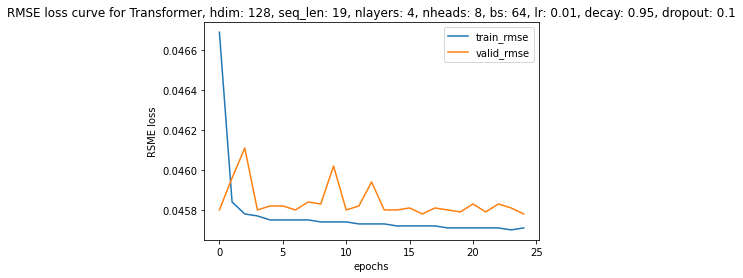

  6%|▌         | 161/2813 [00:30<2:31:50,  3.44s/it]


 11%|█         | 312/2813 [00:51<05:31,  7.55it/s]


 17%|█▋        | 471/2813 [01:11<04:49,  8.10it/s]


 22%|██▏       | 625/2813 [01:44<05:00,  7.29it/s]


 28%|██▊       | 782/2813 [02:04<04:28,  7.58it/s]


 33%|███▎      | 936/2813 [02:37<04:07,  7.60it/s]


 39%|███▊      | 1086/2813 [02:56<03:26,  8.38it/s]


 44%|████▍     | 1244/2813 [03:16<02:46,  9.40it/s]


 50%|████▉     | 1400/2813 [03:44<03:08,  7.48it/s]


 55%|█████▌    | 1548/2813 [04:05<02:44,  7.71it/s]


 60%|██████    | 1696/2813 [04:33<02:50,  6.57it/s]


 66%|██████▌   | 1845/2813 [04:54<02:29,  6.46it/s]


 71%|███████   | 1993/2813 [05:13<01:48,  7.53it/s]


 76%|███████▌  | 2141/2813 [05:40<01:33,  7.20it/s]


 81%|████████▏ | 2290/2813 [05:59<00:58,  8.98it/s]


 87%|████████▋ | 2447/2813 [06:17<00:43,  8.49it/s]


 92%|█████████▏| 2595/2813 [06:47<00:27,  8.01it/s]


 98%|█████████▊| 2743/2813 [07:06<00:09,  7.64it/s]


100%|██████████| 2813/2813 [07:14<00:00,  6.48it/s]


Epoch 26 | T: 8.11 | Train RMSE: 0.04570 | Valid RMSE: 0.04579


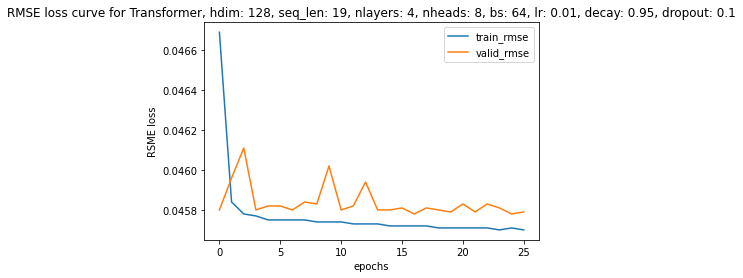

  5%|▌         | 151/2813 [00:31<05:44,  7.73it/s]


 11%|█         | 306/2813 [00:51<05:26,  7.69it/s]


 16%|█▋        | 460/2813 [01:10<04:54,  7.98it/s]


 22%|██▏       | 612/2813 [01:41<05:02,  7.27it/s]


 27%|██▋       | 763/2813 [02:01<04:35,  7.45it/s]


 32%|███▏      | 914/2813 [02:28<03:57,  7.99it/s]


 38%|███▊      | 1066/2813 [02:47<03:33,  8.19it/s]


 43%|████▎     | 1218/2813 [03:05<02:51,  9.30it/s]


 49%|████▉     | 1378/2813 [03:38<03:00,  7.93it/s]


 54%|█████▍    | 1528/2813 [03:56<02:46,  7.74it/s]


 60%|█████▉    | 1677/2813 [04:31<33:54,  1.79s/it]


 65%|██████▍   | 1827/2813 [04:50<02:14,  7.34it/s]


 70%|███████   | 1978/2813 [05:08<01:57,  7.13it/s]


 76%|███████▌  | 2129/2813 [05:36<01:17,  8.83it/s]


 81%|████████  | 2279/2813 [05:55<01:05,  8.12it/s]


 87%|████████▋ | 2434/2813 [06:13<00:44,  8.57it/s]


 92%|█████████▏| 2582/2813 [06:40<00:26,  8.64it/s]


 97%|█████████▋| 2731/2813 [06:57<00:10,  7.92it/s]


100%|██████████| 2813/2813 [07:07<00:00,  6.58it/s]


Epoch 27 | T: 7.89 | Train RMSE: 0.04570 | Valid RMSE: 0.04579


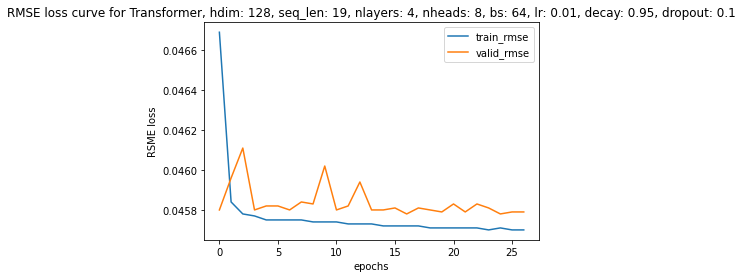

  6%|▌         | 155/2813 [00:18<05:02,  8.78it/s]


 11%|█         | 307/2813 [01:04<05:19,  7.84it/s]


 16%|█▋        | 458/2813 [01:34<06:46,  5.80it/s]


 22%|██▏       | 609/2813 [01:54<04:23,  8.38it/s]


 27%|██▋       | 760/2813 [02:14<04:36,  7.43it/s]


 32%|███▏      | 911/2813 [02:39<04:13,  7.51it/s]


 38%|███▊      | 1061/2813 [02:59<03:53,  7.50it/s]


 43%|████▎     | 1221/2813 [03:18<03:02,  8.73it/s]


 49%|████▊     | 1369/2813 [03:46<02:47,  8.60it/s]


 55%|█████▍    | 1534/2813 [04:05<02:14,  9.54it/s]


 61%|██████▏   | 1723/2813 [04:48<02:03,  8.84it/s]


 67%|██████▋   | 1881/2813 [05:06<01:49,  8.48it/s]


 73%|███████▎  | 2048/2813 [05:38<01:34,  8.12it/s]


 78%|███████▊  | 2204/2813 [05:56<01:05,  9.30it/s]


 84%|████████▍ | 2359/2813 [06:14<00:53,  8.49it/s]


 89%|████████▉ | 2508/2813 [06:38<00:38,  7.99it/s]


 95%|█████████▍| 2659/2813 [06:56<00:17,  8.59it/s]


100%|█████████▉| 2808/2813 [07:13<00:00,  8.03it/s]


100%|██████████| 2813/2813 [07:13<00:00,  6.48it/s]


Epoch 28 | T: 7.89 | Train RMSE: 0.04569 | Valid RMSE: 0.04584


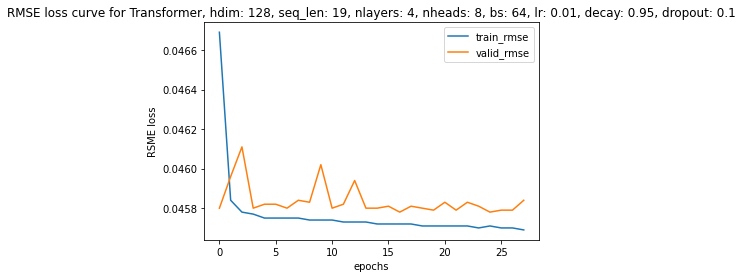

  6%|▋         | 178/2813 [00:18<04:45,  9.23it/s]


 12%|█▏        | 349/2813 [01:00<04:22,  9.38it/s]


 18%|█▊        | 503/2813 [01:17<04:21,  8.83it/s]


 23%|██▎       | 660/2813 [01:58<04:11,  8.57it/s]


 29%|██▉       | 813/2813 [02:14<03:41,  9.03it/s]


 34%|███▍      | 969/2813 [02:38<03:22,  9.11it/s]


 40%|███▉      | 1118/2813 [02:56<03:11,  8.87it/s]


 45%|████▌     | 1273/2813 [03:13<02:47,  9.18it/s]


 51%|█████     | 1430/2813 [03:37<08:28,  2.72it/s]


 56%|█████▌    | 1578/2813 [03:55<02:26,  8.41it/s]


 62%|██████▏   | 1735/2813 [04:12<02:00,  8.96it/s]


 67%|██████▋   | 1894/2813 [04:44<12:26,  1.23it/s]


 73%|███████▎  | 2048/2813 [05:01<01:24,  9.06it/s]


 78%|███████▊  | 2200/2813 [05:19<01:07,  9.09it/s]


 84%|████████▎ | 2353/2813 [06:01<00:53,  8.53it/s]


 89%|████████▉ | 2503/2813 [06:18<00:34,  9.08it/s]


 94%|█████████▍| 2654/2813 [06:46<00:18,  8.37it/s]


100%|█████████▉| 2806/2813 [07:03<00:00,  8.60it/s]


100%|██████████| 2813/2813 [07:04<00:00,  6.62it/s]


Epoch 29 | T: 7.72 | Train RMSE: 0.04571 | Valid RMSE: 0.04579


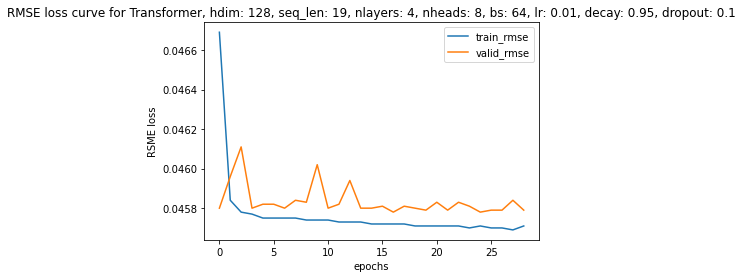

  5%|▌         | 153/2813 [00:18<05:41,  7.78it/s]


 11%|█         | 304/2813 [00:37<04:38,  9.00it/s]


 16%|█▋        | 460/2813 [01:12<05:26,  7.20it/s]


 22%|██▏       | 620/2813 [01:31<05:10,  7.07it/s]


 28%|██▊       | 774/2813 [02:06<03:51,  8.82it/s]


 33%|███▎      | 925/2813 [02:24<03:53,  8.10it/s]


 38%|███▊      | 1078/2813 [02:43<03:46,  7.67it/s]


 44%|████▎     | 1230/2813 [03:12<03:25,  7.69it/s]


 49%|████▉     | 1378/2813 [03:31<03:15,  7.35it/s]


 54%|█████▍    | 1527/2813 [03:57<03:07,  6.86it/s]


 60%|█████▉    | 1675/2813 [04:16<02:19,  8.19it/s]


 65%|██████▍   | 1827/2813 [04:35<01:56,  8.46it/s]


 70%|███████   | 1980/2813 [05:03<01:46,  7.82it/s]


 76%|███████▌  | 2129/2813 [05:22<01:27,  7.78it/s]


 81%|████████  | 2283/2813 [05:40<01:06,  7.96it/s]


 87%|████████▋ | 2434/2813 [06:08<00:42,  8.87it/s]


 92%|█████████▏| 2586/2813 [06:26<00:26,  8.71it/s]


 97%|█████████▋| 2737/2813 [06:44<00:07,  9.94it/s]


100%|██████████| 2813/2813 [07:13<00:00,  6.48it/s]


Epoch 30 | T: 7.77 | Train RMSE: 0.04570 | Valid RMSE: 0.04579


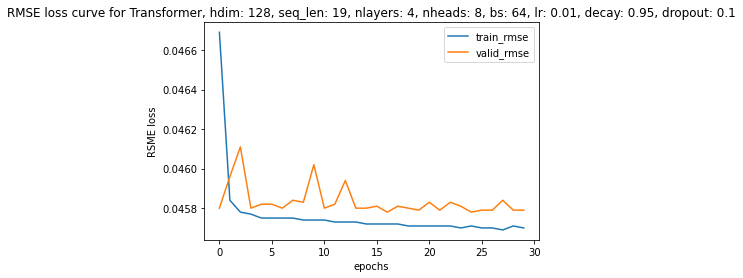

  6%|▌         | 155/2813 [00:31<05:02,  8.78it/s]


 11%|█         | 306/2813 [00:50<05:18,  7.86it/s]


 16%|█▋        | 460/2813 [01:19<05:20,  7.34it/s]


 22%|██▏       | 614/2813 [01:38<04:27,  8.21it/s]


 27%|██▋       | 767/2813 [01:57<04:18,  7.91it/s]


 33%|███▎      | 918/2813 [02:26<03:58,  7.96it/s]


 38%|███▊      | 1068/2813 [02:44<03:17,  8.83it/s]


 43%|████▎     | 1217/2813 [03:02<03:04,  8.65it/s]


 49%|████▊     | 1370/2813 [03:34<02:43,  8.85it/s]


 54%|█████▍    | 1525/2813 [03:52<02:40,  8.00it/s]


 60%|█████▉    | 1678/2813 [04:25<02:15,  8.35it/s]


 65%|██████▍   | 1827/2813 [04:43<01:55,  8.52it/s]


 70%|███████   | 1977/2813 [05:01<01:32,  9.06it/s]


 76%|███████▌  | 2125/2813 [05:28<01:22,  8.30it/s]


 81%|████████  | 2273/2813 [05:45<01:03,  8.54it/s]


 86%|████████▌ | 2425/2813 [06:13<01:50,  3.53it/s]


 91%|█████████▏| 2573/2813 [06:31<00:29,  8.25it/s]


 97%|█████████▋| 2722/2813 [06:49<00:11,  8.24it/s]


100%|██████████| 2813/2813 [07:00<00:00,  6.69it/s]


Epoch 31 | T: 7.76 | Train RMSE: 0.04570 | Valid RMSE: 0.04579


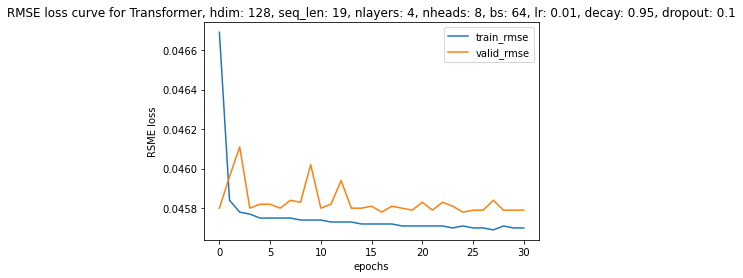

  5%|▌         | 152/2813 [00:17<04:52,  9.08it/s]


 11%|█         | 309/2813 [00:59<05:03,  8.24it/s]


 17%|█▋        | 471/2813 [01:37<08:17,  4.71it/s]


 22%|██▏       | 622/2813 [02:08<06:15,  5.84it/s]


 27%|██▋       | 773/2813 [02:39<06:58,  4.87it/s]


 33%|███▎      | 924/2813 [03:13<06:47,  4.64it/s]


 38%|███▊      | 1074/2813 [03:46<06:40,  4.34it/s]


 43%|████▎     | 1222/2813 [04:17<05:09,  5.13it/s]


 49%|████▊     | 1370/2813 [04:51<06:07,  3.93it/s]


 54%|█████▍    | 1518/2813 [05:24<04:13,  5.11it/s]


 59%|█████▉    | 1666/2813 [05:56<03:54,  4.89it/s]


 64%|██████▍   | 1814/2813 [06:26<03:07,  5.34it/s]


 70%|██████▉   | 1962/2813 [06:55<02:50,  4.99it/s]


 75%|███████▌  | 2110/2813 [07:28<02:03,  5.71it/s]


 80%|████████  | 2258/2813 [07:57<02:05,  4.44it/s]


 86%|████████▌ | 2406/2813 [08:30<01:18,  5.16it/s]


 91%|█████████ | 2554/2813 [09:00<00:58,  4.46it/s]


 96%|█████████▌| 2702/2813 [09:32<00:19,  5.62it/s]


100%|██████████| 2813/2813 [09:54<00:00,  4.73it/s]


Epoch 32 | T: 11.22 | Train RMSE: 0.04570 | Valid RMSE: 0.04579


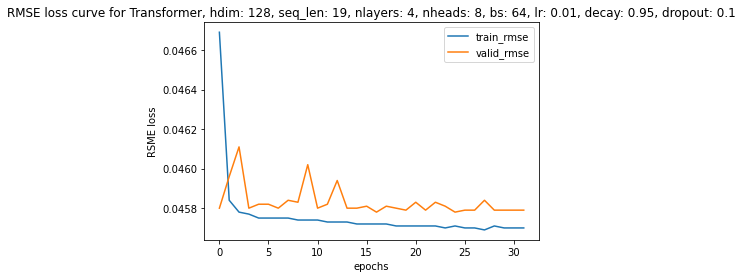

  5%|▌         | 151/2813 [00:30<08:54,  4.98it/s]


 11%|█         | 302/2813 [00:59<07:55,  5.28it/s]


 16%|█▌        | 453/2813 [01:30<06:57,  5.65it/s]


 21%|██▏       | 604/2813 [01:57<06:39,  5.53it/s]


 27%|██▋       | 755/2813 [02:27<05:54,  5.81it/s]


 32%|███▏      | 906/2813 [02:55<05:01,  6.33it/s]


 38%|███▊      | 1056/2813 [03:28<06:00,  4.87it/s]


 43%|████▎     | 1204/2813 [03:58<04:11,  6.39it/s]


 48%|████▊     | 1352/2813 [04:29<04:17,  5.67it/s]


 53%|█████▎    | 1500/2813 [04:59<05:40,  3.86it/s]


 59%|█████▊    | 1648/2813 [05:33<04:05,  4.75it/s]


 64%|██████▍   | 1796/2813 [06:02<03:27,  4.90it/s]


 69%|██████▉   | 1944/2813 [06:37<02:56,  4.93it/s]


 74%|███████▍  | 2092/2813 [07:07<02:18,  5.20it/s]


 80%|███████▉  | 2240/2813 [07:38<01:53,  5.06it/s]


 85%|████████▍ | 2388/2813 [08:09<06:18,  1.12it/s]


 90%|█████████ | 2536/2813 [08:38<01:05,  4.20it/s]


 95%|█████████▌| 2684/2813 [09:05<00:25,  5.13it/s]


100%|██████████| 2813/2813 [09:32<00:00,  4.92it/s]


Epoch 33 | T: 10.78 | Train RMSE: 0.04570 | Valid RMSE: 0.04585


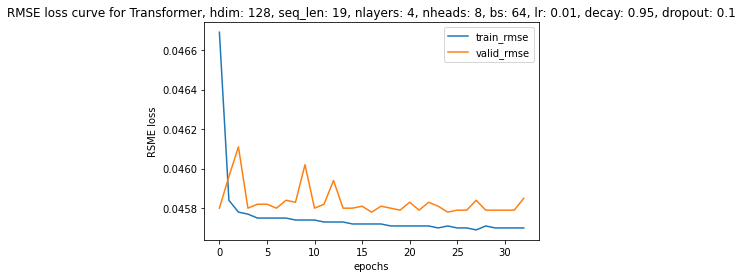

  5%|▌         | 151/2813 [00:30<08:03,  5.50it/s]


 11%|█         | 302/2813 [00:57<06:37,  6.32it/s]


 16%|█▌        | 454/2813 [01:27<06:25,  6.11it/s]


 22%|██▏       | 605/2813 [01:54<06:47,  5.41it/s]


 27%|██▋       | 756/2813 [02:24<14:36,  2.35it/s]


 32%|███▏      | 907/2813 [02:52<05:36,  5.66it/s]


 38%|███▊      | 1057/2813 [03:18<04:52,  6.00it/s]


 43%|████▎     | 1205/2813 [03:49<04:41,  5.71it/s]


 48%|████▊     | 1354/2813 [04:16<04:39,  5.22it/s]


 53%|█████▎    | 1502/2813 [04:47<04:10,  5.24it/s]


 59%|█████▊    | 1650/2813 [05:13<03:21,  5.78it/s]


 64%|██████▍   | 1798/2813 [05:44<02:48,  6.01it/s]


 69%|██████▉   | 1946/2813 [06:11<02:38,  5.47it/s]


 74%|███████▍  | 2094/2813 [06:41<02:03,  5.83it/s]


 80%|███████▉  | 2242/2813 [07:08<01:32,  6.20it/s]


 85%|████████▍ | 2390/2813 [07:36<01:14,  5.69it/s]


 90%|█████████ | 2538/2813 [08:02<00:48,  5.72it/s]


 95%|█████████▌| 2686/2813 [08:30<00:20,  6.09it/s]


100%|██████████| 2813/2813 [08:50<00:00,  5.30it/s]


Epoch 34 | T: 9.98 | Train RMSE: 0.04569 | Valid RMSE: 0.04579


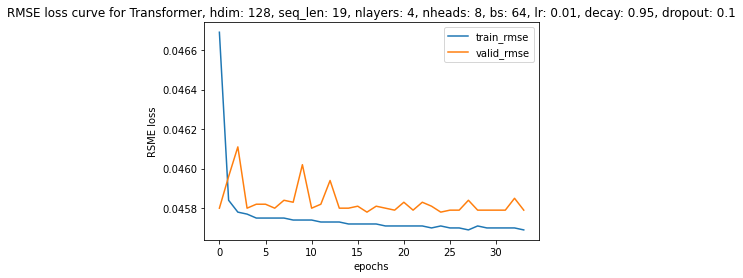

  5%|▌         | 151/2813 [00:29<1:24:34,  1.91s/it]


 11%|█         | 302/2813 [00:53<05:32,  7.55it/s]


 16%|█▌        | 453/2813 [01:15<05:45,  6.82it/s]


 22%|██▏       | 605/2813 [01:41<04:44,  7.77it/s]


 27%|██▋       | 756/2813 [02:03<05:01,  6.83it/s]


 32%|███▏      | 907/2813 [02:34<04:56,  6.42it/s]


 38%|███▊      | 1057/2813 [02:58<04:53,  5.99it/s]


 43%|████▎     | 1205/2813 [03:21<03:59,  6.71it/s]


 48%|████▊     | 1353/2813 [03:50<03:43,  6.53it/s]


 53%|█████▎    | 1501/2813 [04:13<03:19,  6.58it/s]


 59%|█████▊    | 1649/2813 [04:40<02:45,  7.02it/s]


 64%|██████▍   | 1797/2813 [05:02<02:37,  6.45it/s]


 69%|██████▉   | 1945/2813 [05:29<07:14,  2.00it/s]


 74%|███████▍  | 2093/2813 [05:51<01:42,  7.02it/s]


 80%|███████▉  | 2241/2813 [06:11<01:14,  7.70it/s]


 85%|████████▍ | 2389/2813 [06:37<00:54,  7.72it/s]


 90%|█████████ | 2537/2813 [06:57<00:35,  7.74it/s]


 95%|█████████▌| 2685/2813 [07:17<00:19,  6.72it/s]


100%|██████████| 2813/2813 [07:45<00:00,  6.04it/s]


Epoch 35 | T: 8.70 | Train RMSE: 0.04569 | Valid RMSE: 0.04579


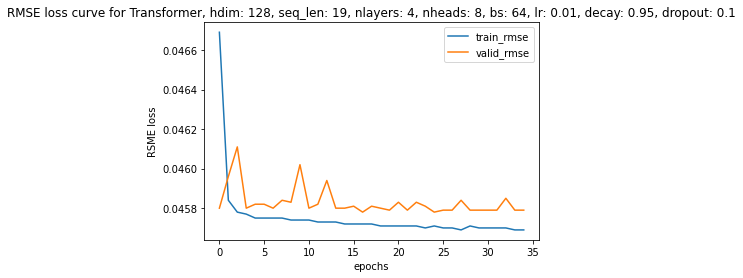

  5%|▌         | 151/2813 [00:20<06:02,  7.35it/s]


 11%|█         | 302/2813 [00:41<05:46,  7.24it/s]


 16%|█▌        | 455/2813 [01:10<05:01,  7.83it/s]


 22%|██▏       | 606/2813 [01:30<04:53,  7.52it/s]


 27%|██▋       | 757/2813 [01:58<04:32,  7.55it/s]


 32%|███▏      | 908/2813 [02:20<04:16,  7.42it/s]


 38%|███▊      | 1058/2813 [02:41<04:01,  7.26it/s]


 43%|████▎     | 1206/2813 [03:10<03:48,  7.02it/s]


 48%|████▊     | 1354/2813 [03:34<03:16,  7.44it/s]


 53%|█████▎    | 1502/2813 [04:01<02:45,  7.93it/s]


 59%|█████▊    | 1650/2813 [04:21<02:38,  7.32it/s]


 64%|██████▍   | 1798/2813 [04:42<02:24,  7.04it/s]


 69%|██████▉   | 1946/2813 [05:10<02:05,  6.91it/s]


 74%|███████▍  | 2094/2813 [05:31<01:37,  7.34it/s]


 80%|███████▉  | 2242/2813 [06:00<01:17,  7.38it/s]


 85%|████████▍ | 2390/2813 [06:21<00:56,  7.46it/s]


 90%|█████████ | 2538/2813 [06:42<00:40,  6.73it/s]


 95%|█████████▌| 2686/2813 [07:08<00:16,  7.65it/s]


100%|██████████| 2813/2813 [07:25<00:00,  6.32it/s]


Epoch 36 | T: 8.14 | Train RMSE: 0.04569 | Valid RMSE: 0.04579


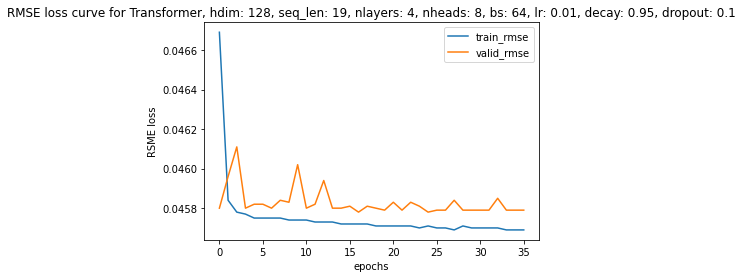

  5%|▌         | 151/2813 [00:19<05:27,  8.13it/s]


 11%|█         | 302/2813 [00:51<06:02,  6.92it/s]


 16%|█▌        | 454/2813 [01:11<05:02,  7.80it/s]


 22%|██▏       | 606/2813 [01:30<04:47,  7.68it/s]


 27%|██▋       | 758/2813 [02:11<04:37,  7.41it/s]


 32%|███▏      | 909/2813 [02:30<03:49,  8.30it/s]


 38%|███▊      | 1059/2813 [02:56<04:05,  7.13it/s]


 43%|████▎     | 1207/2813 [03:16<03:38,  7.33it/s]


 48%|████▊     | 1355/2813 [03:35<03:18,  7.35it/s]


 53%|█████▎    | 1503/2813 [03:59<02:30,  8.70it/s]


 59%|█████▉    | 1656/2813 [04:18<02:35,  7.45it/s]


 64%|██████▍   | 1807/2813 [04:46<03:58,  4.22it/s]


 70%|██████▉   | 1957/2813 [05:05<01:37,  8.80it/s]


 75%|███████▍  | 2105/2813 [05:22<01:17,  9.15it/s]


 80%|████████  | 2254/2813 [05:53<01:02,  8.94it/s]


 85%|████████▌ | 2402/2813 [06:12<00:54,  7.50it/s]


 91%|█████████ | 2551/2813 [06:31<00:32,  8.18it/s]


 96%|█████████▌| 2699/2813 [07:07<00:14,  8.12it/s]


100%|██████████| 2813/2813 [07:20<00:00,  6.38it/s]


Epoch 37 | T: 8.09 | Train RMSE: 0.04570 | Valid RMSE: 0.04581


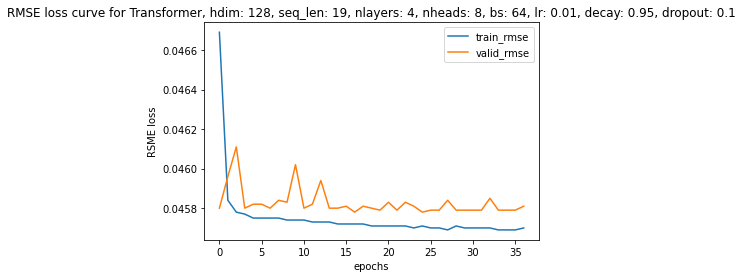

  5%|▌         | 151/2813 [00:18<05:25,  8.18it/s]


 11%|█         | 303/2813 [00:48<04:40,  8.95it/s]


 16%|█▌        | 454/2813 [01:08<04:45,  8.27it/s]


 22%|██▏       | 606/2813 [01:29<05:07,  7.18it/s]


 27%|██▋       | 757/2813 [02:01<05:25,  6.31it/s]


 32%|███▏      | 908/2813 [02:21<03:52,  8.20it/s]


 38%|███▊      | 1060/2813 [02:51<04:17,  6.81it/s]


 43%|████▎     | 1210/2813 [03:11<03:30,  7.62it/s]


 48%|████▊     | 1359/2813 [03:29<02:57,  8.18it/s]


 54%|█████▎    | 1508/2813 [03:58<02:35,  8.38it/s]


 59%|█████▉    | 1656/2813 [04:16<02:22,  8.13it/s]


 64%|██████▍   | 1804/2813 [04:44<01:57,  8.60it/s]


 69%|██████▉   | 1952/2813 [05:02<01:47,  8.03it/s]


 75%|███████▍  | 2102/2813 [05:21<01:23,  8.50it/s]


 80%|████████  | 2251/2813 [05:49<01:09,  8.05it/s]


 85%|████████▌ | 2399/2813 [06:07<00:52,  7.87it/s]


 91%|█████████ | 2547/2813 [06:25<00:31,  8.49it/s]


 96%|█████████▌| 2696/2813 [06:53<00:14,  8.15it/s]


100%|██████████| 2813/2813 [07:08<00:00,  6.57it/s]


Epoch 38 | T: 8.00 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


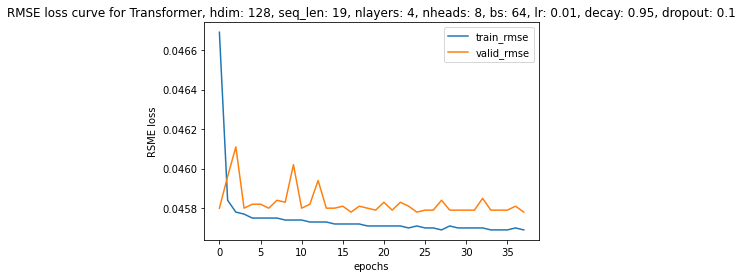

  5%|▌         | 151/2813 [00:18<05:05,  8.70it/s]


 11%|█         | 307/2813 [00:52<05:37,  7.42it/s]


 16%|█▋        | 459/2813 [01:11<04:50,  8.11it/s]


 22%|██▏       | 610/2813 [01:30<04:31,  8.11it/s]


 27%|██▋       | 761/2813 [01:56<04:29,  7.62it/s]


 32%|███▏      | 912/2813 [02:14<03:49,  8.27it/s]


 38%|███▊      | 1063/2813 [02:32<03:32,  8.23it/s]


 43%|████▎     | 1211/2813 [02:57<03:02,  8.76it/s]


 48%|████▊     | 1360/2813 [03:15<02:50,  8.52it/s]


 54%|█████▍    | 1513/2813 [03:45<1:24:57,  3.92s/it]


 59%|█████▉    | 1661/2813 [04:03<02:12,  8.68it/s]


 64%|██████▍   | 1809/2813 [04:21<01:54,  8.77it/s]


 70%|██████▉   | 1958/2813 [04:58<01:39,  8.63it/s]


 75%|███████▍  | 2106/2813 [05:15<01:26,  8.14it/s]


 80%|████████  | 2259/2813 [05:42<16:33,  1.79s/it]


 86%|████████▌ | 2408/2813 [05:59<00:45,  8.98it/s]


 91%|█████████ | 2560/2813 [06:17<00:30,  8.33it/s]


 96%|█████████▋| 2710/2813 [06:41<00:13,  7.53it/s]


100%|██████████| 2813/2813 [06:54<00:00,  6.79it/s]


Epoch 39 | T: 7.45 | Train RMSE: 0.04569 | Valid RMSE: 0.04580


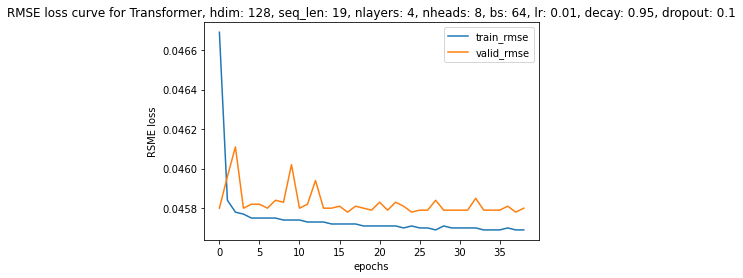

  5%|▌         | 153/2813 [00:31<05:10,  8.56it/s]


 11%|█         | 305/2813 [00:49<04:56,  8.47it/s]


 16%|█▌        | 457/2813 [01:27<07:08,  5.50it/s]


 22%|██▏       | 608/2813 [01:46<05:09,  7.13it/s]


 27%|██▋       | 762/2813 [02:05<04:14,  8.06it/s]


 32%|███▏      | 913/2813 [02:34<03:40,  8.61it/s]


 38%|███▊      | 1064/2813 [02:52<03:01,  9.63it/s]


 43%|████▎     | 1221/2813 [03:18<03:37,  7.33it/s]


 49%|████▊     | 1369/2813 [03:36<03:01,  7.96it/s]


 54%|█████▍    | 1518/2813 [03:56<02:46,  7.79it/s]


 59%|█████▉    | 1666/2813 [04:25<02:20,  8.18it/s]


 65%|██████▍   | 1815/2813 [04:44<02:00,  8.27it/s]


 70%|██████▉   | 1967/2813 [05:02<01:35,  8.88it/s]


 75%|███████▌  | 2117/2813 [05:31<01:25,  8.14it/s]


 81%|████████  | 2268/2813 [05:49<01:03,  8.62it/s]


 86%|████████▌ | 2417/2813 [06:27<28:09,  4.27s/it]


 91%|█████████▏| 2568/2813 [06:45<00:28,  8.50it/s]


 97%|█████████▋| 2722/2813 [07:03<00:10,  8.28it/s]


100%|██████████| 2813/2813 [07:23<00:00,  6.34it/s]


Epoch 40 | T: 7.95 | Train RMSE: 0.04570 | Valid RMSE: 0.04578


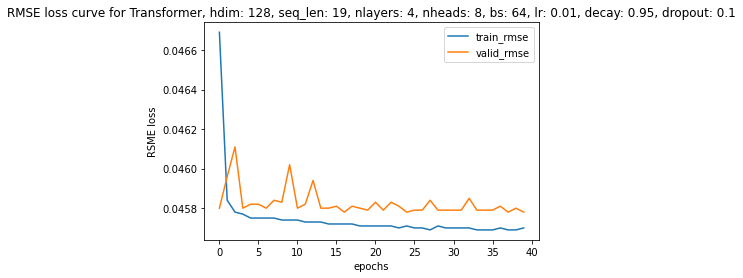

  5%|▌         | 153/2813 [00:26<04:57,  8.93it/s]


 11%|█         | 304/2813 [00:44<05:05,  8.21it/s]


 16%|█▌        | 457/2813 [01:02<04:32,  8.66it/s]


 22%|██▏       | 608/2813 [01:36<04:42,  7.80it/s]


 27%|██▋       | 760/2813 [01:55<04:19,  7.90it/s]


 32%|███▏      | 912/2813 [02:25<04:12,  7.54it/s]


 38%|███▊      | 1062/2813 [02:44<03:37,  8.06it/s]


 43%|████▎     | 1212/2813 [03:02<03:12,  8.32it/s]


 48%|████▊     | 1361/2813 [03:30<02:51,  8.48it/s]


 54%|█████▎    | 1510/2813 [03:48<02:34,  8.45it/s]


 59%|█████▉    | 1658/2813 [04:06<02:07,  9.07it/s]


 64%|██████▍   | 1808/2813 [04:34<01:58,  8.50it/s]


 70%|██████▉   | 1956/2813 [04:53<01:42,  8.36it/s]


 75%|███████▍  | 2104/2813 [05:21<36:16,  3.07s/it]


 80%|████████  | 2252/2813 [05:39<01:08,  8.24it/s]


 85%|████████▌ | 2400/2813 [05:58<00:51,  8.01it/s]


 91%|█████████ | 2548/2813 [06:25<00:32,  8.03it/s]


 96%|█████████▌| 2696/2813 [06:43<00:14,  8.31it/s]


100%|██████████| 2813/2813 [06:57<00:00,  6.74it/s]


Epoch 41 | T: 7.76 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


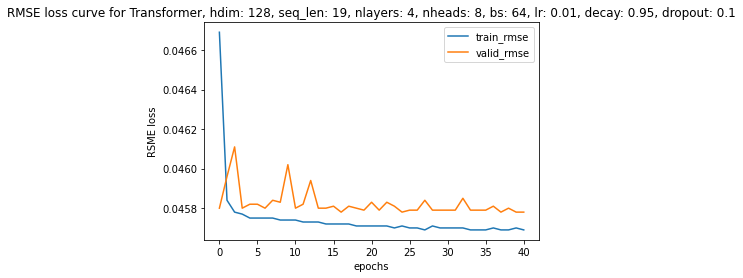

  6%|▌         | 156/2813 [00:18<05:19,  8.31it/s]


 11%|█         | 310/2813 [00:54<05:15,  7.92it/s]


 16%|█▋        | 462/2813 [01:12<05:00,  7.81it/s]


 22%|██▏       | 613/2813 [01:41<05:33,  6.59it/s]


 27%|██▋       | 764/2813 [02:02<04:16,  7.99it/s]


 33%|███▎      | 915/2813 [02:22<04:17,  7.38it/s]


 38%|███▊      | 1065/2813 [02:49<03:59,  7.30it/s]


 43%|████▎     | 1215/2813 [03:08<03:26,  7.75it/s]


 48%|████▊     | 1364/2813 [03:26<02:58,  8.11it/s]


 54%|█████▍    | 1512/2813 [03:54<02:53,  7.51it/s]


 59%|█████▉    | 1662/2813 [04:15<02:10,  8.81it/s]


 64%|██████▍   | 1810/2813 [04:55<02:10,  7.67it/s]


 70%|██████▉   | 1966/2813 [05:13<01:35,  8.89it/s]


 75%|███████▌  | 2118/2813 [05:41<01:24,  8.25it/s]


 81%|████████  | 2266/2813 [05:59<01:01,  8.91it/s]


 86%|████████▌ | 2419/2813 [06:17<00:46,  8.44it/s]


 91%|█████████▏| 2571/2813 [06:41<00:28,  8.60it/s]


 97%|█████████▋| 2723/2813 [06:59<00:11,  7.89it/s]


100%|██████████| 2813/2813 [07:10<00:00,  6.54it/s]


Epoch 42 | T: 7.88 | Train RMSE: 0.04569 | Valid RMSE: 0.04580


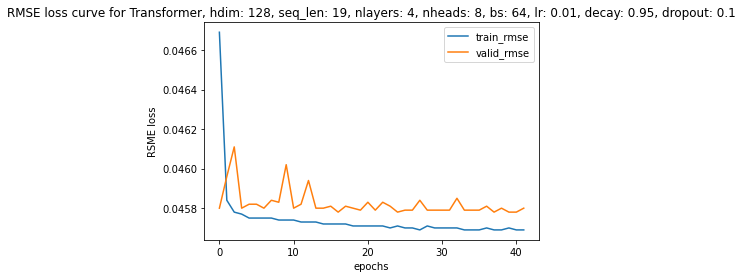

  5%|▌         | 152/2813 [00:18<05:21,  8.26it/s]


 11%|█         | 307/2813 [01:02<04:58,  8.41it/s]


 16%|█▋        | 464/2813 [01:20<04:38,  8.43it/s]


 22%|██▏       | 620/2813 [01:51<04:27,  8.21it/s]


 27%|██▋       | 773/2813 [02:09<04:08,  8.21it/s]


 33%|███▎      | 926/2813 [02:27<03:38,  8.65it/s]


 38%|███▊      | 1079/2813 [02:50<03:15,  8.89it/s]


 44%|████▎     | 1227/2813 [03:08<03:11,  8.30it/s]


 49%|████▉     | 1376/2813 [03:26<02:47,  8.58it/s]


 54%|█████▍    | 1526/2813 [03:53<02:25,  8.82it/s]


 60%|█████▉    | 1677/2813 [04:11<02:18,  8.23it/s]


 65%|██████▍   | 1827/2813 [04:29<02:05,  7.86it/s]


 70%|███████   | 1976/2813 [05:03<01:43,  8.12it/s]


 76%|███████▌  | 2124/2813 [05:21<01:23,  8.20it/s]


 81%|████████  | 2272/2813 [05:56<01:13,  7.35it/s]


 86%|████████▌ | 2422/2813 [06:17<00:56,  6.93it/s]


 91%|█████████▏| 2572/2813 [06:44<00:36,  6.61it/s]


 97%|█████████▋| 2720/2813 [07:02<00:11,  8.30it/s]


100%|██████████| 2813/2813 [07:13<00:00,  6.49it/s]


Epoch 43 | T: 7.89 | Train RMSE: 0.04569 | Valid RMSE: 0.04580


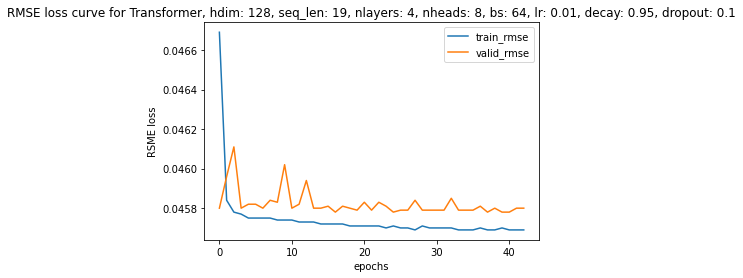

  5%|▌         | 154/2813 [00:19<04:44,  9.33it/s]


 11%|█         | 307/2813 [00:37<04:40,  8.93it/s]


 17%|█▋        | 466/2813 [01:11<04:53,  8.00it/s]


 22%|██▏       | 619/2813 [01:31<04:31,  8.07it/s]


 27%|██▋       | 771/2813 [02:07<03:50,  8.87it/s]


 33%|███▎      | 934/2813 [02:27<03:49,  8.17it/s]


 39%|███▊      | 1089/2813 [02:54<03:26,  8.36it/s]


 44%|████▍     | 1239/2813 [03:12<03:18,  7.93it/s]


 49%|████▉     | 1388/2813 [03:30<03:05,  7.68it/s]


 55%|█████▍    | 1537/2813 [03:56<02:42,  7.84it/s]


 60%|█████▉    | 1685/2813 [04:14<02:46,  6.78it/s]


 65%|██████▌   | 1834/2813 [04:34<01:50,  8.84it/s]


 71%|███████   | 1988/2813 [05:04<01:49,  7.52it/s]


 76%|███████▌  | 2139/2813 [05:22<01:18,  8.54it/s]


 81%|████████▏ | 2290/2813 [05:41<01:06,  7.92it/s]


 87%|████████▋ | 2439/2813 [06:10<00:43,  8.55it/s]


 92%|█████████▏| 2589/2813 [06:28<00:26,  8.50it/s]


 97%|█████████▋| 2740/2813 [07:03<00:08,  8.33it/s]


100%|██████████| 2813/2813 [07:12<00:00,  6.51it/s]


Epoch 44 | T: 7.93 | Train RMSE: 0.04569 | Valid RMSE: 0.04579


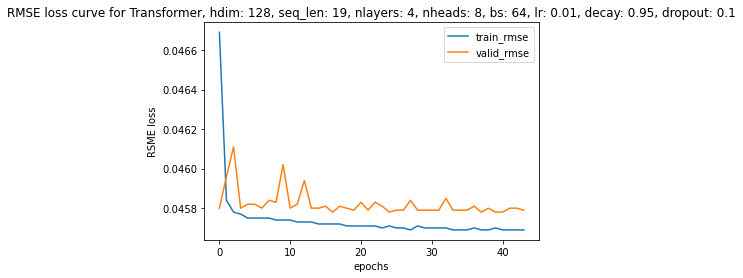

  5%|▌         | 152/2813 [00:18<05:08,  8.61it/s]


 11%|█         | 312/2813 [00:36<04:49,  8.63it/s]


 17%|█▋        | 467/2813 [01:06<05:19,  7.35it/s]


 22%|██▏       | 618/2813 [01:28<05:20,  6.84it/s]


 27%|██▋       | 772/2813 [01:57<06:27,  5.27it/s]


 33%|███▎      | 928/2813 [02:18<04:17,  7.31it/s]


 38%|███▊      | 1078/2813 [02:38<03:28,  8.32it/s]


 44%|████▎     | 1226/2813 [03:06<03:25,  7.71it/s]


 49%|████▉     | 1375/2813 [03:25<03:16,  7.32it/s]


 54%|█████▍    | 1530/2813 [03:44<02:30,  8.50it/s]


 60%|█████▉    | 1681/2813 [04:15<02:16,  8.31it/s]


 65%|██████▌   | 1835/2813 [04:32<01:46,  9.18it/s]


 71%|███████   | 1986/2813 [05:00<01:42,  8.09it/s]


 76%|███████▌  | 2134/2813 [05:18<01:21,  8.33it/s]


 81%|████████  | 2285/2813 [05:37<01:02,  8.47it/s]


 87%|████████▋ | 2436/2813 [06:05<00:44,  8.48it/s]


 92%|█████████▏| 2585/2813 [06:23<00:29,  7.65it/s]


 97%|█████████▋| 2734/2813 [06:42<00:09,  8.51it/s]


100%|██████████| 2813/2813 [07:03<00:00,  6.64it/s]


Epoch 45 | T: 7.61 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


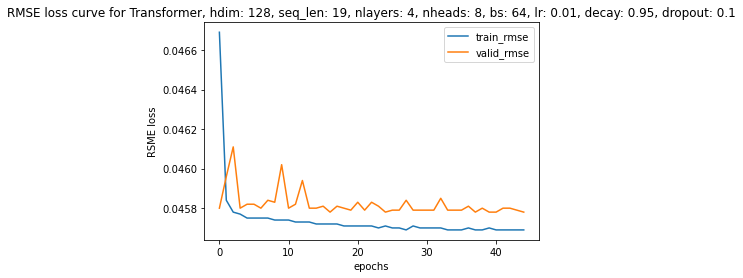

  6%|▌         | 160/2813 [00:38<05:32,  7.97it/s]


 11%|█         | 312/2813 [00:56<04:55,  8.46it/s]


 16%|█▋        | 464/2813 [01:29<04:54,  7.98it/s]


 22%|██▏       | 615/2813 [01:48<04:35,  7.96it/s]


 27%|██▋       | 769/2813 [02:07<04:09,  8.20it/s]


 33%|███▎      | 925/2813 [02:32<04:02,  7.80it/s]


 38%|███▊      | 1078/2813 [02:51<03:14,  8.93it/s]


 44%|████▎     | 1229/2813 [03:10<04:17,  6.16it/s]


 49%|████▉     | 1378/2813 [03:39<02:56,  8.13it/s]


 54%|█████▍    | 1527/2813 [03:58<02:53,  7.40it/s]


 60%|█████▉    | 1680/2813 [04:33<02:27,  7.71it/s]


 65%|██████▍   | 1828/2813 [04:52<02:09,  7.60it/s]


 70%|███████   | 1976/2813 [05:23<47:39,  3.42s/it]


 76%|███████▌  | 2124/2813 [05:44<01:31,  7.51it/s]


 81%|████████  | 2272/2813 [06:04<01:17,  6.95it/s]


 86%|████████▌ | 2420/2813 [06:30<00:54,  7.27it/s]


 91%|█████████▏| 2568/2813 [06:50<00:30,  7.97it/s]


 97%|█████████▋| 2716/2813 [07:08<00:11,  8.58it/s]


100%|██████████| 2813/2813 [07:29<00:00,  6.26it/s]


Epoch 46 | T: 8.05 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


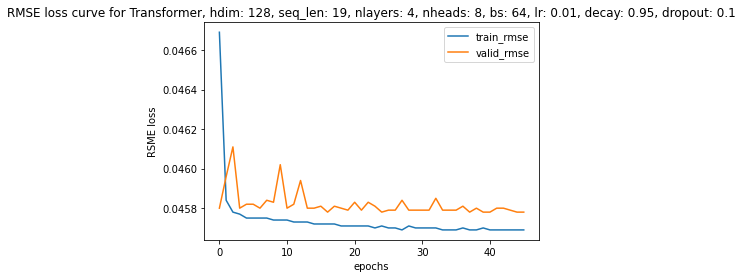

  5%|▌         | 151/2813 [00:31<05:36,  7.92it/s]


 11%|█         | 302/2813 [00:51<05:25,  7.72it/s]


 16%|█▌        | 453/2813 [01:33<04:59,  7.87it/s]


 21%|██▏       | 604/2813 [01:52<04:25,  8.33it/s]


 27%|██▋       | 756/2813 [02:19<05:23,  6.37it/s]


 32%|███▏      | 907/2813 [02:38<03:49,  8.30it/s]


 38%|███▊      | 1059/2813 [02:56<03:30,  8.33it/s]


 43%|████▎     | 1208/2813 [03:20<03:36,  7.42it/s]


 48%|████▊     | 1357/2813 [03:38<02:59,  8.13it/s]


 54%|█████▍    | 1515/2813 [03:56<02:26,  8.89it/s]


 59%|█████▉    | 1667/2813 [04:26<02:48,  6.79it/s]


 65%|██████▍   | 1815/2813 [04:45<02:20,  7.12it/s]


 70%|██████▉   | 1963/2813 [05:06<01:37,  8.76it/s]


 75%|███████▌  | 2111/2813 [05:40<01:51,  6.29it/s]


 80%|████████  | 2261/2813 [05:59<01:05,  8.39it/s]


 86%|████████▌ | 2409/2813 [06:30<00:49,  8.15it/s]


 91%|█████████ | 2557/2813 [06:49<00:31,  8.16it/s]


 96%|█████████▌| 2705/2813 [07:07<00:13,  8.21it/s]


100%|██████████| 2813/2813 [07:28<00:00,  6.27it/s]


Epoch 47 | T: 8.02 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


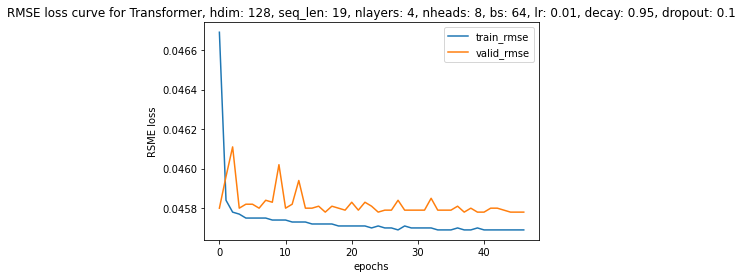

  5%|▌         | 152/2813 [00:30<05:41,  7.80it/s]


 11%|█         | 303/2813 [00:48<05:21,  7.80it/s]


 16%|█▌        | 454/2813 [01:07<05:02,  7.81it/s]


 22%|██▏       | 605/2813 [01:41<04:25,  8.31it/s]


 27%|██▋       | 756/2813 [02:00<04:14,  8.08it/s]


 32%|███▏      | 907/2813 [02:34<03:47,  8.36it/s]


 38%|███▊      | 1057/2813 [02:53<03:43,  7.85it/s]


 43%|████▎     | 1205/2813 [03:21<03:27,  7.75it/s]


 48%|████▊     | 1353/2813 [03:39<03:12,  7.57it/s]


 53%|█████▎    | 1502/2813 [03:57<02:35,  8.42it/s]


 59%|█████▊    | 1650/2813 [04:24<02:24,  8.06it/s]


 64%|██████▍   | 1799/2813 [04:42<02:09,  7.85it/s]


 69%|██████▉   | 1948/2813 [05:00<01:39,  8.69it/s]


 75%|███████▍  | 2096/2813 [05:30<01:30,  7.91it/s]


 80%|███████▉  | 2244/2813 [05:49<01:07,  8.47it/s]


 85%|████████▌ | 2392/2813 [06:07<00:58,  7.24it/s]


 90%|█████████ | 2540/2813 [06:37<00:34,  7.97it/s]


 96%|█████████▌| 2688/2813 [06:57<00:17,  7.21it/s]


100%|██████████| 2813/2813 [07:29<00:00,  6.26it/s]


Epoch 48 | T: 8.11 | Train RMSE: 0.04569 | Valid RMSE: 0.04579


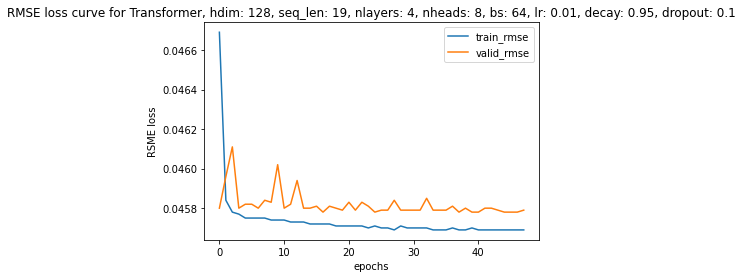

  6%|▌         | 155/2813 [00:28<05:56,  7.46it/s]


 11%|█         | 306/2813 [00:47<04:49,  8.67it/s]


 16%|█▌        | 457/2813 [01:15<05:12,  7.53it/s]


 22%|██▏       | 610/2813 [01:34<04:57,  7.41it/s]


 27%|██▋       | 761/2813 [01:52<04:14,  8.08it/s]


 32%|███▏      | 912/2813 [02:21<03:49,  8.29it/s]


 38%|███▊      | 1062/2813 [02:39<03:22,  8.65it/s]


 43%|████▎     | 1210/2813 [02:58<03:23,  7.87it/s]


 48%|████▊     | 1358/2813 [03:31<03:00,  8.07it/s]


 54%|█████▎    | 1506/2813 [03:50<02:50,  7.68it/s]


 59%|█████▉    | 1654/2813 [04:22<02:32,  7.60it/s]


 64%|██████▍   | 1802/2813 [04:41<02:04,  8.14it/s]


 69%|██████▉   | 1950/2813 [04:59<01:40,  8.59it/s]


 75%|███████▍  | 2098/2813 [05:25<01:26,  8.31it/s]


 80%|███████▉  | 2246/2813 [05:44<01:07,  8.43it/s]


 85%|████████▌ | 2394/2813 [06:03<00:47,  8.85it/s]


 90%|█████████ | 2542/2813 [06:31<00:33,  8.18it/s]


 96%|█████████▌| 2690/2813 [06:51<00:16,  7.53it/s]


100%|██████████| 2813/2813 [07:17<00:00,  6.43it/s]


Epoch 49 | T: 7.87 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


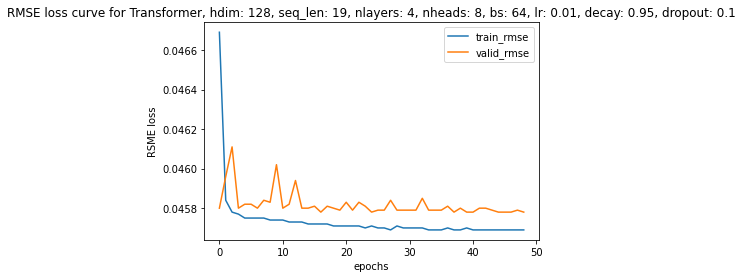

  5%|▌         | 151/2813 [00:34<06:29,  6.84it/s]


 11%|█         | 302/2813 [00:53<05:14,  7.98it/s]


 16%|█▌        | 454/2813 [01:27<2:56:22,  4.49s/it]


 22%|██▏       | 607/2813 [01:47<05:22,  6.84it/s]


 27%|██▋       | 758/2813 [02:07<04:22,  7.83it/s]


 32%|███▏      | 909/2813 [02:32<04:03,  7.82it/s]


 38%|███▊      | 1059/2813 [02:51<03:37,  8.07it/s]


 43%|████▎     | 1207/2813 [03:09<03:07,  8.56it/s]


 48%|████▊     | 1355/2813 [03:36<02:53,  8.38it/s]


 53%|█████▎    | 1503/2813 [03:54<02:39,  8.23it/s]


 59%|█████▊    | 1652/2813 [04:12<02:33,  7.57it/s]


 64%|██████▍   | 1800/2813 [04:43<02:08,  7.91it/s]


 69%|██████▉   | 1949/2813 [05:01<01:48,  7.98it/s]


 75%|███████▍  | 2097/2813 [05:37<01:24,  8.46it/s]


 80%|███████▉  | 2247/2813 [05:56<01:12,  7.81it/s]


 85%|████████▌ | 2398/2813 [06:22<13:52,  2.01s/it]


 91%|█████████ | 2546/2813 [06:40<00:31,  8.38it/s]


 96%|█████████▌| 2694/2813 [06:59<00:13,  8.58it/s]


100%|██████████| 2813/2813 [07:13<00:00,  6.49it/s]


Epoch 50 | T: 7.90 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


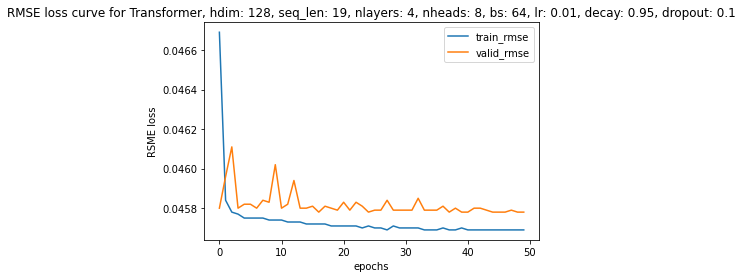

  6%|▌         | 158/2813 [00:18<04:52,  9.08it/s]


 11%|█         | 311/2813 [00:48<04:58,  8.39it/s]


 17%|█▋        | 465/2813 [01:07<04:42,  8.31it/s]


 22%|██▏       | 618/2813 [01:47<04:22,  8.37it/s]


 27%|██▋       | 769/2813 [02:06<04:12,  8.10it/s]


 33%|███▎      | 921/2813 [02:35<04:16,  7.39it/s]


 38%|███▊      | 1071/2813 [02:54<03:47,  7.66it/s]


 43%|████▎     | 1219/2813 [03:13<03:06,  8.53it/s]


 49%|████▊     | 1368/2813 [03:37<02:42,  8.92it/s]


 54%|█████▍    | 1516/2813 [03:55<02:30,  8.64it/s]


 59%|█████▉    | 1665/2813 [04:13<02:18,  8.27it/s]


 65%|██████▍   | 1816/2813 [04:41<02:20,  7.10it/s]


 70%|██████▉   | 1964/2813 [05:00<01:43,  8.23it/s]


 75%|███████▌  | 2113/2813 [05:20<01:40,  6.96it/s]


 80%|████████  | 2261/2813 [05:49<01:03,  8.68it/s]


 86%|████████▌ | 2410/2813 [06:06<00:45,  8.90it/s]


 91%|█████████ | 2562/2813 [06:41<00:32,  7.83it/s]


 96%|█████████▋| 2713/2813 [06:58<00:12,  8.27it/s]


100%|██████████| 2813/2813 [07:10<00:00,  6.54it/s]


Epoch 51 | T: 7.93 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


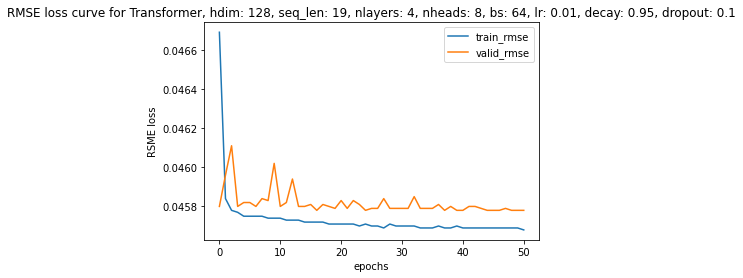

  5%|▌         | 152/2813 [00:20<06:37,  6.69it/s]


 11%|█         | 305/2813 [00:49<05:31,  7.56it/s]


 16%|█▌        | 457/2813 [01:09<05:01,  7.81it/s]


 22%|██▏       | 609/2813 [01:39<05:20,  6.88it/s]


 27%|██▋       | 760/2813 [01:59<04:07,  8.29it/s]


 32%|███▏      | 911/2813 [02:18<04:16,  7.43it/s]


 38%|███▊      | 1062/2813 [02:48<03:22,  8.63it/s]


 43%|████▎     | 1213/2813 [03:07<03:18,  8.07it/s]


 48%|████▊     | 1361/2813 [03:39<04:52,  4.96it/s]


 54%|█████▎    | 1509/2813 [03:58<02:40,  8.15it/s]


 59%|█████▉    | 1658/2813 [04:16<02:20,  8.25it/s]


 64%|██████▍   | 1806/2813 [04:43<02:03,  8.14it/s]


 69%|██████▉   | 1955/2813 [05:03<01:52,  7.66it/s]


 75%|███████▍  | 2104/2813 [05:22<01:19,  8.91it/s]


 80%|████████  | 2252/2813 [05:48<01:11,  7.90it/s]


 85%|████████▌ | 2400/2813 [06:07<00:49,  8.33it/s]


 91%|█████████ | 2548/2813 [06:37<00:51,  5.19it/s]


 96%|█████████▌| 2696/2813 [06:57<00:15,  7.75it/s]


100%|██████████| 2813/2813 [07:11<00:00,  6.52it/s]


Epoch 52 | T: 8.04 | Train RMSE: 0.04568 | Valid RMSE: 0.04579


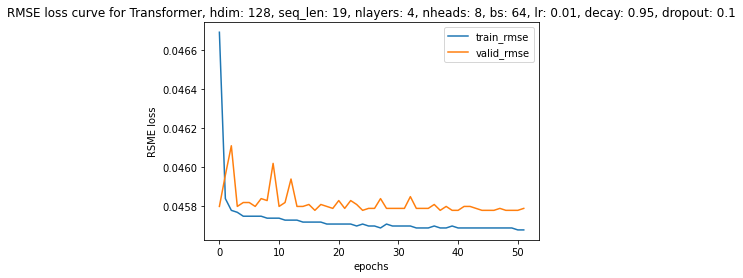

  5%|▌         | 153/2813 [00:18<05:19,  8.33it/s]


 11%|█         | 304/2813 [00:52<05:27,  7.66it/s]


 16%|█▌        | 457/2813 [01:10<04:51,  8.08it/s]


 22%|██▏       | 608/2813 [01:38<04:42,  7.81it/s]


 27%|██▋       | 760/2813 [01:57<04:26,  7.69it/s]


 32%|███▏      | 911/2813 [02:16<04:14,  7.46it/s]


 38%|███▊      | 1061/2813 [02:43<03:38,  8.01it/s]


 43%|████▎     | 1209/2813 [03:02<03:26,  7.76it/s]


 48%|████▊     | 1359/2813 [03:21<03:08,  7.70it/s]


 54%|█████▎    | 1507/2813 [03:51<02:50,  7.67it/s]


 59%|█████▉    | 1655/2813 [04:09<02:32,  7.57it/s]


 64%|██████▍   | 1804/2813 [04:45<02:00,  8.39it/s]


 69%|██████▉   | 1955/2813 [05:04<01:49,  7.84it/s]


 75%|███████▍  | 2103/2813 [05:24<01:34,  7.54it/s]


 80%|████████  | 2251/2813 [05:52<01:11,  7.86it/s]


 85%|████████▌ | 2400/2813 [06:11<00:49,  8.30it/s]


 91%|█████████ | 2548/2813 [06:36<00:34,  7.79it/s]


 96%|█████████▌| 2696/2813 [06:54<00:14,  7.98it/s]


100%|██████████| 2813/2813 [07:08<00:00,  6.56it/s]


Epoch 53 | T: 7.88 | Train RMSE: 0.04568 | Valid RMSE: 0.04579


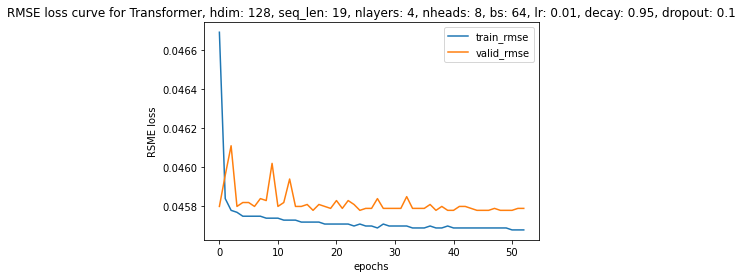

  5%|▌         | 151/2813 [00:18<05:27,  8.14it/s]


 11%|█         | 306/2813 [00:57<05:14,  7.98it/s]


 16%|█▌        | 457/2813 [01:16<04:56,  7.94it/s]


 22%|██▏       | 608/2813 [01:49<04:48,  7.65it/s]


 27%|██▋       | 759/2813 [02:08<04:18,  7.95it/s]


 32%|███▏      | 910/2813 [02:28<03:34,  8.89it/s]


 38%|███▊      | 1060/2813 [02:52<03:54,  7.46it/s]


 43%|████▎     | 1209/2813 [03:11<03:46,  7.09it/s]


 48%|████▊     | 1357/2813 [03:40<29:48,  1.23s/it]


 54%|█████▎    | 1505/2813 [04:00<02:40,  8.14it/s]


 59%|█████▉    | 1653/2813 [04:20<02:20,  8.23it/s]


 64%|██████▍   | 1801/2813 [04:50<02:29,  6.79it/s]


 69%|██████▉   | 1949/2813 [05:11<02:01,  7.09it/s]


 75%|███████▍  | 2099/2813 [05:31<01:30,  7.87it/s]


 80%|███████▉  | 2248/2813 [06:04<01:07,  8.38it/s]


 85%|████████▌ | 2399/2813 [06:23<00:54,  7.61it/s]


 91%|█████████ | 2553/2813 [06:51<00:33,  7.86it/s]


 96%|█████████▌| 2701/2813 [07:12<00:16,  6.96it/s]


100%|██████████| 2813/2813 [07:27<00:00,  6.28it/s]


Epoch 54 | T: 8.17 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


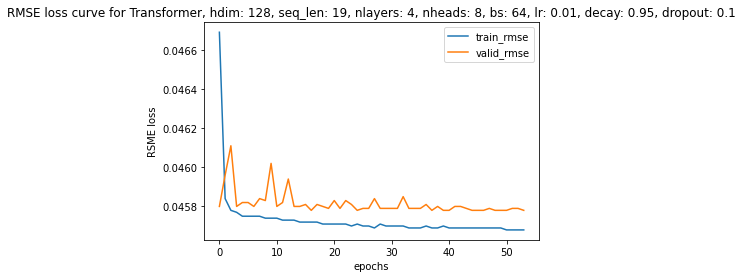

  5%|▌         | 151/2813 [00:19<05:39,  7.84it/s]


 11%|█         | 302/2813 [00:52<05:29,  7.62it/s]


 16%|█▌        | 453/2813 [01:12<05:10,  7.61it/s]


 21%|██▏       | 604/2813 [01:46<05:16,  6.97it/s]


 27%|██▋       | 755/2813 [02:06<04:15,  8.06it/s]


 32%|███▏      | 906/2813 [02:38<04:16,  7.42it/s]


 38%|███▊      | 1056/2813 [02:58<03:37,  8.06it/s]


 43%|████▎     | 1204/2813 [03:17<03:48,  7.04it/s]


 48%|████▊     | 1352/2813 [03:44<03:06,  7.84it/s]


 53%|█████▎    | 1500/2813 [04:05<02:56,  7.43it/s]


 59%|█████▊    | 1648/2813 [04:33<02:40,  7.25it/s]


 64%|██████▍   | 1796/2813 [04:52<02:11,  7.72it/s]


 69%|██████▉   | 1944/2813 [05:11<01:45,  8.24it/s]


 74%|███████▍  | 2092/2813 [05:39<01:37,  7.37it/s]


 80%|███████▉  | 2240/2813 [05:57<01:15,  7.63it/s]


 85%|████████▍ | 2388/2813 [06:15<00:49,  8.64it/s]


 90%|█████████ | 2536/2813 [06:47<00:34,  8.10it/s]


 95%|█████████▌| 2685/2813 [07:06<00:15,  8.11it/s]


100%|██████████| 2813/2813 [07:21<00:00,  6.37it/s]


Epoch 55 | T: 8.17 | Train RMSE: 0.04569 | Valid RMSE: 0.04579


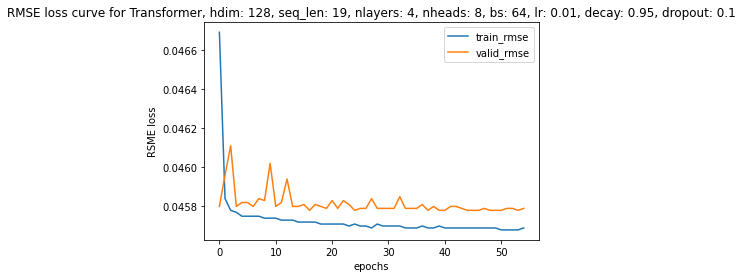

  5%|▌         | 151/2813 [00:28<05:28,  8.11it/s]


 11%|█         | 308/2813 [00:48<05:26,  7.68it/s]


 16%|█▋        | 461/2813 [01:06<04:19,  9.08it/s]


 22%|██▏       | 613/2813 [01:36<04:10,  8.78it/s]


 27%|██▋       | 765/2813 [01:55<04:07,  8.28it/s]


 33%|███▎      | 917/2813 [02:13<03:49,  8.25it/s]


 38%|███▊      | 1067/2813 [02:40<03:41,  7.88it/s]


 43%|████▎     | 1216/2813 [02:58<03:13,  8.26it/s]


 49%|████▉     | 1373/2813 [03:32<02:36,  9.18it/s]


 54%|█████▍    | 1524/2813 [03:49<02:30,  8.58it/s]


 60%|█████▉    | 1677/2813 [04:07<02:16,  8.31it/s]


 65%|██████▍   | 1827/2813 [04:36<02:01,  8.12it/s]


 70%|███████   | 1976/2813 [04:54<01:40,  8.29it/s]


 76%|███████▌  | 2126/2813 [05:12<01:22,  8.30it/s]


 81%|████████  | 2275/2813 [05:37<01:00,  8.92it/s]


 86%|████████▌ | 2423/2813 [05:55<00:47,  8.23it/s]


 92%|█████████▏| 2576/2813 [06:13<00:28,  8.42it/s]


 97%|█████████▋| 2726/2813 [06:40<00:09,  9.16it/s]


100%|██████████| 2813/2813 [06:50<00:00,  6.86it/s]


Epoch 56 | T: 7.63 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


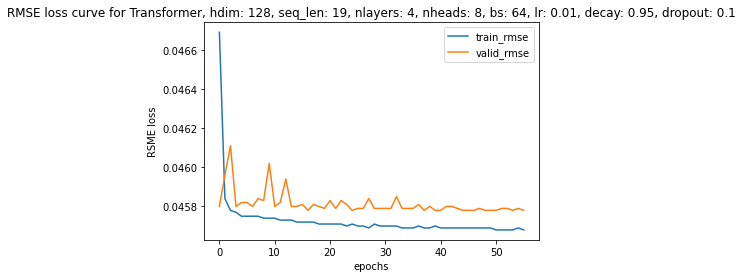

  6%|▌         | 156/2813 [00:18<05:26,  8.13it/s]


 11%|█         | 311/2813 [00:36<04:43,  8.84it/s]


 16%|█▋        | 462/2813 [01:16<04:33,  8.59it/s]


 22%|██▏       | 615/2813 [01:35<04:44,  7.72it/s]


 27%|██▋       | 766/2813 [02:04<04:00,  8.52it/s]


 33%|███▎      | 917/2813 [02:24<04:31,  6.97it/s]


 38%|███▊      | 1068/2813 [02:50<04:00,  7.26it/s]


 43%|████▎     | 1216/2813 [03:10<03:28,  7.66it/s]


 49%|████▊     | 1369/2813 [03:31<03:08,  7.66it/s]


 54%|█████▍    | 1525/2813 [03:59<03:04,  6.99it/s]


 60%|█████▉    | 1674/2813 [04:18<02:27,  7.72it/s]


 65%|██████▍   | 1823/2813 [04:52<1:14:25,  4.51s/it]


 70%|███████   | 1971/2813 [05:11<01:49,  7.68it/s]


 75%|███████▌  | 2122/2813 [05:29<01:20,  8.62it/s]


 81%|████████  | 2270/2813 [06:00<01:05,  8.29it/s]


 86%|████████▌ | 2418/2813 [06:19<00:51,  7.61it/s]


 91%|█████████ | 2566/2813 [06:37<00:30,  8.01it/s]


 96%|█████████▋| 2714/2813 [07:04<00:12,  7.93it/s]


100%|██████████| 2813/2813 [07:16<00:00,  6.45it/s]


Epoch 57 | T: 7.98 | Train RMSE: 0.04568 | Valid RMSE: 0.04579


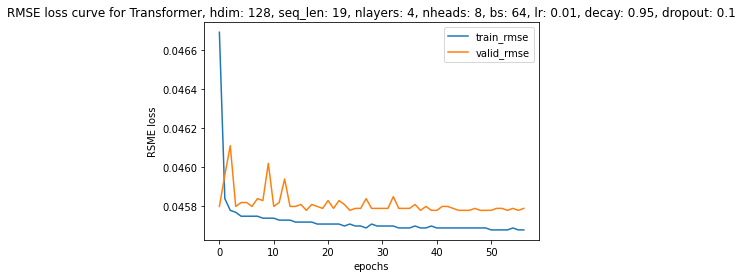

  5%|▌         | 152/2813 [00:17<05:06,  8.69it/s]


 11%|█         | 315/2813 [00:36<04:47,  8.70it/s]


 17%|█▋        | 473/2813 [01:11<04:54,  7.94it/s]


 22%|██▏       | 625/2813 [01:28<04:09,  8.76it/s]


 28%|██▊       | 779/2813 [02:07<03:53,  8.70it/s]


 33%|███▎      | 930/2813 [02:25<03:40,  8.52it/s]


 38%|███▊      | 1083/2813 [02:51<03:43,  7.75it/s]


 44%|████▍     | 1232/2813 [03:10<03:11,  8.26it/s]


 49%|████▉     | 1380/2813 [03:28<02:43,  8.78it/s]


 54%|█████▍    | 1528/2813 [03:52<02:32,  8.44it/s]


 60%|█████▉    | 1678/2813 [04:10<02:15,  8.37it/s]


 65%|██████▌   | 1831/2813 [04:27<01:48,  9.03it/s]


 70%|███████   | 1980/2813 [04:56<01:39,  8.35it/s]


 76%|███████▌  | 2131/2813 [05:14<01:16,  8.89it/s]


 81%|████████  | 2283/2813 [05:31<00:57,  9.21it/s]


 87%|████████▋ | 2435/2813 [06:07<00:42,  8.96it/s]


 92%|█████████▏| 2593/2813 [06:25<00:24,  8.94it/s]


 98%|█████████▊| 2746/2813 [06:55<00:08,  7.60it/s]


100%|██████████| 2813/2813 [07:02<00:00,  6.66it/s]


Epoch 58 | T: 7.57 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


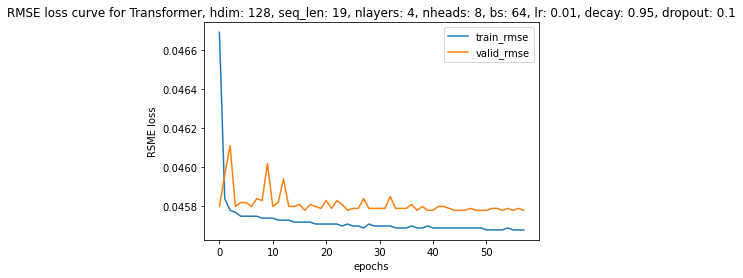

  5%|▌         | 154/2813 [00:26<05:40,  7.80it/s]


 11%|█         | 311/2813 [00:45<04:43,  8.84it/s]


 16%|█▋        | 463/2813 [01:03<04:42,  8.32it/s]


 22%|██▏       | 616/2813 [01:36<04:20,  8.44it/s]


 27%|██▋       | 767/2813 [01:54<03:48,  8.96it/s]


 33%|███▎      | 918/2813 [02:22<04:10,  7.55it/s]


 38%|███▊      | 1068/2813 [02:41<04:06,  7.08it/s]


 43%|████▎     | 1218/2813 [03:01<03:47,  7.01it/s]


 49%|████▊     | 1366/2813 [03:35<03:06,  7.78it/s]


 54%|█████▍    | 1514/2813 [03:55<02:34,  8.39it/s]


 59%|█████▉    | 1662/2813 [04:25<02:48,  6.81it/s]


 64%|██████▍   | 1812/2813 [04:44<01:56,  8.56it/s]


 70%|███████   | 1970/2813 [05:05<01:44,  8.05it/s]


 75%|███████▌  | 2119/2813 [05:31<01:29,  7.74it/s]


 81%|████████  | 2273/2813 [05:51<01:11,  7.60it/s]


 86%|████████▌ | 2425/2813 [06:19<00:51,  7.46it/s]


 92%|█████████▏| 2574/2813 [06:39<00:29,  7.98it/s]


 97%|█████████▋| 2727/2813 [06:59<00:10,  7.88it/s]


100%|██████████| 2813/2813 [07:20<00:00,  6.38it/s]


Epoch 59 | T: 7.96 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


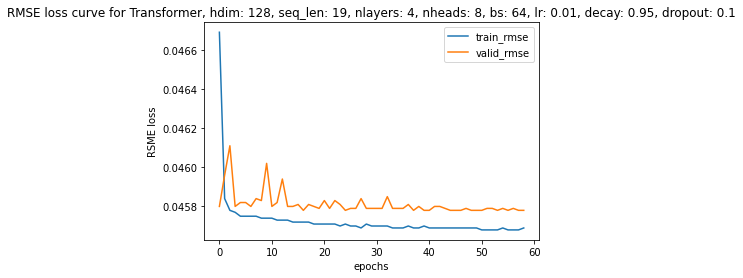

  6%|▌         | 155/2813 [00:35<05:36,  7.90it/s]


 11%|█         | 308/2813 [00:54<05:17,  7.89it/s]


 17%|█▋        | 469/2813 [01:26<04:51,  8.05it/s]


 22%|██▏       | 623/2813 [01:46<04:57,  7.37it/s]


 28%|██▊       | 774/2813 [02:06<04:23,  7.74it/s]


 33%|███▎      | 925/2813 [02:33<04:32,  6.94it/s]


 38%|███▊      | 1075/2813 [02:53<04:16,  6.78it/s]


 44%|████▎     | 1224/2813 [03:20<03:32,  7.48it/s]


 49%|████▉     | 1372/2813 [03:39<03:25,  7.01it/s]


 54%|█████▍    | 1520/2813 [03:59<02:47,  7.73it/s]


 60%|█████▉    | 1685/2813 [04:33<01:59,  9.42it/s]


 65%|██████▌   | 1840/2813 [04:51<02:01,  8.03it/s]


 71%|███████   | 1989/2813 [05:22<25:37,  1.87s/it]


 76%|███████▌  | 2144/2813 [05:42<01:24,  7.90it/s]


 82%|████████▏ | 2295/2813 [06:02<01:08,  7.58it/s]


 87%|████████▋ | 2444/2813 [06:30<00:52,  6.97it/s]


 92%|█████████▏| 2592/2813 [06:50<00:29,  7.60it/s]


 98%|█████████▊| 2746/2813 [07:10<00:06,  9.67it/s]


100%|██████████| 2813/2813 [07:26<00:00,  6.30it/s]


Epoch 60 | T: 8.07 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


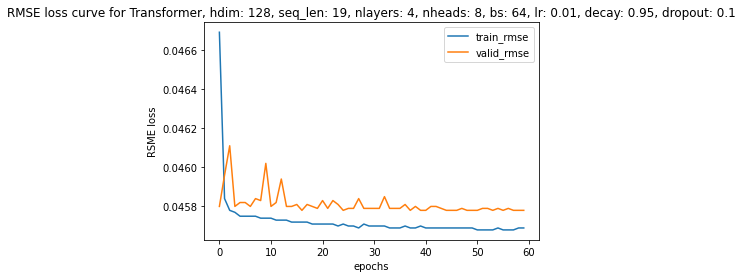

  5%|▌         | 152/2813 [00:29<06:30,  6.82it/s]


 11%|█         | 303/2813 [00:48<04:59,  8.39it/s]


 16%|█▌        | 454/2813 [01:29<1:36:44,  2.46s/it]


 22%|██▏       | 605/2813 [01:48<04:25,  8.33it/s]


 27%|██▋       | 756/2813 [02:17<1:52:20,  3.28s/it]


 32%|███▏      | 907/2813 [02:37<03:46,  8.43it/s]


 38%|███▊      | 1058/2813 [02:55<03:40,  7.97it/s]


 43%|████▎     | 1206/2813 [03:19<03:18,  8.08it/s]


 48%|████▊     | 1354/2813 [03:38<03:00,  8.07it/s]


 53%|█████▎    | 1502/2813 [03:57<02:31,  8.65it/s]


 59%|█████▊    | 1651/2813 [04:25<02:34,  7.52it/s]


 64%|██████▍   | 1799/2813 [04:44<02:02,  8.26it/s]


 69%|██████▉   | 1947/2813 [05:02<01:49,  7.87it/s]


 74%|███████▍  | 2095/2813 [05:33<01:25,  8.44it/s]


 80%|███████▉  | 2243/2813 [05:51<01:15,  7.55it/s]


 85%|████████▍ | 2391/2813 [06:27<00:57,  7.32it/s]


 90%|█████████ | 2539/2813 [06:45<00:33,  8.17it/s]


 96%|█████████▌| 2688/2813 [07:03<00:15,  8.24it/s]


100%|██████████| 2813/2813 [07:27<00:00,  6.28it/s]


Epoch 61 | T: 7.99 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


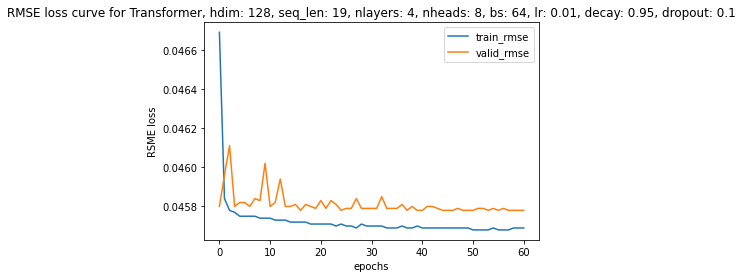

  6%|▌         | 155/2813 [00:26<05:25,  8.18it/s]


 11%|█         | 306/2813 [00:44<04:46,  8.74it/s]


 16%|█▌        | 457/2813 [01:02<04:35,  8.56it/s]


 22%|██▏       | 609/2813 [01:36<04:19,  8.50it/s]


 27%|██▋       | 760/2813 [01:55<04:15,  8.03it/s]


 32%|███▏      | 911/2813 [02:31<04:13,  7.51it/s]


 38%|███▊      | 1061/2813 [02:50<03:43,  7.84it/s]


 43%|████▎     | 1209/2813 [03:08<03:09,  8.47it/s]


 48%|████▊     | 1357/2813 [03:35<03:04,  7.87it/s]


 54%|█████▎    | 1505/2813 [03:54<02:37,  8.30it/s]


 59%|█████▉    | 1653/2813 [04:20<02:28,  7.82it/s]


 64%|██████▍   | 1803/2813 [04:39<01:54,  8.85it/s]


 69%|██████▉   | 1951/2813 [04:57<01:39,  8.70it/s]


 75%|███████▍  | 2099/2813 [05:26<01:32,  7.69it/s]


 80%|███████▉  | 2247/2813 [05:46<01:23,  6.80it/s]


 85%|████████▌ | 2395/2813 [06:06<00:54,  7.67it/s]


 90%|█████████ | 2543/2813 [06:35<00:37,  7.13it/s]


 96%|█████████▌| 2696/2813 [06:54<00:13,  8.37it/s]


100%|██████████| 2813/2813 [07:23<00:00,  6.34it/s]


Epoch 62 | T: 7.95 | Train RMSE: 0.04568 | Valid RMSE: 0.04579


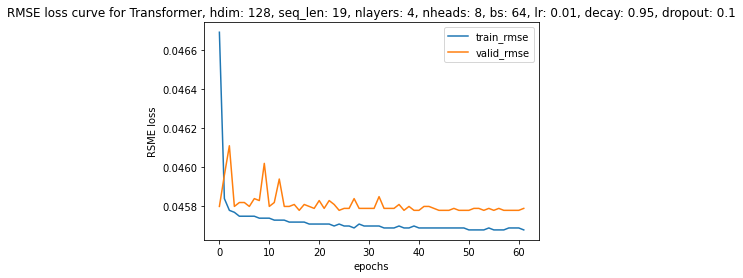

  6%|▌         | 155/2813 [00:31<06:36,  6.70it/s]


 11%|█         | 307/2813 [00:51<05:32,  7.54it/s]


 16%|█▋        | 458/2813 [01:10<05:28,  7.16it/s]


 22%|██▏       | 609/2813 [01:41<04:16,  8.60it/s]


 27%|██▋       | 761/2813 [02:01<04:28,  7.64it/s]


 32%|███▏      | 912/2813 [02:29<04:07,  7.68it/s]


 38%|███▊      | 1063/2813 [02:49<03:35,  8.12it/s]


 43%|████▎     | 1211/2813 [03:08<03:34,  7.46it/s]


 48%|████▊     | 1359/2813 [03:39<02:45,  8.80it/s]


 54%|█████▍    | 1512/2813 [03:57<02:26,  8.85it/s]


 59%|█████▉    | 1667/2813 [04:30<02:32,  7.51it/s]


 65%|██████▍   | 1817/2813 [04:48<01:55,  8.61it/s]


 70%|██████▉   | 1969/2813 [05:05<01:40,  8.36it/s]


 75%|███████▌  | 2118/2813 [05:32<01:19,  8.79it/s]


 81%|████████  | 2267/2813 [05:49<01:02,  8.79it/s]


 86%|████████▌ | 2419/2813 [06:07<00:44,  8.87it/s]


 91%|█████████▏| 2567/2813 [06:33<00:30,  8.19it/s]


 97%|█████████▋| 2718/2813 [06:50<00:10,  8.83it/s]


100%|██████████| 2813/2813 [07:01<00:00,  6.68it/s]


Epoch 63 | T: 7.75 | Train RMSE: 0.04568 | Valid RMSE: 0.04579


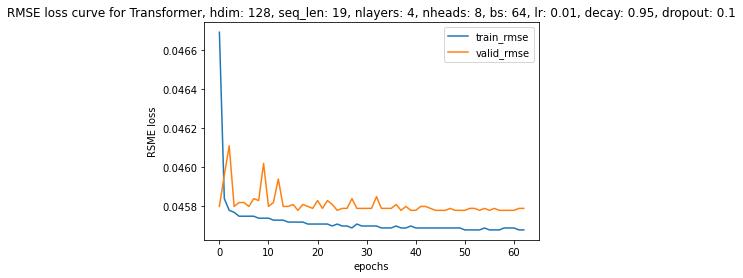

  6%|▌         | 163/2813 [00:17<04:37,  9.55it/s]


 11%|█▏        | 321/2813 [01:00<04:53,  8.49it/s]


 17%|█▋        | 473/2813 [01:18<04:32,  8.58it/s]


 22%|██▏       | 625/2813 [01:49<04:19,  8.45it/s]


 28%|██▊       | 776/2813 [02:07<03:57,  8.58it/s]


 33%|███▎      | 927/2813 [02:25<03:32,  8.88it/s]


 38%|███▊      | 1077/2813 [02:47<03:35,  8.07it/s]


 44%|████▎     | 1226/2813 [03:05<03:04,  8.60it/s]


 49%|████▉     | 1375/2813 [03:23<02:45,  8.70it/s]


 54%|█████▍    | 1524/2813 [03:51<02:29,  8.64it/s]


 60%|█████▉    | 1675/2813 [04:08<02:10,  8.71it/s]


 65%|██████▍   | 1825/2813 [04:26<01:55,  8.54it/s]


 70%|███████   | 1975/2813 [05:01<01:44,  8.02it/s]


 76%|███████▌  | 2127/2813 [05:18<01:16,  8.99it/s]


 81%|████████  | 2282/2813 [05:50<00:59,  8.98it/s]


 86%|████████▋ | 2433/2813 [06:07<00:44,  8.54it/s]


 92%|█████████▏| 2589/2813 [06:25<00:25,  8.67it/s]


 97%|█████████▋| 2739/2813 [06:51<00:10,  7.00it/s]


100%|██████████| 2813/2813 [07:01<00:00,  6.68it/s]


Epoch 64 | T: 7.71 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


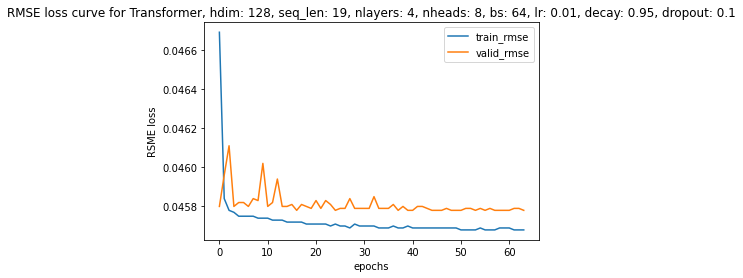

  6%|▌         | 158/2813 [00:18<04:55,  8.99it/s]


 11%|█▏        | 321/2813 [00:36<04:22,  9.51it/s]


 17%|█▋        | 481/2813 [01:12<04:34,  8.49it/s]


 23%|██▎       | 635/2813 [01:31<04:06,  8.83it/s]


 28%|██▊       | 787/2813 [02:08<04:11,  8.06it/s]


 33%|███▎      | 939/2813 [02:27<03:42,  8.42it/s]


 39%|███▊      | 1090/2813 [02:46<03:23,  8.48it/s]


 44%|████▍     | 1239/2813 [03:11<02:58,  8.80it/s]


 49%|████▉     | 1387/2813 [03:30<02:48,  8.45it/s]


 55%|█████▍    | 1535/2813 [03:55<03:10,  6.69it/s]


 60%|█████▉    | 1683/2813 [04:14<02:27,  7.68it/s]


 65%|██████▌   | 1832/2813 [04:31<01:51,  8.82it/s]


 71%|███████   | 1984/2813 [04:59<01:43,  8.01it/s]


 76%|███████▌  | 2132/2813 [05:18<01:27,  7.78it/s]


 81%|████████  | 2281/2813 [05:37<01:11,  7.47it/s]


 86%|████████▋ | 2431/2813 [06:11<00:52,  7.32it/s]


 92%|█████████▏| 2581/2813 [06:31<00:29,  7.83it/s]


 97%|█████████▋| 2734/2813 [07:02<00:13,  6.03it/s]


100%|██████████| 2813/2813 [07:12<00:00,  6.50it/s]


Epoch 65 | T: 7.78 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


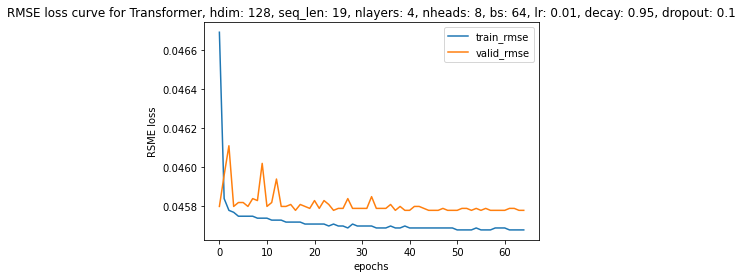

  6%|▌         | 155/2813 [00:27<05:30,  8.05it/s]


 11%|█         | 309/2813 [00:46<04:43,  8.83it/s]


 16%|█▋        | 463/2813 [01:17<05:00,  7.82it/s]


 22%|██▏       | 618/2813 [01:35<04:03,  9.00it/s]


 28%|██▊       | 776/2813 [01:53<03:41,  9.19it/s]


 33%|███▎      | 930/2813 [02:22<03:38,  8.63it/s]


 39%|███▉      | 1091/2813 [02:40<03:31,  8.14it/s]


 44%|████▍     | 1240/2813 [02:58<03:20,  7.85it/s]


 49%|████▉     | 1390/2813 [03:22<02:43,  8.68it/s]


 55%|█████▍    | 1538/2813 [03:41<02:45,  7.72it/s]


 60%|█████▉    | 1686/2813 [03:59<02:15,  8.30it/s]


 65%|██████▌   | 1836/2813 [04:18<02:07,  7.65it/s]


 71%|███████   | 1984/2813 [04:39<01:50,  7.54it/s]


 76%|███████▌  | 2132/2813 [04:58<01:30,  7.53it/s]


 81%|████████  | 2280/2813 [05:17<01:21,  6.52it/s]


 86%|████████▋ | 2428/2813 [05:38<01:01,  6.28it/s]


 92%|█████████▏| 2576/2813 [05:59<00:35,  6.71it/s]


 97%|█████████▋| 2724/2813 [06:19<00:12,  7.30it/s]


100%|██████████| 2813/2813 [06:31<00:00,  7.19it/s]


Epoch 66 | T: 7.06 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


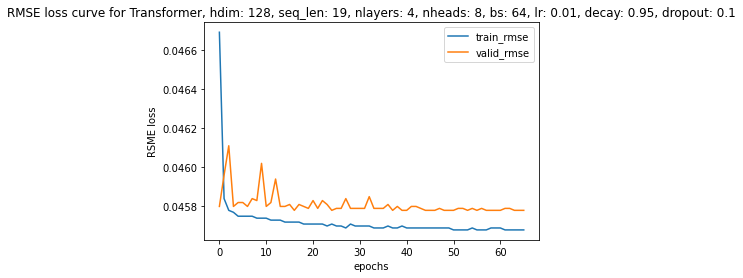

  5%|▌         | 151/2813 [00:18<04:55,  9.02it/s]


 11%|█         | 306/2813 [00:36<05:18,  7.87it/s]


 16%|█▋        | 458/2813 [00:55<04:44,  8.28it/s]


 22%|██▏       | 610/2813 [01:17<04:22,  8.38it/s]


 27%|██▋       | 761/2813 [01:35<04:07,  8.29it/s]


 32%|███▏      | 913/2813 [01:53<03:46,  8.37it/s]


 38%|███▊      | 1063/2813 [02:14<03:52,  7.53it/s]


 43%|████▎     | 1211/2813 [02:34<03:45,  7.11it/s]


 48%|████▊     | 1359/2813 [02:53<02:55,  8.29it/s]


 54%|█████▎    | 1509/2813 [03:13<02:54,  7.48it/s]


 59%|█████▉    | 1657/2813 [03:32<02:51,  6.75it/s]


 64%|██████▍   | 1805/2813 [03:51<02:21,  7.14it/s]


 69%|██████▉   | 1954/2813 [04:11<01:52,  7.64it/s]


 75%|███████▍  | 2102/2813 [04:30<01:29,  7.90it/s]


 80%|███████▉  | 2250/2813 [04:50<01:15,  7.43it/s]


 85%|████████▌ | 2398/2813 [05:12<00:55,  7.45it/s]


 91%|█████████ | 2546/2813 [05:32<00:31,  8.56it/s]


 96%|█████████▌| 2694/2813 [05:50<00:14,  8.03it/s]


100%|██████████| 2813/2813 [06:06<00:00,  7.68it/s]


Epoch 67 | T: 6.67 | Train RMSE: 0.04568 | Valid RMSE: 0.04579


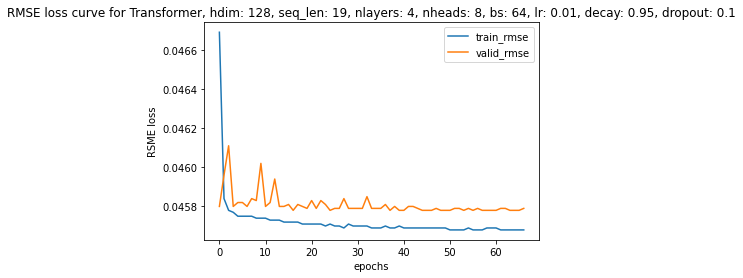

  5%|▌         | 152/2813 [00:18<05:03,  8.78it/s]


 11%|█         | 303/2813 [00:38<05:37,  7.43it/s]


 16%|█▌        | 454/2813 [00:58<04:54,  8.01it/s]


 22%|██▏       | 605/2813 [01:18<04:58,  7.41it/s]


 27%|██▋       | 756/2813 [01:38<03:50,  8.93it/s]


 32%|███▏      | 908/2813 [01:57<04:44,  6.69it/s]


 38%|███▊      | 1059/2813 [02:16<03:08,  9.32it/s]


 43%|████▎     | 1207/2813 [02:35<03:54,  6.86it/s]


 48%|████▊     | 1355/2813 [02:55<03:39,  6.65it/s]


 53%|█████▎    | 1503/2813 [03:14<02:48,  7.77it/s]


 59%|█████▊    | 1651/2813 [03:34<02:46,  6.96it/s]


 64%|██████▍   | 1799/2813 [03:53<02:06,  8.04it/s]


 69%|██████▉   | 1947/2813 [04:13<01:53,  7.64it/s]


 74%|███████▍  | 2095/2813 [04:36<01:44,  6.84it/s]


 80%|███████▉  | 2243/2813 [04:58<01:19,  7.16it/s]


 85%|████████▍ | 2391/2813 [05:19<01:30,  4.67it/s]


 90%|█████████ | 2539/2813 [05:43<00:42,  6.52it/s]


 96%|█████████▌| 2687/2813 [06:04<00:19,  6.50it/s]


100%|██████████| 2813/2813 [06:22<00:00,  7.35it/s]


Epoch 68 | T: 6.94 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


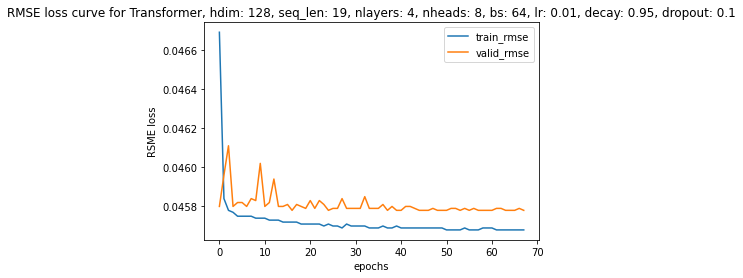

  5%|▌         | 153/2813 [00:18<05:28,  8.09it/s]


 11%|█         | 304/2813 [00:37<05:30,  7.59it/s]


 16%|█▌        | 455/2813 [00:56<05:01,  7.81it/s]


 22%|██▏       | 606/2813 [01:15<06:16,  5.85it/s]


 27%|██▋       | 757/2813 [01:36<04:18,  7.95it/s]


 32%|███▏      | 893/2813 [01:53<03:44,  8.55it/s]
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 92%|█████████▏| 2580/2813 [05:32<00:27,  8.40it/s]


 97%|█████████▋| 2728/2813 [05:52<00:09,  8.92it/s]


100%|██████████| 2813/2813 [06:02<00:00,  7.75it/s]


Epoch 69 | T: 6.60 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


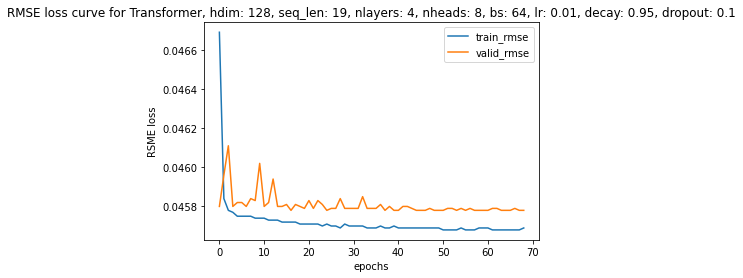

  5%|▌         | 152/2813 [00:18<04:41,  9.46it/s]


 11%|█         | 303/2813 [00:36<05:01,  8.32it/s]


 16%|█▌        | 454/2813 [00:57<04:51,  8.10it/s]


 22%|██▏       | 605/2813 [01:18<05:17,  6.96it/s]


 27%|██▋       | 756/2813 [01:38<04:11,  8.18it/s]


 27%|██▋       | 757/2813 [01:38<04:06,  8.35it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

 87%|████████▋ | 2453/2813 [05:16<00:47,  7.51it/s]


 92%|█████████▏| 2601/2813 [05:35<00:25,  8.38it/s]


 98%|█████████▊| 2749/2813 [05:54<00:07,  8.00it/s]


100%|██████████| 2813/2813 [06:02<00:00,  7.77it/s]


Epoch 70 | T: 6.57 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


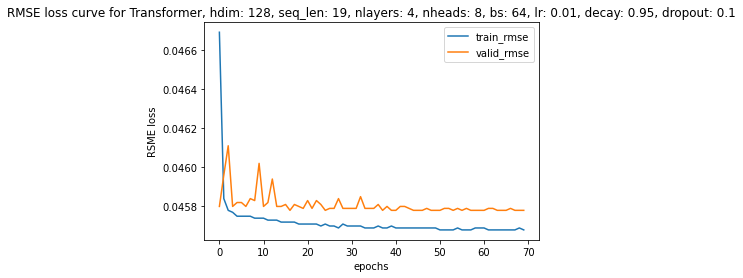

  6%|▌         | 159/2813 [00:18<05:07,  8.63it/s]


 11%|█         | 310/2813 [00:36<04:40,  8.93it/s]


 16%|█▋        | 461/2813 [00:54<04:41,  8.37it/s]


 18%|█▊        | 506/2813 [01:00<05:11,  7.42it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


 56%|█████▌    | 1579/2813 [03:15<03:09,  6.51it/s]


 61%|██████▏   | 1727/2813 [03:34<02:13,  8.13it/s]


 67%|██████▋   | 1875/2813 [03:53<01:57,  7.99it/s]


 67%|██████▋   | 1881/2813 [03:53<01:52,  8.25it/s]

 81%|████████  | 2283/2813 [04:47<01:05,  8.04it/s]


 87%|████████▋ | 2434/2813 [05:06<00:41,  9.22it/s]


 92%|█████████▏| 2582/2813 [05:25<00:28,  8.08it/s]


 97%|█████████▋| 2730/2813 [05:44<00:10,  8.00it/s]


100%|██████████| 2813/2813 [05:55<00:00,  7.92it/s]


Epoch 71 | T: 6.46 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


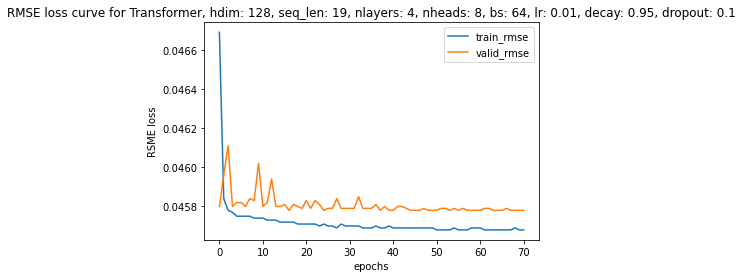

  5%|▌         | 153/2813 [00:18<05:26,  8.15it/s]


 11%|█         | 308/2813 [00:36<04:47,  8.72it/s]


 16%|█▋        | 459/2813 [00:57<04:49,  8.13it/s]


 22%|██▏       | 610/2813 [01:16<05:29,  6.69it/s]


 27%|██▋       | 765/2813 [01:35<04:43,  7.22it/s]


 33%|███▎      | 918/2813 [01:56<04:18,  7.33it/s]


 38%|███▊      | 1068/2813 [02:14<03:38,  7.97it/s]


 43%|████▎     | 1217/2813 [02:33<03:43,  7.13it/s]


 49%|████▊     | 1366/2813 [02:52<02:54,  8.27it/s]


 54%|█████▍    | 1514/2813 [03:11<02:56,  7.37it/s]


 59%|█████▉    | 1665/2813 [03:29<02:14,  8.56it/s]


 64%|██████▍   | 1813/2813 [03:49<02:18,  7.23it/s]


 70%|██████▉   | 1961/2813 [04:08<01:40,  8.48it/s]


 75%|███████▌  | 2112/2813 [04:27<01:18,  8.93it/s]


 80%|████████  | 2260/2813 [04:46<01:03,  8.74it/s]


 86%|████████▌ | 2412/2813 [05:05<00:50,  7.94it/s]


 91%|█████████ | 2560/2813 [05:25<00:33,  7.59it/s]


 96%|█████████▋| 2708/2813 [05:43<00:12,  8.70it/s]


100%|██████████| 2813/2813 [05:57<00:00,  7.88it/s]


Epoch 72 | T: 6.49 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


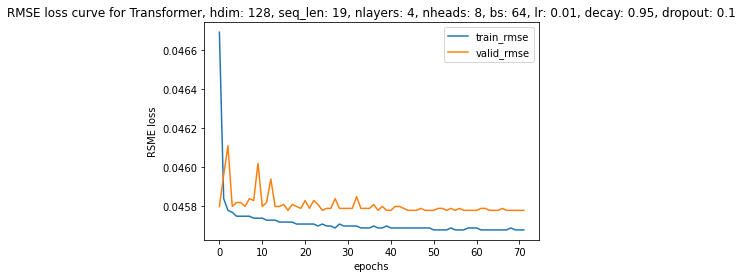

  5%|▌         | 153/2813 [00:18<05:20,  8.29it/s]


 11%|█         | 304/2813 [00:38<05:22,  7.77it/s]


 16%|█▌        | 456/2813 [00:56<04:40,  8.42it/s]


 22%|██▏       | 608/2813 [01:15<04:45,  7.73it/s]


 27%|██▋       | 760/2813 [01:34<04:25,  7.72it/s]


 32%|███▏      | 913/2813 [01:53<04:01,  7.87it/s]


 38%|███▊      | 1064/2813 [02:12<04:08,  7.05it/s]


 43%|████▎     | 1212/2813 [02:31<03:11,  8.37it/s]


 48%|████▊     | 1360/2813 [02:49<02:57,  8.18it/s]


 54%|█████▎    | 1508/2813 [03:08<02:33,  8.51it/s]


 59%|█████▉    | 1657/2813 [03:26<02:16,  8.47it/s]


 64%|██████▍   | 1805/2813 [03:45<02:17,  7.36it/s]


 69%|██████▉   | 1953/2813 [04:04<01:43,  8.30it/s]


 75%|███████▍  | 2104/2813 [04:24<01:30,  7.81it/s]


 80%|████████  | 2252/2813 [04:43<01:13,  7.61it/s]


 85%|████████▌ | 2400/2813 [05:01<00:54,  7.54it/s]


 91%|█████████ | 2549/2813 [05:21<00:31,  8.34it/s]


 96%|█████████▌| 2697/2813 [05:40<00:15,  7.37it/s]


100%|██████████| 2813/2813 [05:54<00:00,  7.93it/s]


Epoch 73 | T: 6.48 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


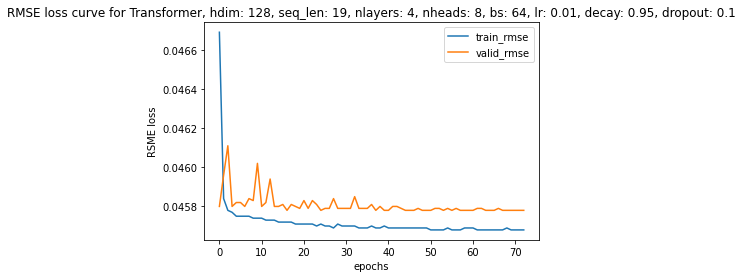

  5%|▌         | 154/2813 [00:19<05:54,  7.51it/s]


 11%|█         | 308/2813 [00:38<05:01,  8.32it/s]


 16%|█▋        | 459/2813 [00:59<04:46,  8.23it/s]


 22%|██▏       | 612/2813 [01:18<04:46,  7.67it/s]


 27%|██▋       | 765/2813 [01:36<04:07,  8.27it/s]


 33%|███▎      | 916/2813 [01:56<04:08,  7.62it/s]


 38%|███▊      | 1066/2813 [02:14<03:38,  7.99it/s]


 43%|████▎     | 1218/2813 [02:33<03:20,  7.94it/s]


 49%|████▊     | 1368/2813 [02:53<02:55,  8.25it/s]


 54%|█████▍    | 1517/2813 [03:11<02:30,  8.59it/s]


 59%|█████▉    | 1665/2813 [03:30<02:35,  7.37it/s]


 64%|██████▍   | 1814/2813 [03:48<01:51,  8.94it/s]


 70%|██████▉   | 1962/2813 [04:07<01:46,  7.98it/s]


 75%|███████▌  | 2110/2813 [04:26<01:20,  8.76it/s]


 80%|████████  | 2259/2813 [04:44<01:10,  7.88it/s]


 86%|████████▌ | 2407/2813 [05:03<00:45,  8.89it/s]


 91%|█████████ | 2556/2813 [05:23<00:33,  7.61it/s]


 96%|█████████▌| 2704/2813 [05:42<00:13,  8.22it/s]


100%|██████████| 2813/2813 [05:57<00:00,  7.87it/s]


Epoch 74 | T: 6.50 | Train RMSE: 0.04568 | Valid RMSE: 0.04579


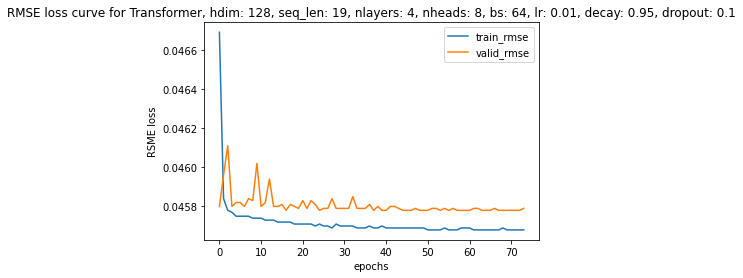

  6%|▌         | 159/2813 [00:18<05:45,  7.67it/s]


 11%|█         | 310/2813 [00:39<06:21,  6.56it/s]


 16%|█▋        | 462/2813 [00:59<05:01,  7.80it/s]


 22%|██▏       | 614/2813 [01:18<05:12,  7.03it/s]


 27%|██▋       | 766/2813 [01:38<04:40,  7.30it/s]


 33%|███▎      | 917/2813 [01:58<04:08,  7.64it/s]


 38%|███▊      | 1067/2813 [02:17<04:00,  7.27it/s]


 43%|████▎     | 1215/2813 [02:37<03:40,  7.25it/s]


 48%|████▊     | 1363/2813 [02:55<02:52,  8.40it/s]


 54%|█████▍    | 1512/2813 [03:14<02:26,  8.89it/s]


 59%|█████▉    | 1663/2813 [03:33<02:33,  7.50it/s]


 64%|██████▍   | 1811/2813 [03:51<02:00,  8.31it/s]


 70%|██████▉   | 1959/2813 [04:10<02:00,  7.07it/s]


 75%|███████▍  | 2108/2813 [04:30<01:36,  7.28it/s]


 80%|████████  | 2256/2813 [04:49<01:21,  6.79it/s]


 85%|████████▌ | 2404/2813 [05:08<00:45,  8.90it/s]


 91%|█████████ | 2552/2813 [05:28<00:32,  8.00it/s]


 96%|█████████▌| 2700/2813 [05:47<00:15,  7.41it/s]


100%|██████████| 2813/2813 [06:01<00:00,  7.77it/s]


Epoch 75 | T: 6.58 | Train RMSE: 0.04568 | Valid RMSE: 0.04579


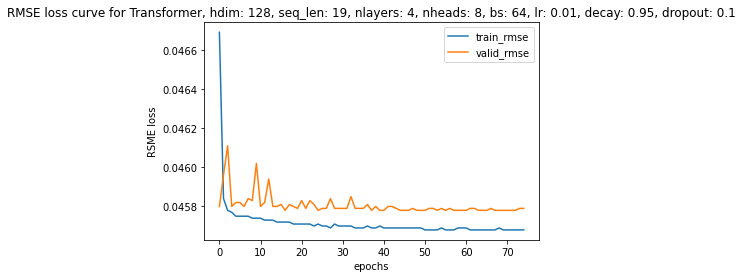

  5%|▌         | 154/2813 [00:18<06:12,  7.14it/s]


 11%|█         | 307/2813 [00:36<04:35,  9.09it/s]


 17%|█▋        | 470/2813 [00:57<04:49,  8.09it/s]


 22%|██▏       | 627/2813 [01:16<04:41,  7.78it/s]


 28%|██▊       | 787/2813 [01:35<03:29,  9.69it/s]


 34%|███▎      | 945/2813 [01:54<03:19,  9.34it/s]


 39%|███▉      | 1102/2813 [02:13<03:39,  7.80it/s]


 45%|████▍     | 1255/2813 [02:32<02:49,  9.20it/s]


 50%|█████     | 1408/2813 [02:51<02:32,  9.22it/s]


 55%|█████▌    | 1561/2813 [03:08<02:30,  8.35it/s]


 61%|██████    | 1712/2813 [03:27<02:20,  7.86it/s]


 66%|██████▌   | 1863/2813 [03:45<01:55,  8.25it/s]


 72%|███████▏  | 2015/2813 [04:04<01:29,  8.96it/s]


 77%|███████▋  | 2165/2813 [04:23<01:18,  8.29it/s]


 82%|████████▏ | 2314/2813 [04:41<01:03,  7.83it/s]


 88%|████████▊ | 2462/2813 [05:00<00:39,  8.88it/s]


 93%|█████████▎| 2611/2813 [05:18<00:25,  7.89it/s]


 98%|█████████▊| 2759/2813 [05:37<00:06,  8.12it/s]


100%|██████████| 2813/2813 [05:44<00:00,  8.16it/s]


Epoch 76 | T: 6.28 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


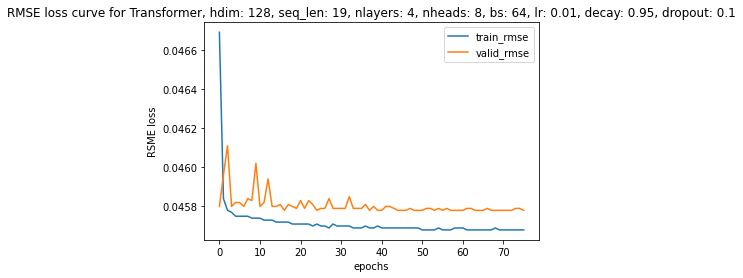

  6%|▌         | 155/2813 [00:18<05:35,  7.93it/s]


 11%|█         | 314/2813 [00:38<05:25,  7.68it/s]


 17%|█▋        | 481/2813 [00:57<04:05,  9.50it/s]


 23%|██▎       | 641/2813 [01:16<04:10,  8.68it/s]


 28%|██▊       | 797/2813 [01:34<03:59,  8.43it/s]


 34%|███▍      | 950/2813 [01:53<03:55,  7.90it/s]


 39%|███▉      | 1099/2813 [02:11<03:32,  8.08it/s]


 44%|████▍     | 1247/2813 [02:29<03:11,  8.17it/s]


 50%|████▉     | 1404/2813 [02:47<02:45,  8.54it/s]


 55%|█████▌    | 1558/2813 [03:06<02:16,  9.17it/s]


 61%|██████    | 1706/2813 [03:24<02:12,  8.37it/s]


 66%|██████▌   | 1858/2813 [03:42<02:01,  7.88it/s]


 71%|███████▏  | 2007/2813 [04:02<02:04,  6.47it/s]


 77%|███████▋  | 2155/2813 [04:21<01:30,  7.27it/s]


 82%|████████▏ | 2303/2813 [04:39<01:02,  8.16it/s]


 87%|████████▋ | 2453/2813 [04:58<00:46,  7.68it/s]


 92%|█████████▏| 2602/2813 [05:16<00:26,  8.07it/s]


 98%|█████████▊| 2751/2813 [05:35<00:07,  8.10it/s]


100%|██████████| 2813/2813 [05:43<00:00,  8.19it/s]


Epoch 77 | T: 6.24 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


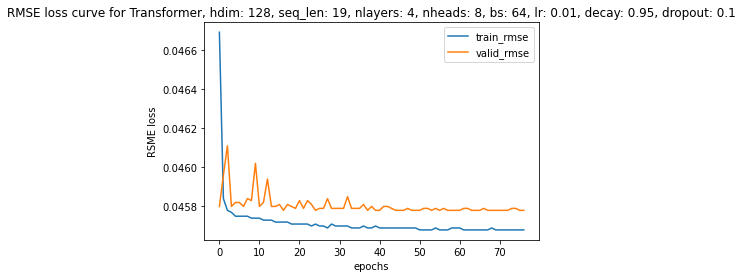

  6%|▌         | 158/2813 [00:18<05:29,  8.07it/s]


 11%|█         | 314/2813 [00:37<04:56,  8.43it/s]


 17%|█▋        | 467/2813 [00:55<04:31,  8.63it/s]


 22%|██▏       | 623/2813 [01:13<04:10,  8.75it/s]


 28%|██▊       | 793/2813 [01:33<03:33,  9.48it/s]


 34%|███▎      | 944/2813 [01:52<03:58,  7.82it/s]


 39%|███▉      | 1094/2813 [02:11<03:49,  7.49it/s]


 44%|████▍     | 1244/2813 [02:29<03:00,  8.68it/s]


 50%|████▉     | 1403/2813 [02:48<02:55,  8.04it/s]


 55%|█████▌    | 1552/2813 [03:06<02:31,  8.31it/s]


 60%|██████    | 1701/2813 [03:24<02:11,  8.45it/s]


 66%|██████▌   | 1849/2813 [03:43<02:02,  7.86it/s]


 71%|███████   | 2001/2813 [04:02<01:48,  7.50it/s]


 77%|███████▋  | 2152/2813 [04:21<01:23,  7.88it/s]


 82%|████████▏ | 2302/2813 [04:40<01:05,  7.86it/s]


 87%|████████▋ | 2450/2813 [04:59<00:43,  8.28it/s]


 92%|█████████▏| 2598/2813 [05:18<00:29,  7.29it/s]


 98%|█████████▊| 2746/2813 [05:36<00:08,  8.15it/s]


100%|██████████| 2813/2813 [05:45<00:00,  8.15it/s]


Epoch 78 | T: 6.31 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


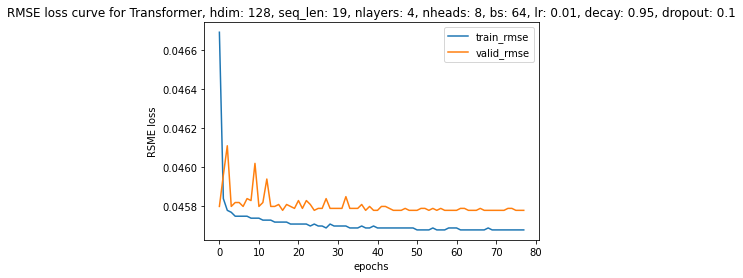

  6%|▌         | 155/2813 [00:18<04:29,  9.86it/s]


 12%|█▏        | 325/2813 [00:38<04:27,  9.30it/s]


 17%|█▋        | 488/2813 [00:56<04:31,  8.55it/s]


 24%|██▎       | 662/2813 [01:18<04:16,  8.39it/s]


 29%|██▉       | 814/2813 [01:36<04:16,  7.80it/s]


 34%|███▍      | 968/2813 [01:55<03:06,  9.91it/s]


 40%|███▉      | 1121/2813 [02:14<03:17,  8.56it/s]


 45%|████▌     | 1270/2813 [02:32<03:17,  7.82it/s]


 50%|█████     | 1419/2813 [02:50<02:40,  8.71it/s]


 56%|█████▋    | 1585/2813 [03:09<02:13,  9.20it/s]


 62%|██████▏   | 1734/2813 [03:26<02:14,  8.02it/s]


 67%|██████▋   | 1883/2813 [03:44<01:45,  8.78it/s]


 72%|███████▏  | 2032/2813 [04:02<01:37,  7.97it/s]


 78%|███████▊  | 2190/2813 [04:20<01:07,  9.19it/s]


 83%|████████▎ | 2338/2813 [04:38<01:01,  7.72it/s]


 88%|████████▊ | 2488/2813 [04:56<00:38,  8.44it/s]


 94%|█████████▎| 2636/2813 [05:14<00:22,  7.73it/s]


 99%|█████████▉| 2785/2813 [05:33<00:03,  7.53it/s]


100%|██████████| 2813/2813 [05:37<00:00,  8.34it/s]


Epoch 79 | T: 6.18 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


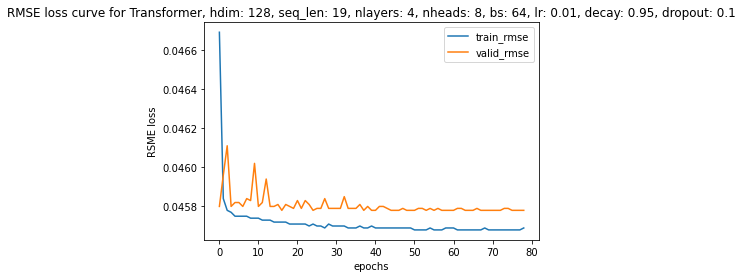

  6%|▌         | 161/2813 [00:18<05:34,  7.92it/s]


 11%|█▏        | 320/2813 [00:37<04:46,  8.70it/s]


 17%|█▋        | 477/2813 [00:57<04:46,  8.14it/s]


 23%|██▎       | 633/2813 [01:16<04:39,  7.80it/s]


 28%|██▊       | 786/2813 [01:33<03:54,  8.65it/s]


 33%|███▎      | 940/2813 [01:52<03:20,  9.34it/s]


 39%|███▉      | 1095/2813 [02:11<03:21,  8.52it/s]


 45%|████▍     | 1254/2813 [02:30<03:11,  8.15it/s]


 50%|████▉     | 1405/2813 [02:48<02:52,  8.18it/s]


 55%|█████▌    | 1558/2813 [03:06<02:30,  8.33it/s]


 61%|██████    | 1706/2813 [03:26<02:37,  7.02it/s]


 66%|██████▌   | 1859/2813 [03:44<01:58,  8.02it/s]


 71%|███████▏  | 2008/2813 [04:03<01:47,  7.52it/s]


 77%|███████▋  | 2158/2813 [04:22<01:18,  8.35it/s]


 82%|████████▏ | 2308/2813 [04:41<01:05,  7.73it/s]


 87%|████████▋ | 2460/2813 [05:00<00:53,  6.65it/s]


 93%|█████████▎| 2608/2813 [05:20<00:26,  7.69it/s]


 98%|█████████▊| 2756/2813 [05:41<00:07,  7.92it/s]


100%|██████████| 2813/2813 [05:48<00:00,  8.07it/s]


Epoch 80 | T: 6.36 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


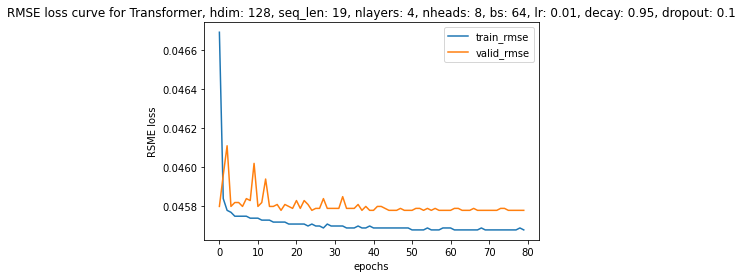

  6%|▌         | 159/2813 [00:19<05:08,  8.61it/s]


 11%|█         | 313/2813 [00:40<06:18,  6.60it/s]


 17%|█▋        | 466/2813 [00:59<04:10,  9.37it/s]


 22%|██▏       | 630/2813 [01:19<04:11,  8.68it/s]


 28%|██▊       | 781/2813 [01:37<03:38,  9.28it/s]


 33%|███▎      | 933/2813 [01:56<04:04,  7.69it/s]


 38%|███▊      | 1083/2813 [02:16<03:44,  7.70it/s]


 44%|████▍     | 1236/2813 [02:35<03:16,  8.02it/s]


 49%|████▉     | 1385/2813 [02:53<02:50,  8.36it/s]


 55%|█████▍    | 1536/2813 [03:11<02:39,  8.01it/s]


 60%|█████▉    | 1684/2813 [03:29<02:30,  7.49it/s]


 65%|██████▌   | 1833/2813 [03:48<02:04,  7.86it/s]


 70%|███████   | 1982/2813 [04:06<01:44,  7.96it/s]


 76%|███████▌  | 2130/2813 [04:25<01:30,  7.54it/s]


 81%|████████  | 2278/2813 [04:44<01:21,  6.60it/s]


 86%|████████▋ | 2428/2813 [05:03<00:52,  7.34it/s]


 92%|█████████▏| 2576/2813 [05:23<00:29,  8.03it/s]


 97%|█████████▋| 2724/2813 [05:42<00:10,  8.49it/s]


100%|██████████| 2813/2813 [05:53<00:00,  7.95it/s]


Epoch 81 | T: 6.45 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


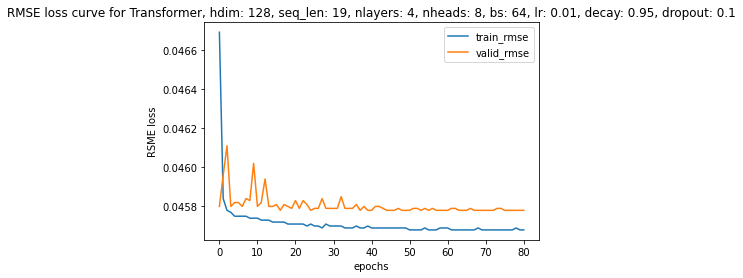

  6%|▌         | 158/2813 [00:19<05:48,  7.62it/s]


 11%|█▏        | 318/2813 [00:38<04:25,  9.40it/s]


 17%|█▋        | 469/2813 [00:56<05:25,  7.21it/s]


 22%|██▏       | 623/2813 [01:17<04:16,  8.55it/s]


 28%|██▊       | 774/2813 [01:35<04:05,  8.30it/s]


 33%|███▎      | 926/2813 [01:54<04:12,  7.46it/s]


 38%|███▊      | 1077/2813 [02:12<03:32,  8.18it/s]


 44%|████▎     | 1225/2813 [02:30<03:09,  8.37it/s]


 49%|████▉     | 1373/2813 [02:48<03:00,  7.98it/s]


 54%|█████▍    | 1521/2813 [03:06<02:36,  8.25it/s]


 59%|█████▉    | 1669/2813 [03:25<02:21,  8.06it/s]


 65%|██████▍   | 1817/2813 [03:42<01:58,  8.42it/s]


 70%|██████▉   | 1965/2813 [04:01<01:52,  7.51it/s]


 75%|███████▌  | 2114/2813 [04:20<01:25,  8.14it/s]


 80%|████████  | 2263/2813 [04:38<01:04,  8.52it/s]


 86%|████████▌ | 2412/2813 [04:56<00:47,  8.50it/s]


 91%|█████████ | 2560/2813 [05:14<00:29,  8.63it/s]


 96%|█████████▋| 2708/2813 [05:33<00:12,  8.20it/s]


100%|██████████| 2813/2813 [05:47<00:00,  8.10it/s]


Epoch 82 | T: 6.34 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


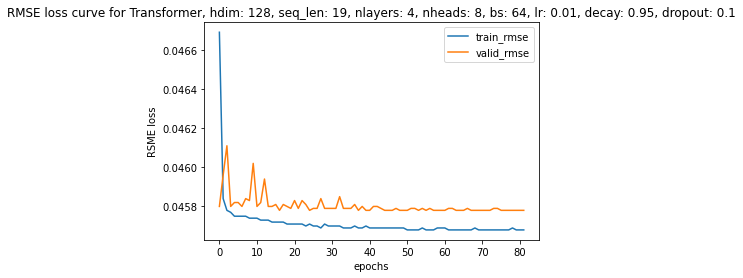

  5%|▌         | 153/2813 [00:18<05:45,  7.70it/s]


 11%|█         | 304/2813 [00:36<04:50,  8.64it/s]


 16%|█▌        | 456/2813 [00:57<05:08,  7.65it/s]


 22%|██▏       | 607/2813 [01:16<04:40,  7.86it/s]


 27%|██▋       | 758/2813 [01:34<04:07,  8.30it/s]


 33%|███▎      | 916/2813 [01:53<03:30,  9.01it/s]


 38%|███▊      | 1066/2813 [02:11<03:42,  7.86it/s]


 43%|████▎     | 1222/2813 [02:30<03:12,  8.28it/s]


 49%|████▊     | 1371/2813 [02:48<02:53,  8.30it/s]


 54%|█████▍    | 1526/2813 [03:07<02:52,  7.47it/s]


 60%|█████▉    | 1676/2813 [03:25<02:16,  8.30it/s]


 65%|██████▍   | 1824/2813 [03:43<02:33,  6.42it/s]


 70%|███████   | 1973/2813 [04:02<01:50,  7.61it/s]


 75%|███████▌  | 2121/2813 [04:21<01:41,  6.81it/s]


 81%|████████  | 2269/2813 [04:40<01:12,  7.47it/s]


 86%|████████▌ | 2418/2813 [04:58<00:53,  7.32it/s]


 91%|█████████▏| 2567/2813 [05:16<00:31,  7.81it/s]


 97%|█████████▋| 2715/2813 [05:35<00:11,  8.47it/s]


100%|██████████| 2813/2813 [05:49<00:00,  8.05it/s]


Epoch 83 | T: 6.36 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


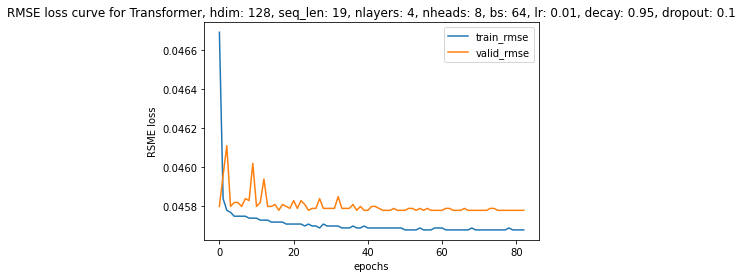

  6%|▌         | 163/2813 [00:19<04:47,  9.21it/s]


 11%|█         | 314/2813 [00:40<04:36,  9.04it/s]


 17%|█▋        | 473/2813 [00:59<04:52,  7.99it/s]


 22%|██▏       | 629/2813 [01:19<05:02,  7.21it/s]


 28%|██▊       | 784/2813 [01:39<03:44,  9.06it/s]


 33%|███▎      | 940/2813 [01:58<03:48,  8.19it/s]


 39%|███▉      | 1091/2813 [02:18<03:28,  8.25it/s]


 44%|████▍     | 1240/2813 [02:38<03:33,  7.38it/s]


 49%|████▉     | 1392/2813 [02:59<03:22,  7.00it/s]


 55%|█████▍    | 1540/2813 [03:20<03:06,  6.81it/s]


 60%|██████    | 1688/2813 [03:42<02:56,  6.39it/s]


 65%|██████▌   | 1836/2813 [04:03<02:04,  7.86it/s]


 71%|███████   | 1984/2813 [04:22<01:40,  8.28it/s]


 76%|███████▌  | 2132/2813 [04:43<01:48,  6.30it/s]


 81%|████████  | 2280/2813 [05:04<01:17,  6.85it/s]


 86%|████████▋ | 2428/2813 [05:23<01:01,  6.29it/s]


 92%|█████████▏| 2576/2813 [05:43<00:32,  7.38it/s]


 97%|█████████▋| 2724/2813 [06:03<00:12,  7.31it/s]


100%|██████████| 2813/2813 [06:15<00:00,  7.49it/s]


Epoch 84 | T: 6.85 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


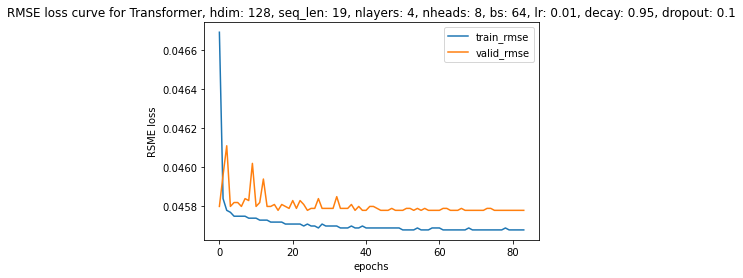

  6%|▌         | 160/2813 [00:19<05:47,  7.64it/s]


 11%|█▏        | 318/2813 [00:39<05:43,  7.26it/s]


 17%|█▋        | 470/2813 [01:01<05:49,  6.71it/s]


 22%|██▏       | 621/2813 [01:22<04:06,  8.89it/s]


 27%|██▋       | 773/2813 [01:43<05:11,  6.55it/s]


 33%|███▎      | 924/2813 [02:03<03:17,  9.55it/s]


 38%|███▊      | 1075/2813 [02:24<04:02,  7.17it/s]


 43%|████▎     | 1223/2813 [02:45<03:53,  6.81it/s]


 49%|████▊     | 1371/2813 [03:06<02:58,  8.06it/s]


 54%|█████▍    | 1519/2813 [03:26<03:00,  7.19it/s]


 59%|█████▉    | 1667/2813 [03:46<02:32,  7.53it/s]


 65%|██████▍   | 1815/2813 [04:05<01:54,  8.72it/s]


 70%|██████▉   | 1963/2813 [04:25<02:16,  6.22it/s]


 75%|███████▌  | 2111/2813 [04:44<01:43,  6.80it/s]


 80%|████████  | 2259/2813 [05:05<01:10,  7.86it/s]


 86%|████████▌ | 2407/2813 [05:25<01:04,  6.26it/s]


 91%|█████████ | 2555/2813 [05:47<00:38,  6.68it/s]


 96%|█████████▌| 2703/2813 [06:08<00:14,  7.53it/s]


100%|██████████| 2813/2813 [06:24<00:00,  7.32it/s]


Epoch 85 | T: 7.07 | Train RMSE: 0.04568 | Valid RMSE: 0.04579


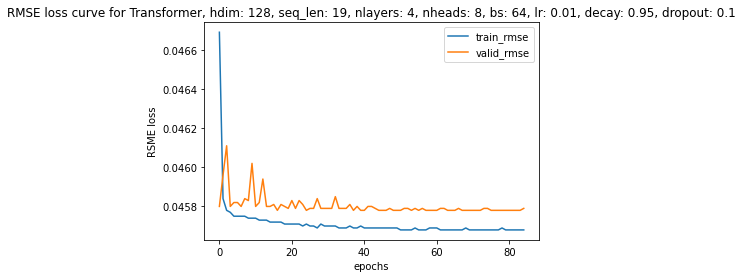

  5%|▌         | 152/2813 [00:18<05:03,  8.77it/s]


 11%|█         | 304/2813 [00:38<05:34,  7.51it/s]


 16%|█▋        | 459/2813 [00:58<05:33,  7.06it/s]


 22%|██▏       | 610/2813 [01:18<05:57,  6.16it/s]


 27%|██▋       | 762/2813 [01:39<05:12,  6.56it/s]


 32%|███▏      | 913/2813 [02:00<04:11,  7.55it/s]


 38%|███▊      | 1063/2813 [02:20<04:17,  6.80it/s]


 43%|████▎     | 1218/2813 [02:39<03:15,  8.17it/s]


 49%|████▊     | 1366/2813 [02:58<03:45,  6.43it/s]


 54%|█████▍    | 1514/2813 [03:17<02:42,  7.97it/s]


 59%|█████▉    | 1662/2813 [03:37<02:41,  7.13it/s]


 64%|██████▍   | 1810/2813 [03:57<02:25,  6.89it/s]


 70%|██████▉   | 1958/2813 [04:17<01:48,  7.86it/s]


 75%|███████▍  | 2106/2813 [04:36<01:23,  8.48it/s]


 80%|████████  | 2254/2813 [04:55<01:18,  7.13it/s]


 85%|████████▌ | 2402/2813 [05:15<00:54,  7.53it/s]


 91%|█████████ | 2550/2813 [05:35<00:38,  6.92it/s]


 96%|█████████▌| 2698/2813 [05:56<00:16,  6.80it/s]


100%|██████████| 2813/2813 [06:12<00:00,  7.54it/s]


Epoch 86 | T: 6.81 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


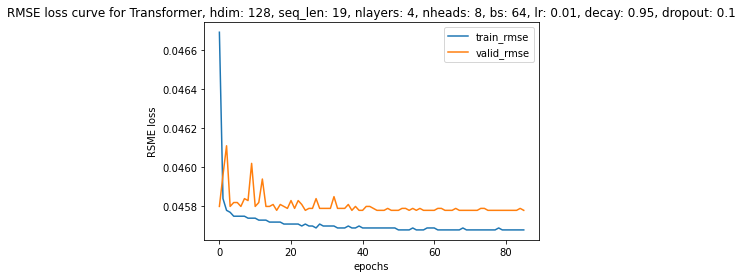

  6%|▌         | 155/2813 [00:18<04:58,  8.89it/s]


 11%|█         | 308/2813 [00:37<05:39,  7.37it/s]


 16%|█▋        | 459/2813 [00:58<05:04,  7.73it/s]


 22%|██▏       | 610/2813 [01:16<04:25,  8.30it/s]


 27%|██▋       | 761/2813 [01:35<04:11,  8.17it/s]


 32%|███▏      | 912/2813 [01:55<03:51,  8.22it/s]


 38%|███▊      | 1062/2813 [02:13<03:35,  8.14it/s]


 43%|████▎     | 1210/2813 [02:32<03:14,  8.22it/s]


 48%|████▊     | 1358/2813 [02:50<02:54,  8.36it/s]


 54%|█████▎    | 1506/2813 [03:09<02:45,  7.89it/s]


 59%|█████▉    | 1654/2813 [03:27<02:05,  9.23it/s]


 64%|██████▍   | 1803/2813 [03:45<01:44,  9.67it/s]


 69%|██████▉   | 1951/2813 [04:04<01:47,  7.99it/s]


 75%|███████▍  | 2099/2813 [04:23<01:27,  8.18it/s]


 80%|███████▉  | 2247/2813 [04:44<01:12,  7.79it/s]


 85%|████████▌ | 2395/2813 [05:03<00:56,  7.40it/s]


 90%|█████████ | 2543/2813 [05:23<00:34,  7.91it/s]


 96%|█████████▌| 2691/2813 [05:44<00:18,  6.44it/s]


100%|██████████| 2813/2813 [06:00<00:00,  7.79it/s]


Epoch 87 | T: 6.60 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


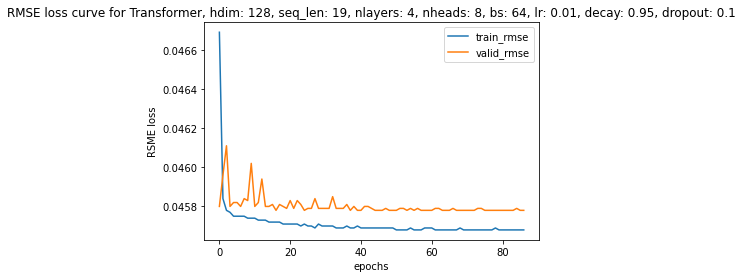

  6%|▌         | 156/2813 [00:19<06:02,  7.32it/s]


 11%|█         | 308/2813 [00:38<04:41,  8.88it/s]


 17%|█▋        | 466/2813 [00:57<04:09,  9.42it/s]


 22%|██▏       | 617/2813 [01:18<05:22,  6.82it/s]


 27%|██▋       | 769/2813 [01:36<04:07,  8.25it/s]


 33%|███▎      | 920/2813 [01:55<03:56,  8.00it/s]


 38%|███▊      | 1077/2813 [02:15<03:39,  7.92it/s]


 44%|████▎     | 1228/2813 [02:34<03:07,  8.46it/s]


 49%|████▉     | 1376/2813 [02:52<02:57,  8.10it/s]


 54%|█████▍    | 1526/2813 [03:11<02:41,  7.95it/s]


 60%|█████▉    | 1674/2813 [03:31<02:53,  6.57it/s]


 65%|██████▍   | 1823/2813 [03:49<02:15,  7.31it/s]


 70%|███████   | 1971/2813 [04:08<01:46,  7.93it/s]


 75%|███████▌  | 2120/2813 [04:28<01:37,  7.13it/s]


 81%|████████  | 2269/2813 [04:49<01:26,  6.26it/s]


 86%|████████▌ | 2417/2813 [05:09<00:45,  8.64it/s]


 91%|█████████ | 2565/2813 [05:28<00:31,  7.96it/s]


 96%|█████████▋| 2713/2813 [05:48<00:11,  8.58it/s]


100%|██████████| 2813/2813 [06:01<00:00,  7.79it/s]


Epoch 88 | T: 6.61 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


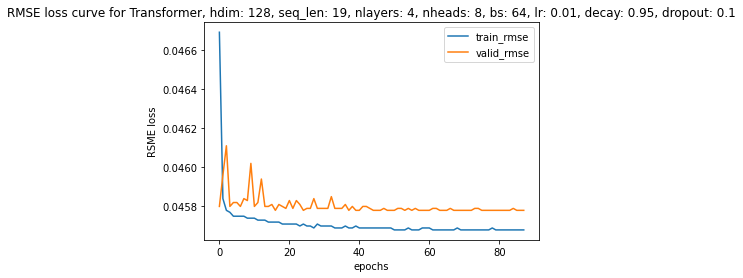

  6%|▌         | 158/2813 [00:18<05:48,  7.61it/s]


 11%|█         | 309/2813 [00:39<05:29,  7.61it/s]


 16%|█▋        | 460/2813 [00:59<04:51,  8.06it/s]


 22%|██▏       | 614/2813 [01:18<03:43,  9.86it/s]


 27%|██▋       | 767/2813 [01:37<03:59,  8.56it/s]


 33%|███▎      | 923/2813 [01:55<03:49,  8.23it/s]


 38%|███▊      | 1076/2813 [02:14<02:56,  9.82it/s]


 44%|████▎     | 1225/2813 [02:33<03:11,  8.29it/s]


 49%|████▉     | 1377/2813 [02:51<02:56,  8.14it/s]


 54%|█████▍    | 1529/2813 [03:10<02:39,  8.04it/s]


 60%|█████▉    | 1677/2813 [03:29<02:05,  9.05it/s]


 65%|██████▍   | 1828/2813 [03:47<01:55,  8.49it/s]


 67%|██████▋   | 1889/2813 [03:55<01:51,  8.25it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)


 25%|██▌       | 706/2813 [01:29<04:18,  8.16it/s]


 30%|███       | 857/2813 [01:48<03:59,  8.17it/s]


 36%|███▌      | 1008/2813 [02:07<03:42,  8.10it/s]


 41%|████      | 1156/2813 [02:26<03:53,  7.10it/s]


 46%|████▋     | 1304/2813 [02:44<03:03,  8.24it/s]


 52%|█████▏    | 1452/2813 [03:04<03:05,  7.35it/s]


 57%|█████▋    | 1602/2813 [03:23<02:30,  8.06it/s]


 62%|██████▏   | 1752/2813 [03:42<02:02,  8.65it/s]


 68%|██████▊   | 1902/2813 [04:02<01:53,  8.04it/s]


 73%|███████▎  | 2050/2813 [04:21<01:44,  7.29it/s]


 78%|███████▊  | 2198/2813 [04:41<01:19,  7.74it/s]


 83%|████████▎ | 2346/2813 [05:01<00:55,  8.38it/s]


 89%|████████▊ | 2494/2813 [05:21<00:36,  8.67it/s]


 94%|█████████▍| 2642/2813 [05:40<00:21,  7.94it/s]


 99%|█████████▉| 2790/2813 [05:59<00:02,  7.89it/s]


100%|██████████| 2813/2813 [06:03<00:00,  7.74it/s]


Epoch 90 | T: 6.64 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


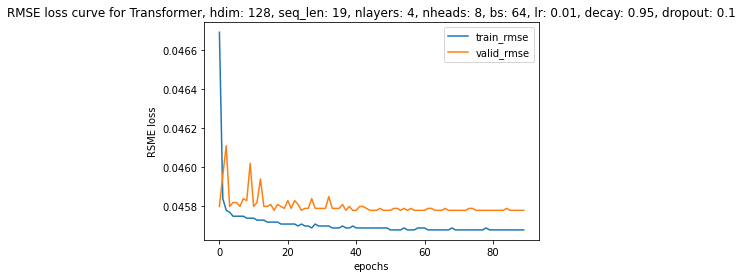

  5%|▌         | 152/2813 [00:18<05:48,  7.64it/s]


 11%|█         | 303/2813 [00:39<05:55,  7.07it/s]


 16%|█▋        | 461/2813 [00:58<05:00,  7.83it/s]


 22%|██▏       | 626/2813 [01:18<04:27,  8.18it/s]


 28%|██▊       | 779/2813 [01:37<04:31,  7.49it/s]


 33%|███▎      | 930/2813 [01:56<03:37,  8.67it/s]


 38%|███▊      | 1081/2813 [02:15<03:30,  8.21it/s]


 44%|████▎     | 1229/2813 [02:39<03:24,  7.74it/s]


 49%|████▉     | 1377/2813 [02:58<03:03,  7.81it/s]


 54%|█████▍    | 1525/2813 [03:18<02:36,  8.22it/s]


 59%|█████▉    | 1673/2813 [03:41<02:37,  7.26it/s]


 65%|██████▍   | 1821/2813 [04:02<02:05,  7.93it/s]


 70%|██████▉   | 1969/2813 [04:21<01:53,  7.45it/s]


 75%|███████▌  | 2117/2813 [04:40<01:33,  7.48it/s]


 81%|████████  | 2265/2813 [04:59<01:04,  8.56it/s]


 86%|████████▌ | 2413/2813 [05:18<00:51,  7.75it/s]


 91%|█████████ | 2561/2813 [05:38<00:34,  7.23it/s]


 96%|█████████▋| 2710/2813 [05:58<00:14,  7.01it/s]


100%|██████████| 2813/2813 [06:12<00:00,  7.56it/s]


Epoch 91 | T: 6.78 | Train RMSE: 0.04569 | Valid RMSE: 0.04578


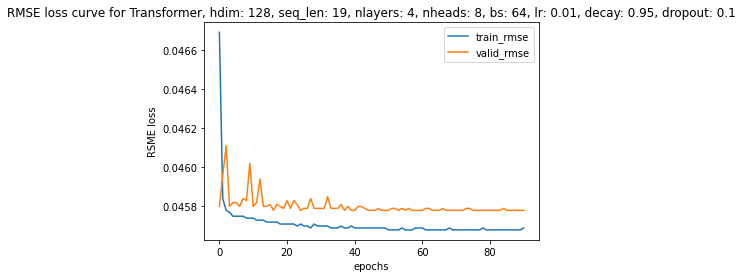

  6%|▌         | 163/2813 [00:19<05:22,  8.23it/s]


 11%|█         | 315/2813 [00:37<04:49,  8.63it/s]


 17%|█▋        | 466/2813 [00:58<05:01,  7.77it/s]


 22%|██▏       | 617/2813 [01:15<04:37,  7.91it/s]


 27%|██▋       | 768/2813 [01:34<04:46,  7.13it/s]


 33%|███▎      | 919/2813 [01:53<03:57,  7.98it/s]


 38%|███▊      | 1069/2813 [02:12<03:23,  8.56it/s]


 43%|████▎     | 1217/2813 [02:30<03:16,  8.12it/s]


 49%|████▊     | 1365/2813 [02:51<02:51,  8.44it/s]


 54%|█████▍    | 1513/2813 [03:09<02:22,  9.12it/s]


 59%|█████▉    | 1661/2813 [03:28<02:22,  8.10it/s]


 64%|██████▍   | 1811/2813 [03:47<02:06,  7.93it/s]


 70%|██████▉   | 1959/2813 [04:06<01:46,  8.03it/s]


 75%|███████▍  | 2107/2813 [04:26<01:24,  8.34it/s]


 80%|████████  | 2255/2813 [04:48<01:21,  6.89it/s]


 85%|████████▌ | 2403/2813 [05:09<00:58,  7.01it/s]


 91%|█████████ | 2551/2813 [05:29<00:34,  7.58it/s]


 96%|█████████▌| 2699/2813 [05:57<00:16,  6.86it/s]


100%|██████████| 2813/2813 [06:12<00:00,  7.56it/s]


Epoch 92 | T: 6.99 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


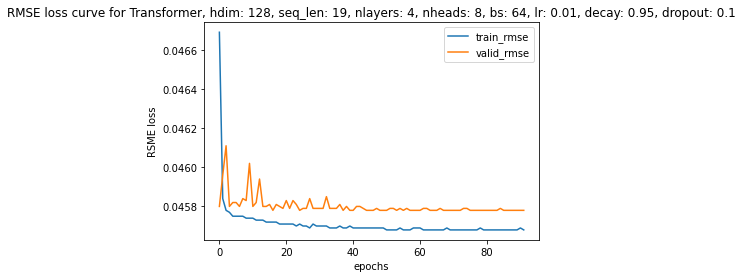

  5%|▌         | 153/2813 [00:19<05:40,  7.81it/s]


 11%|█         | 305/2813 [00:38<05:43,  7.31it/s]


 16%|█▌        | 456/2813 [01:09<04:58,  7.90it/s]


 22%|██▏       | 607/2813 [01:28<04:32,  8.11it/s]


 27%|██▋       | 758/2813 [01:56<04:51,  7.04it/s]


 32%|███▏      | 909/2813 [02:16<03:55,  8.09it/s]


 38%|███▊      | 1059/2813 [02:34<03:47,  7.70it/s]


 43%|████▎     | 1209/2813 [03:00<03:37,  7.36it/s]


 48%|████▊     | 1359/2813 [03:18<02:46,  8.74it/s]


 54%|█████▎    | 1507/2813 [03:38<02:28,  8.78it/s]


 59%|█████▉    | 1656/2813 [04:02<02:19,  8.30it/s]


 64%|██████▍   | 1804/2813 [04:21<01:57,  8.62it/s]


 69%|██████▉   | 1952/2813 [04:41<02:10,  6.59it/s]


 75%|███████▍  | 2100/2813 [05:01<01:41,  7.03it/s]


 80%|███████▉  | 2248/2813 [05:21<01:14,  7.54it/s]


 85%|████████▌ | 2396/2813 [05:41<01:04,  6.43it/s]


 90%|█████████ | 2544/2813 [06:01<00:38,  7.05it/s]


 96%|█████████▌| 2692/2813 [06:21<00:14,  8.11it/s]


100%|██████████| 2813/2813 [06:37<00:00,  7.07it/s]


Epoch 93 | T: 7.28 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


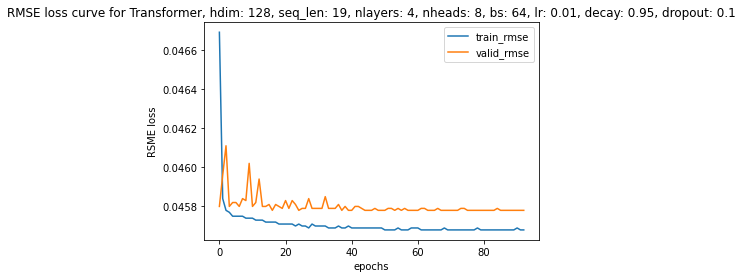

  5%|▌         | 152/2813 [00:18<05:09,  8.59it/s]


 11%|█         | 303/2813 [00:38<04:54,  8.52it/s]


 16%|█▌        | 454/2813 [00:57<05:16,  7.45it/s]


 22%|██▏       | 605/2813 [01:16<04:45,  7.74it/s]


 27%|██▋       | 756/2813 [01:35<04:15,  8.04it/s]


 32%|███▏      | 907/2813 [01:54<03:51,  8.22it/s]


 38%|███▊      | 1057/2813 [02:14<04:12,  6.95it/s]


 43%|████▎     | 1205/2813 [02:34<03:33,  7.55it/s]


 48%|████▊     | 1353/2813 [02:53<02:55,  8.31it/s]


 53%|█████▎    | 1501/2813 [03:12<02:59,  7.30it/s]


 59%|█████▊    | 1649/2813 [03:32<02:42,  7.16it/s]


 64%|██████▍   | 1797/2813 [03:52<02:18,  7.34it/s]


 69%|██████▉   | 1945/2813 [04:12<01:55,  7.53it/s]


 74%|███████▍  | 2093/2813 [04:31<01:37,  7.41it/s]


 80%|███████▉  | 2241/2813 [04:51<01:16,  7.47it/s]


 85%|████████▍ | 2389/2813 [05:11<01:02,  6.80it/s]


 90%|█████████ | 2537/2813 [05:31<00:37,  7.32it/s]


 95%|█████████▌| 2685/2813 [05:51<00:16,  7.65it/s]


100%|██████████| 2813/2813 [06:08<00:00,  7.63it/s]


Epoch 94 | T: 6.80 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


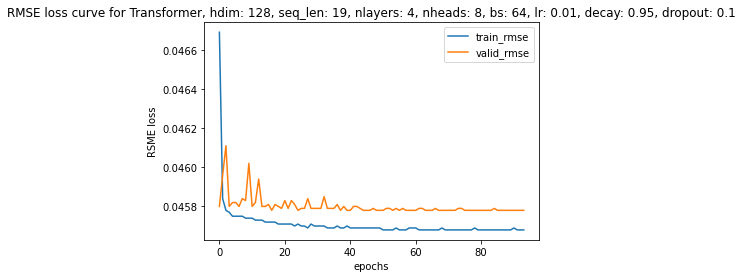

  5%|▌         | 152/2813 [00:20<06:00,  7.38it/s]


 11%|█         | 303/2813 [00:43<05:47,  7.23it/s]


 16%|█▌        | 454/2813 [01:03<06:10,  6.36it/s]


 22%|██▏       | 605/2813 [01:22<04:35,  8.01it/s]


 27%|██▋       | 756/2813 [01:43<04:46,  7.17it/s]


 32%|███▏      | 909/2813 [02:02<04:01,  7.87it/s]


 38%|███▊      | 1059/2813 [02:21<03:36,  8.10it/s]


 43%|████▎     | 1207/2813 [02:42<04:02,  6.62it/s]


 48%|████▊     | 1355/2813 [03:02<03:21,  7.24it/s]


 53%|█████▎    | 1503/2813 [03:21<02:40,  8.17it/s]


 59%|█████▊    | 1651/2813 [03:41<02:14,  8.64it/s]


 64%|██████▍   | 1799/2813 [04:02<02:06,  8.01it/s]


 69%|██████▉   | 1947/2813 [04:21<02:03,  7.01it/s]


 74%|███████▍  | 2095/2813 [04:42<01:36,  7.45it/s]


 80%|███████▉  | 2243/2813 [05:03<01:20,  7.09it/s]


 85%|████████▍ | 2391/2813 [05:23<01:06,  6.31it/s]


 90%|█████████ | 2539/2813 [05:44<00:35,  7.72it/s]


 96%|█████████▌| 2687/2813 [06:04<00:18,  6.87it/s]


100%|██████████| 2813/2813 [06:22<00:00,  7.35it/s]


Epoch 95 | T: 7.02 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


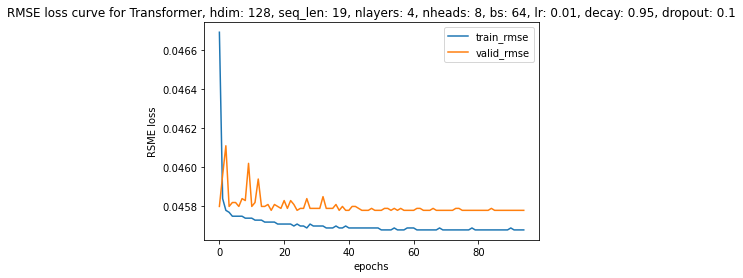

  5%|▌         | 151/2813 [00:20<06:54,  6.42it/s]


 11%|█         | 302/2813 [00:44<06:35,  6.35it/s]


 16%|█▌        | 454/2813 [01:04<05:15,  7.48it/s]


 22%|██▏       | 605/2813 [01:23<05:26,  6.77it/s]


 27%|██▋       | 757/2813 [01:43<03:41,  9.26it/s]


 32%|███▏      | 908/2813 [02:03<04:05,  7.75it/s]


 38%|███▊      | 1059/2813 [02:23<04:51,  6.01it/s]


 43%|████▎     | 1207/2813 [02:45<03:24,  7.84it/s]


 48%|████▊     | 1355/2813 [03:04<03:52,  6.28it/s]


 53%|█████▎    | 1503/2813 [03:25<02:46,  7.86it/s]


 59%|█████▊    | 1651/2813 [03:47<02:49,  6.85it/s]


 64%|██████▍   | 1799/2813 [04:08<02:24,  7.03it/s]


 69%|██████▉   | 1947/2813 [04:30<02:10,  6.62it/s]


 74%|███████▍  | 2095/2813 [04:52<01:41,  7.06it/s]


 80%|███████▉  | 2243/2813 [05:12<01:24,  6.78it/s]


 85%|████████▍ | 2391/2813 [05:32<00:49,  8.49it/s]


 90%|█████████ | 2539/2813 [06:01<00:39,  6.92it/s]


 96%|█████████▌| 2687/2813 [06:20<00:15,  8.07it/s]


100%|██████████| 2813/2813 [06:36<00:00,  7.09it/s]


Epoch 96 | T: 7.38 | Train RMSE: 0.04568 | Valid RMSE: 0.04578


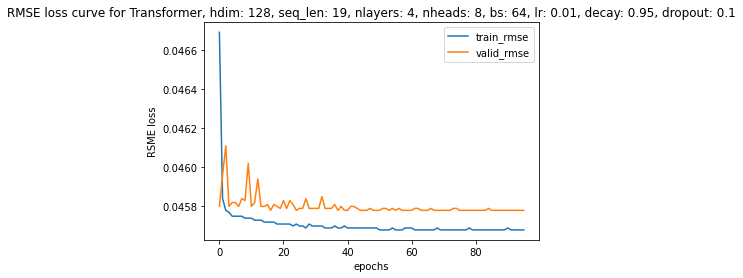

  5%|▌         | 151/2813 [00:27<06:01,  7.37it/s]


 11%|█         | 302/2813 [00:47<05:04,  8.24it/s]


 16%|█▌        | 453/2813 [01:07<04:48,  8.18it/s]


 22%|██▏       | 606/2813 [01:37<03:57,  9.31it/s]


 27%|██▋       | 761/2813 [01:56<03:54,  8.73it/s]


 32%|███▏      | 913/2813 [02:21<16:36,  1.91it/s]


 38%|███▊      | 1063/2813 [02:40<03:57,  7.37it/s]


 43%|████▎     | 1212/2813 [02:59<03:15,  8.18it/s]


 48%|████▊     | 1360/2813 [03:18<03:09,  7.68it/s]


 54%|█████▎    | 1508/2813 [03:37<02:53,  7.54it/s]


 59%|█████▉    | 1656/2813 [03:56<02:11,  8.79it/s]


 64%|██████▍   | 1804/2813 [04:16<02:03,  8.17it/s]


 96%|█████████▌| 96/100 [12:11:51<30:29, 457.41s/it]


KeyboardInterrupt: 

In [28]:
train_rmse = []
valid_rmse = []
min_rmse = 10e8

for i in tqdm(range(num_epoch)):
    start = time.time()

    # model.train() # if you use dropout or batchnorm. 
    train_rmse.append(train_epoch(train_loader, model, optimizer, loss_fun))

    # model.eval()
    val_rmse, val_preds, val_trues = eval_epoch(valid_loader, model, loss_fun)
    valid_rmse.append(val_rmse)

    # save the best model
    if valid_rmse[-1] < min_rmse:
        min_rmse = valid_rmse[-1] 
        best_model = model
        # torch.save([best_model, i, get_lr(optimizer)], name + ".pth")

    end = time.time()
    
    # Early Stopping
    if (len(train_rmse) > 100 and np.mean(valid_rmse[-5:]) >= np.mean(valid_rmse[-10:-5])):
            break       

    # Learning Rate Decay        
    scheduler.step()
    
    print("Epoch {} | T: {:0.2f} | Train RMSE: {:0.5f} | Valid RMSE: {:0.5f}".format(i + 1, (end-start) / 60, train_rmse[-1], valid_rmse[-1]))
    
    plt.figure()
    plt.plot(train_rmse, label="train_rmse")
    plt.plot(valid_rmse, label="valid_rmse")
    plt.xlabel('epochs')
    plt.ylabel('RSME loss')
    plt.title(f'RMSE loss curve for Transformer, hdim: {hidden_dim}, seq_len: {seq_len}, nlayers: {num_layers}, nheads: {num_heads}, bs: {batch_size}, lr: {learning_rate}, decay: {decay_rate}, dropout: {dropout}')
    plt.legend()
    plt.savefig(f'transformer_loss_curve_v1_hdim_{hidden_dim}_seqlen_{seq_len}_nheads_{num_heads}_bs_{batch_size}_lr_{learning_rate}_decay_{decay_rate}_dropout_{dropout}.png')
    plt.show()
    
torch.save(best_model.state_dict(), f'transformer_hdim_{hidden_dim}_seqlen_{seq_len}_nheads_{num_heads}_bs_{batch_size}_lr_{learning_rate}_decay_{decay_rate}_dropout_{dropout}.pt')

# Evaluation and Submission

In [ ]:
test_path = "./val_in/val_in/"
test_pkl_list = glob(os.path.join(test_path, '*'))
test_pkl_list.sort()

test_preds = []
for idx in range(len(test_pkl_list)):
    with open(test_pkl_list[idx], 'rb') as f:
        test_sample = pickle.load(f)
        pred_id = np.where(test_sample["track_id"] == test_sample['agent_id'])[0][0]
        inp_scene = np.dstack([test_sample['p_in'], test_sample['v_in']])

        # Normalization 
        min_vecs = np.min(inp_scene, axis = (0,1))
        max_vecs = np.max(inp_scene, axis = (0,1))
        
        inp = (inp_scene[pred_id] - min_vecs)/(max_vecs - min_vecs)
        
        inp = torch.from_numpy(inp).float().to(device).unsqueeze(0)

        preds = best_model(inp).cpu().data.numpy()
        
        # De-Normalization ! 
        preds = preds * (max_vecs[:2] - min_vecs[:2]) +  min_vecs[:2]
        test_preds.append(preds)

# Generate Submission File

In [17]:
# # Submission Files
# sample_sub = pd.read_csv('sample_submission.csv')

In [18]:
# Convert to int
predictions = np.concatenate(test_preds).reshape(len(test_preds), -1).astype(int)
sub_df = pd.DataFrame(np.c_[sample_sub["ID"], predictions], columns=[np.r_[["ID"], ["v" + str(i) for i in range(1, 61)]]])
sub_df.to_csv('test_submission.csv', index=None)

NameError: name 'sample_sub' is not defined